This file contains the training process of our Mask R-CNN segmentation model. We applied early stopping with a patience of 15 epochs, stopping training if there was no improvement in mAP@[50:95].

link to our dataset on roboflow:
https://universe.roboflow.com/segmentationcmmd/segmentation-calc-mass-aarac
original dataset:
https://www.cancerimagingarchive.net/analysis-result/tompei-cmmd/

In [ ]:
import torch
import torchvision
import torchvision.transforms as T
from torchvision.datasets import CocoDetection
import os
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
from torchvision.models.detection import MaskRCNN
from pycocotools import mask as maskUtils
from torch.utils.data import DataLoader
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval
import torch.optim as optim
from tqdm import tqdm
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.amp import GradScaler, autocast
from torchvision.models.detection.backbone_utils import BackboneWithFPN
from torchvision.ops.feature_pyramid_network import LastLevelMaxPool

In [2]:
dataset_root = "/kaggle/working/segmentation-calc-mass-12/"
ann_fileTr = os.path.join(dataset_root, "train/_annotations.coco.json")
ann_fileTe = os.path.join(dataset_root, "test/_annotations.coco.json")
ann_fileV = os.path.join(dataset_root, "valid/_annotations.coco.json")
img_folderTr = os.path.join(dataset_root, "train/")
img_folderTe = os.path.join(dataset_root, "test/")
img_folderV = os.path.join(dataset_root, "valid/")


In [ ]:
# COCO-format images and annotations.
#It prepares the data in the format expected by Mask R-CNN.
class CustomCocoDataset(CocoDetection):
    def __init__(self, img_folder, ann_file, transform=None):#Loads image folder and annotation file (in COCO format).
        super().__init__(img_folder, ann_file)
        self.transform = transform
        self.img_folder = img_folder

    def __getitem__(self, idx):#retrieves an image and its annotations by index.
        img, target = super().__getitem__(idx)
        img_info = self.coco.loadImgs(self.ids[idx])[0]
        img_path = os.path.join(self.img_folder, img_info["file_name"])
        img = Image.open(img_path).convert("RGB")
        image_id = self.ids[idx]  # Get the COCO image ID

        # Convert COCO annotations to Mask R-CNN format
        boxes = []
        masks = []
        labels = []

        for ann in target:
            xmin, ymin, w, h = ann["bbox"]
            xmax, ymax = xmin + w, ymin + h
            boxes.append([xmin, ymin, xmax, ymax])
            labels.append(ann["category_id"])

            # Handle segmentation masks
            if isinstance(ann["segmentation"], list):  # Polygon format
                mask = np.zeros((img.height, img.width), dtype=np.uint8)
                for seg in ann["segmentation"]:
                    poly = np.array(seg, dtype=np.int32).reshape((-1, 2))
                    cv2.fillPoly(mask, [poly], 1)
            else:  # RLE format :way to encode binary masks as a series of pixel runs.
                #How it works: It records alternating sequences of background and foreground pixels along the flattened array of the mask (row-wise).
                mask = maskUtils.decode(ann["segmentation"])
            masks.append(mask)

        # Convert to tensors
        if boxes:
            boxes = torch.as_tensor(np.array(boxes, dtype=np.float32), dtype=torch.float32)
            labels = torch.as_tensor(np.array(labels, dtype=np.int64), dtype=torch.int64)
            masks = torch.as_tensor(np.array(masks, dtype=np.uint8), dtype=torch.uint8)
        else:
            boxes = torch.zeros((0, 4), dtype=torch.float32)
            labels = torch.zeros((0,), dtype=torch.int64)
            masks = torch.zeros((0, img.height, img.width), dtype=torch.uint8)

        target_dict = {
            "boxes": boxes,
            "labels": labels,
            "masks": masks,
            "image_id": torch.tensor([image_id]),  # Add image_id as tensor
            "size": torch.tensor([img.height, img.width])  # Useful for evaluation
        }

        if self.transform:
            img = self.transform(img)

        return img, target_dict

# Define transformation
transform = T.Compose([T.ToTensor()])

# Load dataset
train_dataset = CustomCocoDataset(img_folderTr, ann_fileTr, transform=transform)
val_dataset = CustomCocoDataset(img_folderV, ann_fileV, transform=transform)
test_dataset = CustomCocoDataset(img_folderTe, ann_fileTe, transform=transform)

loading annotations into memory...
Done (t=0.31s)
creating index...
index created!
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


In [ ]:

train_loader = DataLoader(
    train_dataset,            
    batch_size=8,             
    shuffle=True,             
    collate_fn=lambda x: tuple(zip(*x)),  #  Combine (collate) batch items
    num_workers=4,             
    pin_memory=True,           #  Speed up transfer to GPU 
    persistent_workers=True    #  Keep workers alive across epochs (less overhead)
)

val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False, collate_fn=lambda x: tuple(zip(*x)),num_workers=4,
                        pin_memory=True, persistent_workers=True)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

In [ ]:
# 1. Load pretrained ConvNeXt Tiny
convnext = torchvision.models.convnext_tiny(weights='IMAGENET1K_V1')

# 2. Identify feature layers for FPN
return_layers = {
    '1': '0',  # First stage output (96 channels)
    '3': '1',  # Second stage output (192 channels)
    '5': '2',  # Third stage output (384 channels)
    '7': '3'   # Fourth stage output (768 channels)
}

# 3. Create feature extractor
body = torchvision.models._utils.IntermediateLayerGetter(
    convnext.features,
    return_layers=return_layers
)

# 4. Configure FPN parameters
in_channels_list = [96, 192, 384, 768]
out_channels = 256 

# 5. Build BackboneWithFPN
backbone_with_fpn = BackboneWithFPN(
    body,
    return_layers=return_layers,
    in_channels_list=in_channels_list,
    out_channels=out_channels,
    extra_blocks=LastLevelMaxPool()
)

# 6. Create Mask R‑CNN with custom backbone
num_classes = len(train_dataset.coco.cats) + 1
model = MaskRCNN(
    backbone=backbone_with_fpn,
    num_classes=num_classes,
    min_size=957,
    max_size=1147
)

# 7. (Optional) finetune all convnext layers
for param in model.backbone.body.parameters():
    param.requires_grad = True

# 8. Replace anchors with your k‑means results
model.rpn.anchor_generator.sizes = [
    67.5, 126.1, 191.9, 277.5, 407.9
]
model.rpn.anchor_generator.aspect_ratios = [
    (0.5,1.0,2.0),
] * len(model.rpn.anchor_generator.sizes)

# 9. Move to device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)


Downloading: "https://download.pytorch.org/models/convnext_tiny-983f1562.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny-983f1562.pth
100%|██████████| 109M/109M [00:00<00:00, 189MB/s]  


MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(957,), max_size=1147, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 96, kernel_size=(4, 4), stride=(4, 4))
        (1): LayerNorm2d((96,), eps=1e-06, elementwise_affine=True)
      )
      (1): Sequential(
        (0): CNBlock(
          (block): Sequential(
            (0): Conv2d(96, 96, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), groups=96)
            (1): Permute()
            (2): LayerNorm((96,), eps=1e-06, elementwise_affine=True)
            (3): Linear(in_features=96, out_features=384, bias=True)
            (4): GELU(approximate='none')
            (5): Linear(in_features=384, out_features=96, bias=True)
            (6): Permute()
          )
          (stochastic_depth): StochasticDepth(p=0.0, mode=row)
        )
        (1): C

In [ ]:
def evaluate_map(model, loader, device, typ='segm'):
    """
    Evaluate mAP using COCO evaluation metrics.

    Args:
        model: The detection model to evaluate
        val_loader: DataLoader for validation set
        device: Device to run evaluation on

    Returns:
        mAP@[0.5:0.95] as computed by COCO evaluation
    """
    model.eval()
    results = []
    coco_gt = loader.dataset.coco

    with torch.no_grad():
        for imgs, targets in loader:  # Use 'loader' instead of 'val_loader'
            imgs = [img.to(device) for img in imgs]

            # Enable AMP for forward pass To speed up training and reduce GPU memory usage. float16 instead of float32

            with autocast('cuda'):
                outputs = model(imgs)

            for output, target in zip(outputs, targets):
                image_id = target['image_id'].item()

                # Convert boxes from [x1,y1,x2,y2] to COCO [x,y,w,h] format
                boxes = output['boxes'].cpu().numpy()
                boxes[:, 2:] -= boxes[:, :2]

                # Process masks - must be done in full precision
                masks = (output['masks'].cpu().numpy() > 0.5).astype(np.uint8)
                scores = output['scores'].cpu().numpy()
                labels = output['labels'].cpu().numpy()

                for box, mask, score, label in zip(boxes, masks, scores, labels):
                    rle = maskUtils.encode(np.asfortranarray(mask[0]))
                    rle['counts'] = rle['counts'].decode('ascii')

                    results.append({
                        'image_id': image_id,
                        'category_id': label.item(),
                        'bbox': box.tolist(),
                        'score': score.item(),
                        'segmentation': rle
                    })

    # Ensure results are not empty (happens when no predictions for any images)
    if not results:
        print("No predictions found for any images!")
        return [0]  # Or handle differently based on your needs

    # Load results into COCOeval
    coco_dt = coco_gt.loadRes(results)

    # Run evaluation
    coco_eval = COCOeval(coco_gt, coco_dt, typ)
    coco_eval.evaluate()
    coco_eval.accumulate()
    coco_eval.summarize()

    return coco_eval.stats  # stats[0] is mAP@[0.5:0.95]

In [ ]:


optimizer = optim.AdamW(model.parameters(), lr=0.0001, weight_decay=1e-3)# Learning rate: how fast the model learns   weightdecay: Helps keep model weights small and smooth (helps prevent overfitting)
scheduler = ReduceLROnPlateau(optimizer, mode='max', factor=0.7, patience=3) # Reduce learning rate when validation loss plateaus


# Early stopping parameters
patience = 15  # Number of epochs to wait for improvement
best_map = float('-inf')  # Initialize best loss as infinity
epochs_without_improvement = 0  # Counter for epochs without improvement

num_epochs = 40

# Initialize the GradScaler for AMP
# Helps train safely with float16 precision  it scales up the loss temporarily  
# Faster training + lower memory usage 
scaler = GradScaler('cuda')

# Training loop
for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0
    progress_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}", leave=False)

    for imgs, targets in progress_bar:
        imgs = [img.to(device) for img in imgs]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets] #annotations

        optimizer.zero_grad()# Reset gradients before each batch

        # Forward pass with autocast for mixed precision
        with autocast('cuda'):
            loss_dict = model(imgs, targets)
            losses = sum(loss for loss in loss_dict.values())

        # Scale the loss and backpropagate
        scaler.scale(losses).backward()

        # Step the optimizer with scaled gradients
        scaler.step(optimizer) #applies the (unscaled) gradients.
        scaler.update()

        epoch_loss += losses.item() / len(imgs)
        progress_bar.set_postfix(loss=losses.item())  # Update tqdm with current loss

    # Adjust learning rate using the scheduler based on the validation loss
    map = evaluate_map(model, val_loader, device)[0]
    scheduler.step(map)

    # Print learning rate using get_last_lr()
    print(f"Epoch {epoch+1}, Loss: {epoch_loss:.4f}, Validation Map@50:95: {map:.4f}, Learning Rate: {scheduler.get_last_lr()[0]:.6f}")
    torch.save({
    'epoch': epoch,
    'optimizer_state_dict': optimizer.state_dict(),
    'scheduler_state_dict': scheduler.state_dict(),
    'scaler_state_dict': scaler.state_dict(),
     'last_model': model.state_dict(),
}, "/kaggle/working/last_optimizer_scheduler.pth")

    # Early stopping condition
    if map > best_map:
        best_map = map
        torch.save(model.state_dict(), "/kaggle/working/MaskRcnn_bestmap.pth")

        epochs_without_improvement = 0  # Reset counter if loss improves
    else:

        epochs_without_improvement += 1
        print(f"Early stopping counter:{epochs_without_improvement}")
    # If no improvement for `patience` epochs, stop training
    if epochs_without_improvement >= patience:
        print(f"Early stopping triggered at epoch {epoch+1}")
        break

print("Training complete!")


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.11s).
Accumulating evaluation results...
DONE (t=0.04s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.733
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.236
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.296
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.349
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.377
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.476
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.478
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.10s).
Accumulating evaluation results...
DONE (t=0.03s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.342
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.755
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.292
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.349
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.373
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.480
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.480
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.09s).
Accumulating evaluation results...
DONE (t=0.03s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.745
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.245
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.276
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.352
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.394
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.484
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.487
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.06s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.736
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.270
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.300
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.338
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.394
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.443
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.443
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.33s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.357
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.295
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.367
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.412
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.454
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.454
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.07s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.345
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.766
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.281
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.291
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.361
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.415
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.458
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.458
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.05s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.354
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.259
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.309
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.370
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.417
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.436
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.436
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.05s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.344
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.799
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.257
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.308
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.353
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.416
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.449
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.449
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.05s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.745
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.283
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.295
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.347
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.407
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.428
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.428
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.344
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.795
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.272
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.358
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.406
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.429
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.429
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.05s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.361
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.777
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.295
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.368
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.418
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.445
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.445
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.353
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.799
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.253
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.339
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.360
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.428
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.450
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.450
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.349
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.766
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.299
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.356
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.418
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.438
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.438
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.760
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.251
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.291
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.352
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.401
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.423
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.423
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.367
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.785
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.341
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.376
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.428
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.453
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.453
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.359
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.746
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.302
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.295
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.371
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.428
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.448
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.448
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.05s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.359
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.814
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.283
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.297
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.377
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.416
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.456
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.456
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.343
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.763
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.265
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.353
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.416
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.433
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.433
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.356
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.773
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.281
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.368
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.414
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.437
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.437
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.360
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.778
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.299
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.373
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.434
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.450
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.450
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.358
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.784
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.278
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.367
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.434
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.452
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.452
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.354
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.760
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.302
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.362
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.423
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.440
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.440
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.355
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.749
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.363
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.426
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.447
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.447
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.368
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.793
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.381
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.435
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.450
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.450
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.355
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.751
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.305
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.368
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.427
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.438
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.438
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.354
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.769
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.292
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.364
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.430
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.442
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.442
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.352
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.739
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.360
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.419
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.435
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.435
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

KeyboardInterrupt: 

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2

# Define your custom classes
CUSTOM_CLASSES = ['calc','mass']

# Load model and dataset
model.eval()

for img, target in test_dataset :

      # Move to device and add batch dimension
      img = img.to(device).unsqueeze(0)

      with torch.no_grad():
          predictions = model(img)

      # Convert image back to CPU and proper format for display
      image_np = img.squeeze(0).cpu().permute(1, 2, 0).numpy()

      # Denormalize if needed
      if image_np.max() <= 1:
          image_np = (image_np * 255).astype(np.uint8)

      # Create copies for ground truth and predictions
      gt_image = image_np.copy()
      pred_image = image_np.copy()

      # Draw ground truth boxes, masks, and labels
      gt_boxes = target['boxes'].cpu().numpy()
      gt_labels = target['labels'].cpu().numpy()
      gt_masks = target['masks'].cpu().numpy() if 'masks' in target else None

      for i, (box, label) in enumerate(zip(gt_boxes, gt_labels)):
          xmin, ymin, xmax, ymax = box.astype(int)
          xmin = max(0, xmin)
          ymin = max(0, ymin)
          xmax = min(gt_image.shape[1], xmax)
          ymax = min(gt_image.shape[0], ymax)

          # Draw bounding box
          cv2.rectangle(gt_image, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)

          # Add class label
          class_name = CUSTOM_CLASSES[label - 1]  # Adjust if labels start from 0
          cv2.putText(gt_image, class_name, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

          # Draw segmentation mask (if available)
          if gt_masks is not None:
              mask = gt_masks[i].squeeze()  # Remove channel dimension
              colored_mask = np.zeros_like(gt_image)
              colored_mask[:, :] = (0, 255, 0)  # Green color for ground truth masks
              # Apply mask overlay using NumPy
              gt_image = np.where(mask[..., None] > 0,
                                cv2.addWeighted(gt_image, 1, colored_mask, 0.3, 0),
                                gt_image)

      # Draw predicted boxes, masks, and labels
      confidence_threshold = 0.5
      pred_boxes = predictions[0]['boxes'][predictions[0]['scores'] > confidence_threshold].cpu().numpy()
      pred_labels = predictions[0]['labels'][predictions[0]['scores'] > confidence_threshold].cpu().numpy()
      pred_masks = predictions[0]['masks'][predictions[0]['scores'] > confidence_threshold].cpu().numpy()

      for i, (box, label) in enumerate(zip(pred_boxes, pred_labels)):
          xmin, ymin, xmax, ymax = box.astype(int)
          xmin = max(0, xmin)
          ymin = max(0, ymin)
          xmax = min(pred_image.shape[1], xmax)
          ymax = min(pred_image.shape[0], ymax)

          # Draw bounding box
          cv2.rectangle(pred_image, (xmin, ymin), (xmax, ymax), (255, 0, 0), 2)

          # Add class label and confidence score
          class_name = CUSTOM_CLASSES[label - 1]  # Adjust if labels start from 0
          score = predictions[0]['scores'][i].item()
          label_text = f"{class_name} {score:.2f}"
          cv2.putText(pred_image, label_text, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

          # Draw segmentation mask
          mask = pred_masks[i].squeeze()  # Remove channel dimension
          mask = (mask > 0.5).astype(np.uint8)  # Binarize the mask

          # Overlay mask with transparency
          colored_mask = np.zeros_like(pred_image)
          colored_mask[:, :] = (255, 0, 0)  # Blue color for predicted masks
          pred_image = np.where(mask[..., None] > 0,
                              cv2.addWeighted(pred_image, 1, colored_mask, 0.3, 0),
                              pred_image)

          # Draw mask edges
          contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
          cv2.drawContours(pred_image, contours, -1, (0, 255, 255), 2)  # Yellow edges

      # Convert back to RGB for matplotlib display
      gt_image = cv2.cvtColor(gt_image, cv2.COLOR_BGR2RGB)
      pred_image = cv2.cvtColor(pred_image, cv2.COLOR_BGR2RGB)

      # Combine images side by side
      combined_image = np.hstack((gt_image, pred_image))

      # Show result
      plt.figure(figsize=(16, 8))
      plt.imshow(combined_image)
      plt.axis('off')
      plt.title("Ground Truth (Left) vs Predictions (Right)", fontsize=16)
      plt.show()


calc: No ground truth instances
mass: Avg IoU = 0.903 (1/1 matched)

Overall IoU: 0.903 (1 instances)


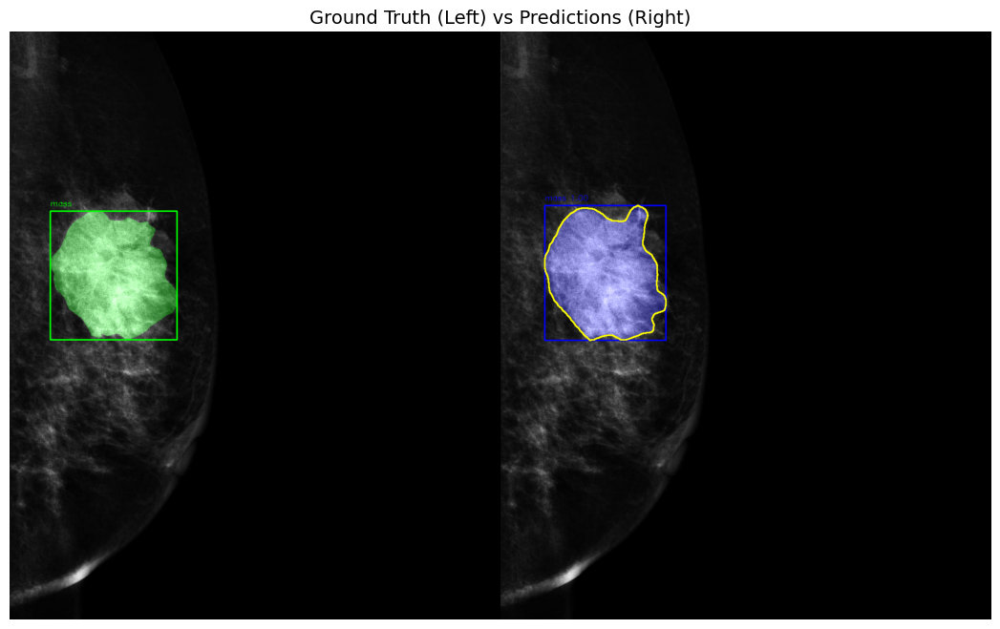


calc: No ground truth instances
mass: Avg IoU = 0.840 (1/1 matched)

Overall IoU: 0.840 (1 instances)


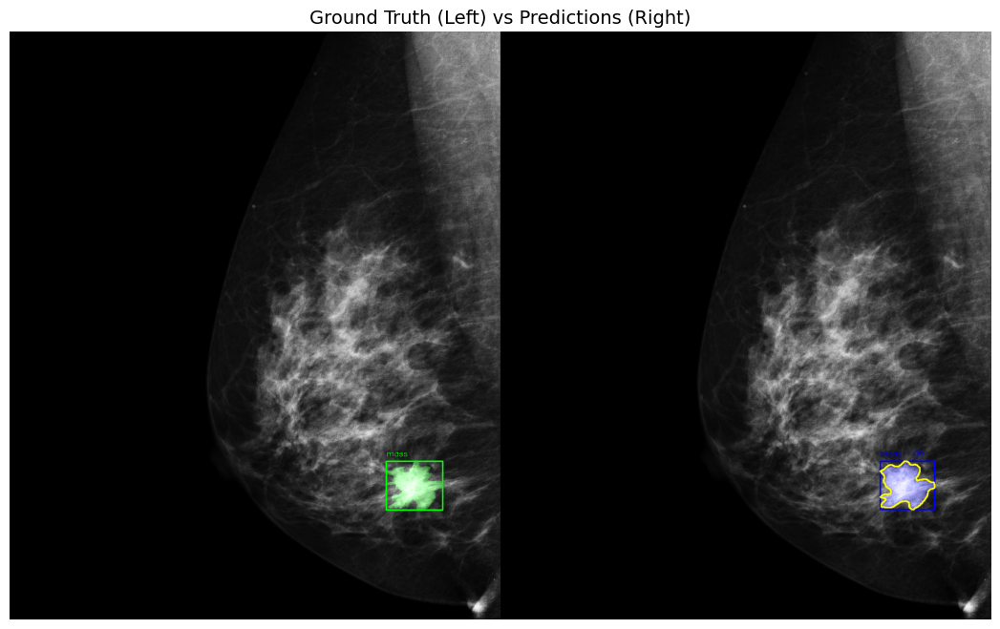


No ground truth masks available


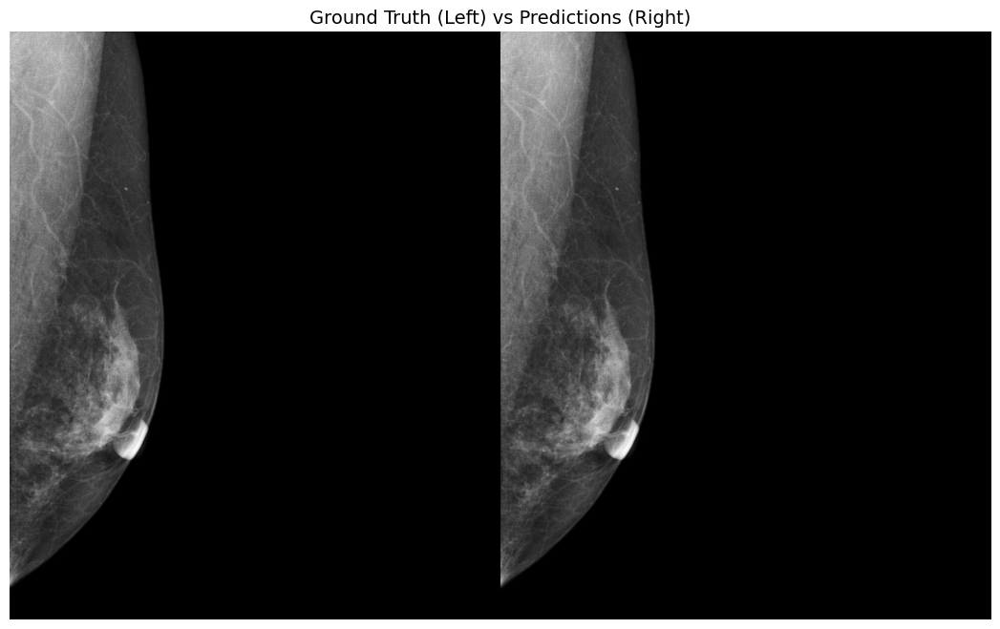


calc: No ground truth instances
mass: Avg IoU = 0.859 (1/1 matched)

Overall IoU: 0.859 (1 instances)


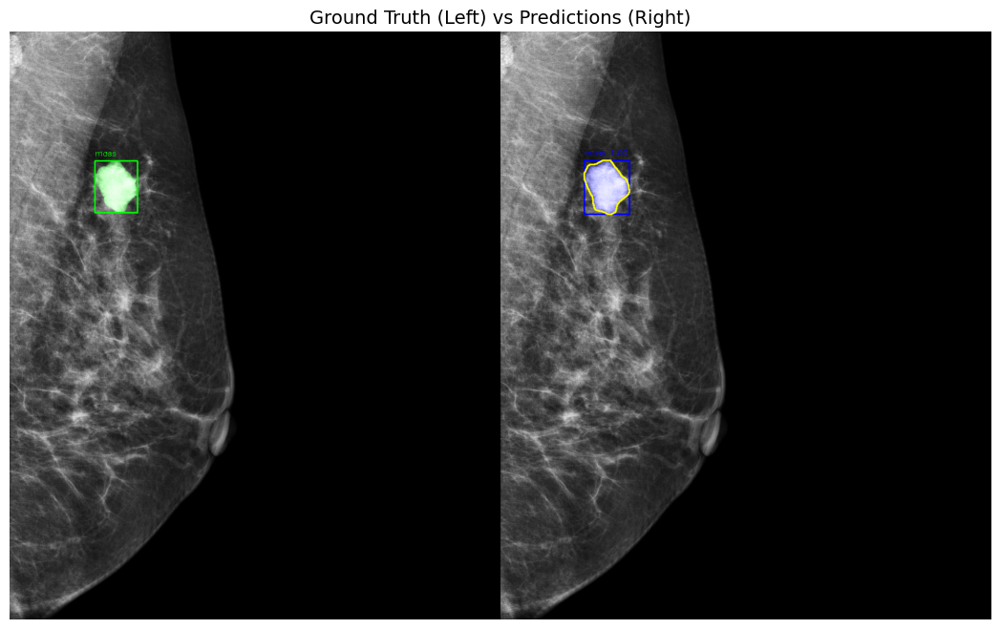


calc: No ground truth instances
mass: Avg IoU = 0.811 (1/1 matched)

Overall IoU: 0.811 (1 instances)


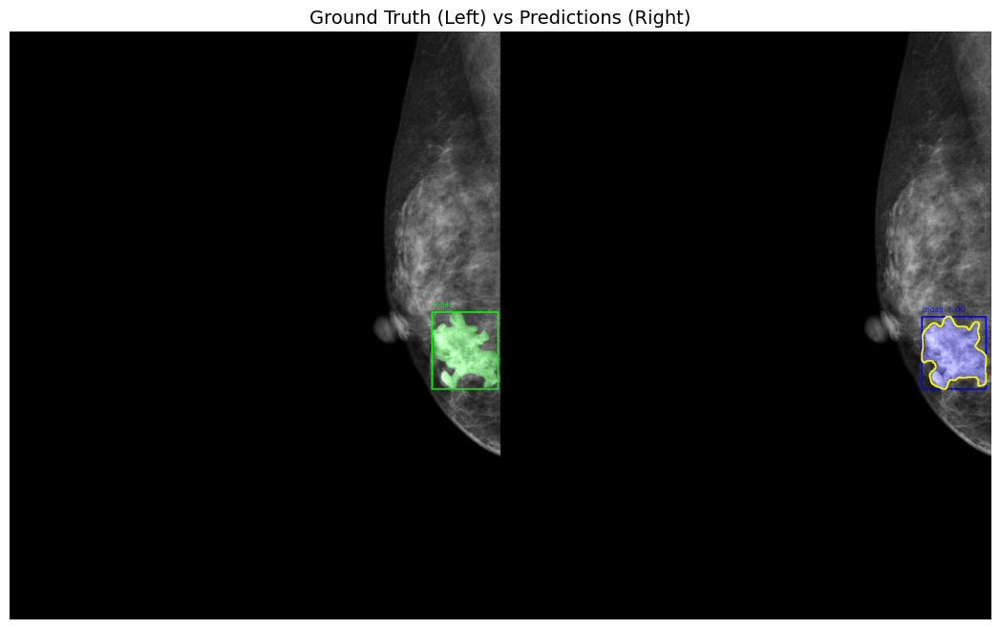


calc: No ground truth instances
mass: Avg IoU = 0.773 (1/1 matched)

Overall IoU: 0.773 (1 instances)


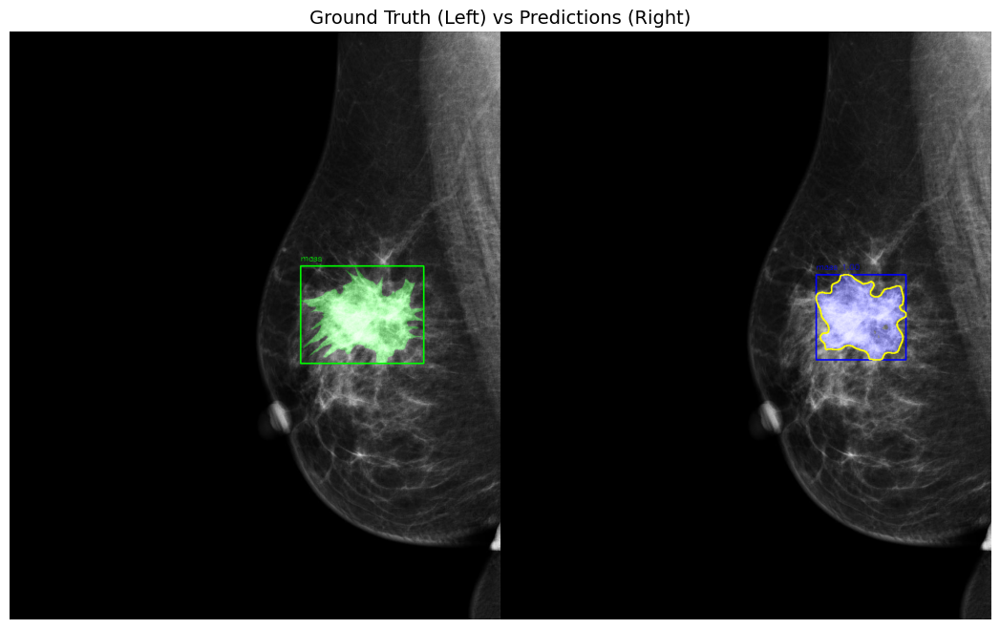


calc: No ground truth instances
mass: Avg IoU = 0.865 (1/1 matched)

Overall IoU: 0.865 (1 instances)


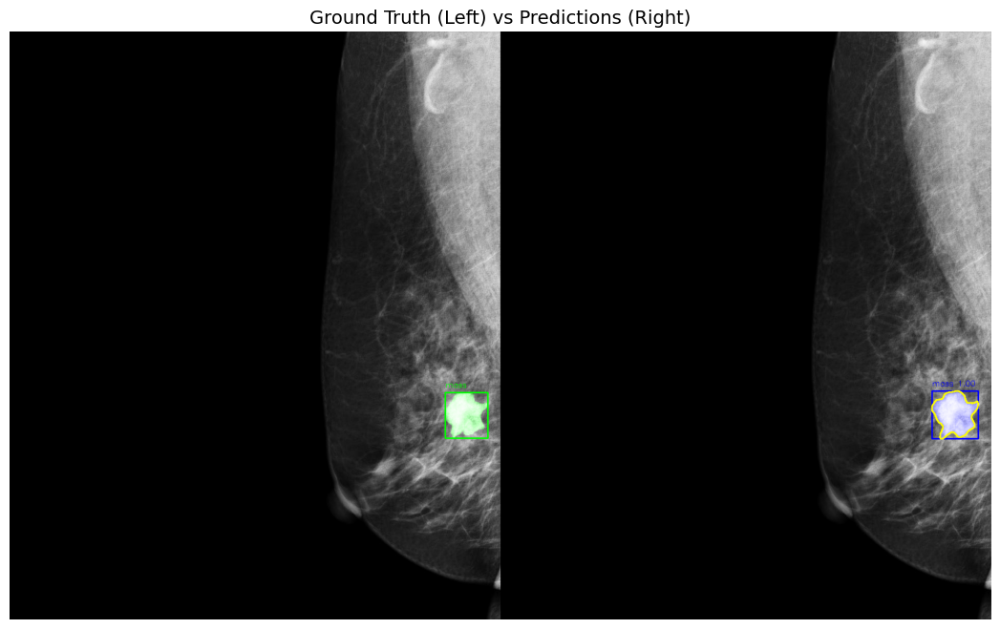


calc: No ground truth instances
mass: Avg IoU = 0.757 (1/1 matched)

Overall IoU: 0.757 (1 instances)


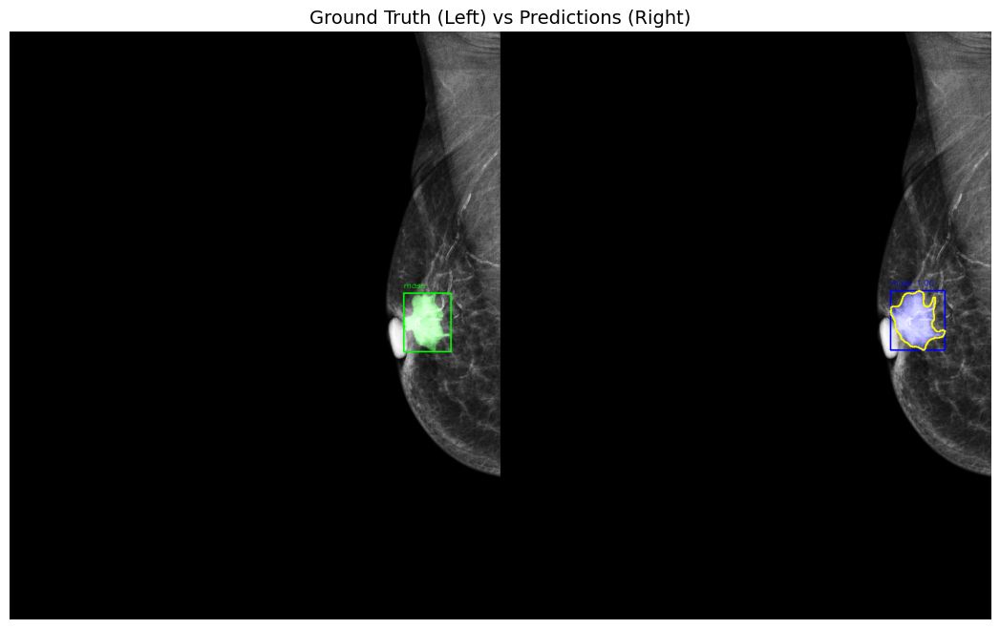


calc: No ground truth instances
mass: Avg IoU = 0.473 (1/1 matched)

Overall IoU: 0.473 (1 instances)


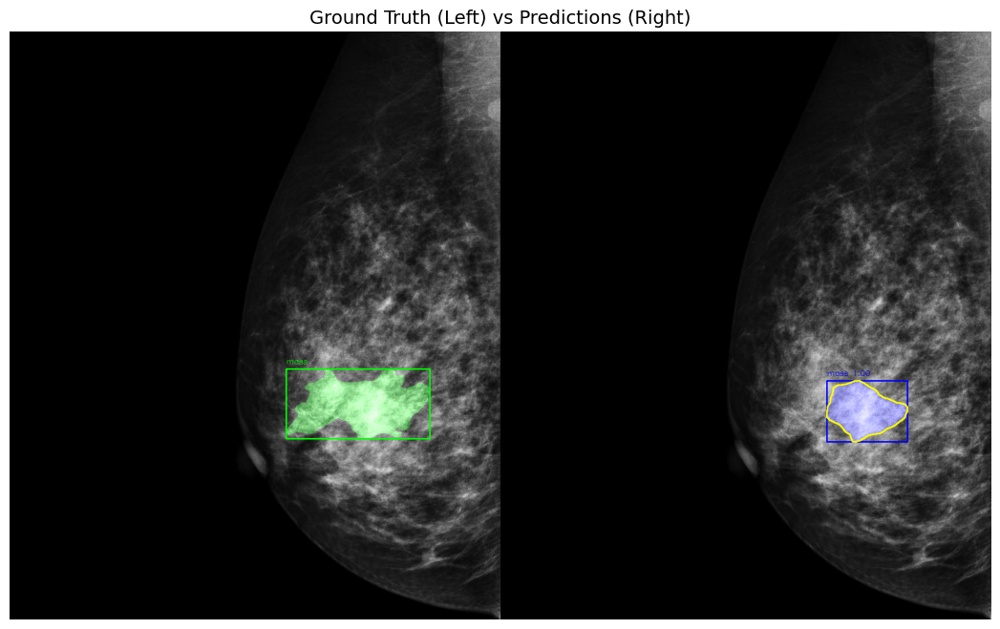


calc: No ground truth instances
mass: Avg IoU = 0.840 (1/1 matched)

Overall IoU: 0.840 (1 instances)


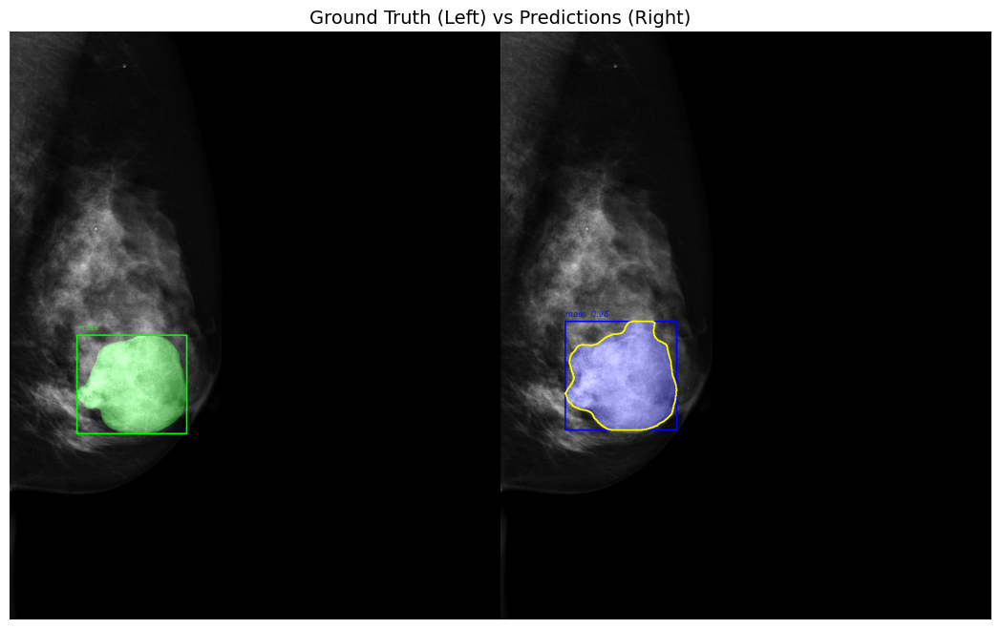


calc: No ground truth instances
mass: Avg IoU = 0.688 (1/1 matched)

Overall IoU: 0.688 (1 instances)


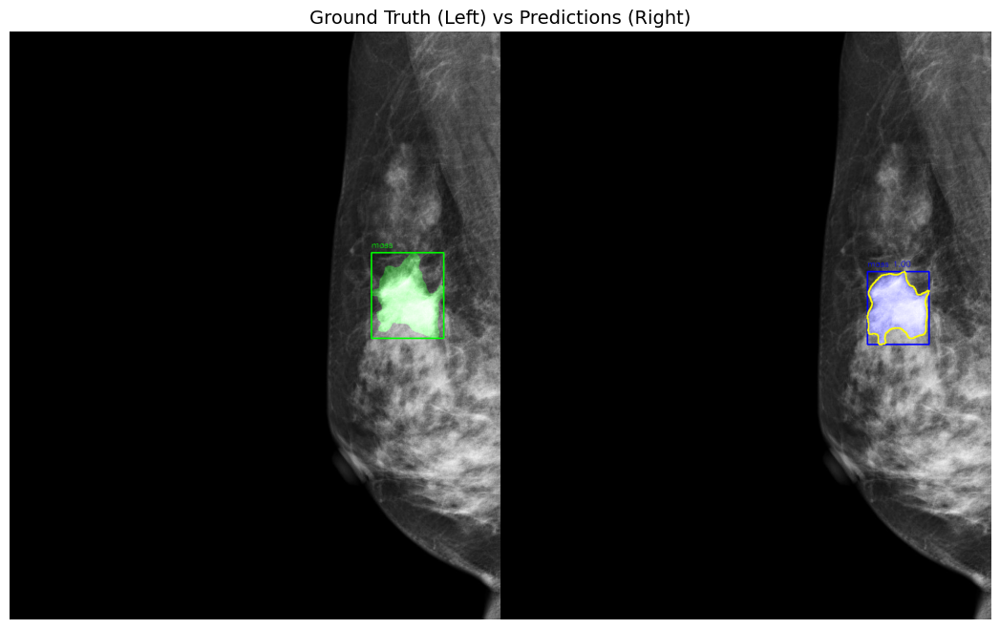


No ground truth masks available


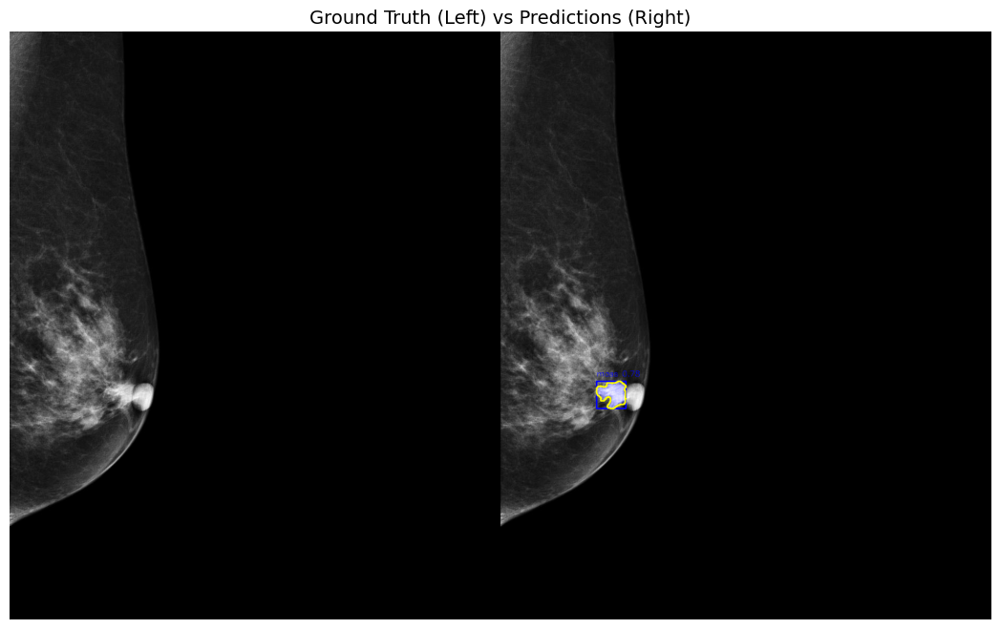


calc: No ground truth instances
mass: Avg IoU = 0.760 (1/1 matched)

Overall IoU: 0.760 (1 instances)


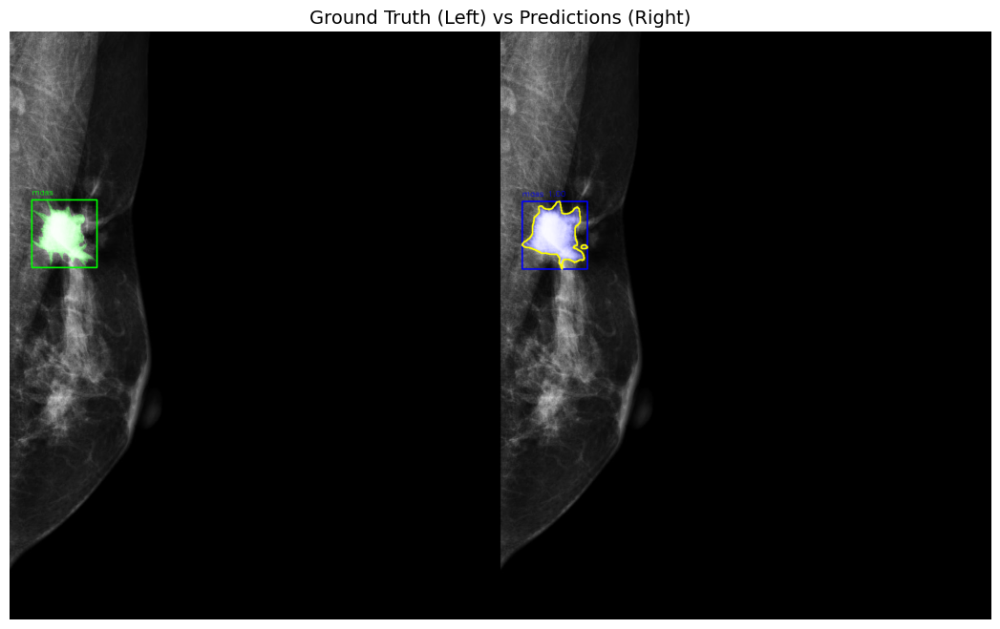


No ground truth masks available


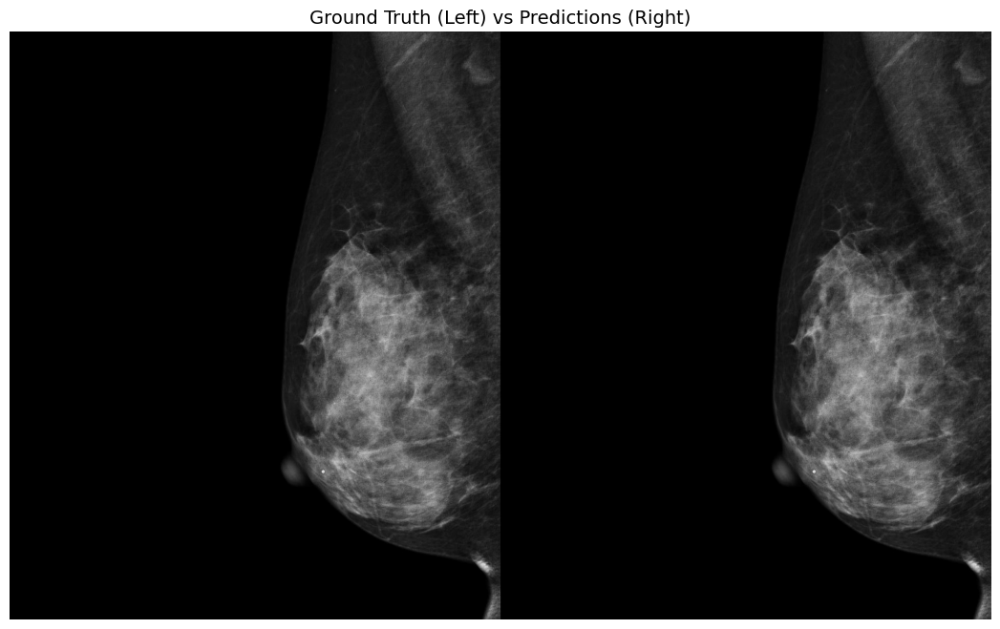


calc: Avg IoU = 0.845 (1/1 matched)
mass: Avg IoU = 0.000 (0/1 matched)

Overall IoU: 0.422 (2 instances)


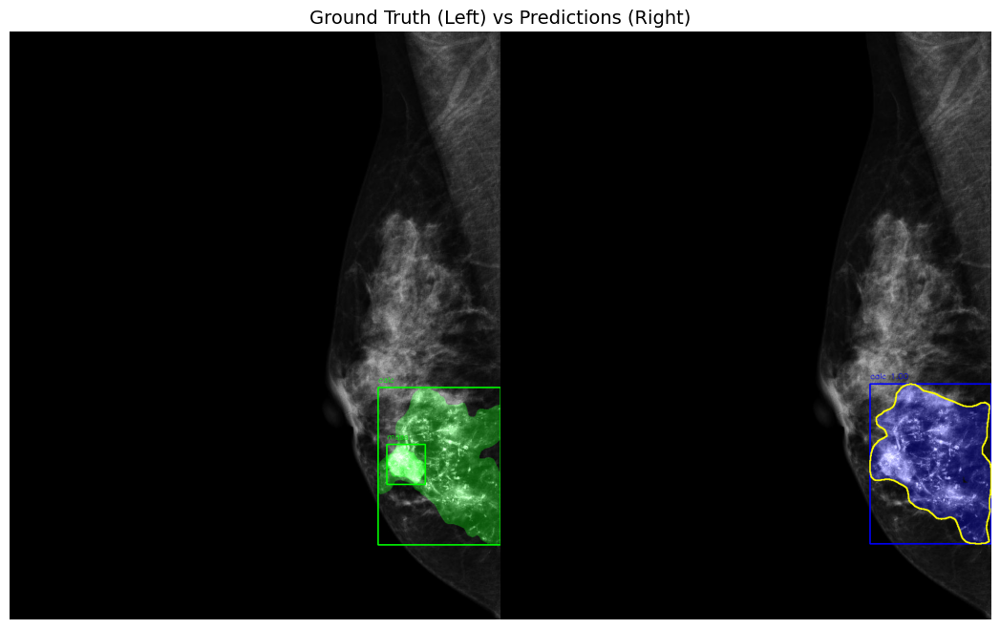


No ground truth masks available


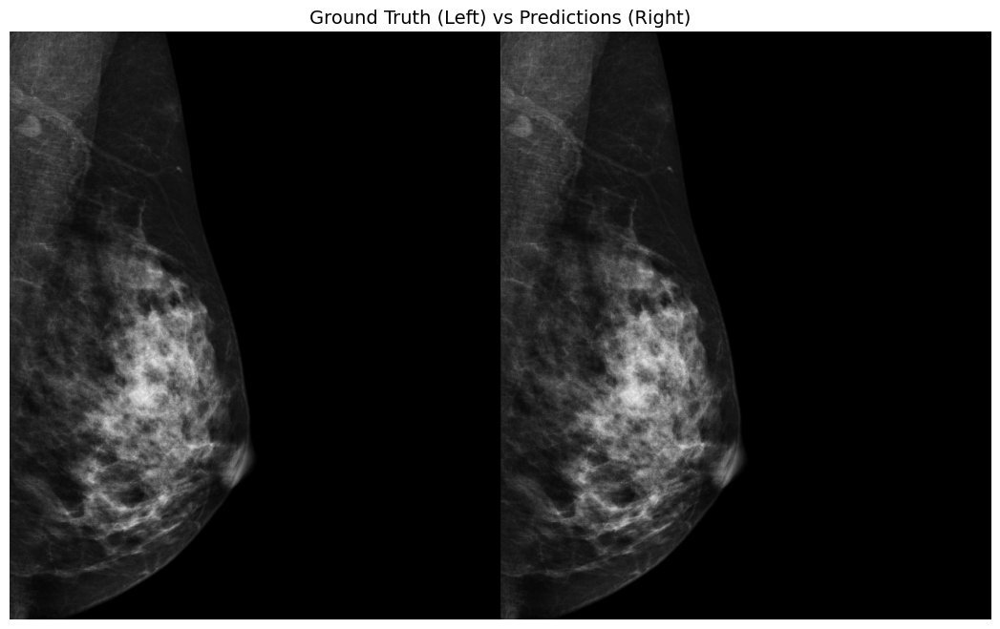


calc: Avg IoU = 0.165 (1/3 matched)
mass: No ground truth instances

Overall IoU: 0.165 (3 instances)


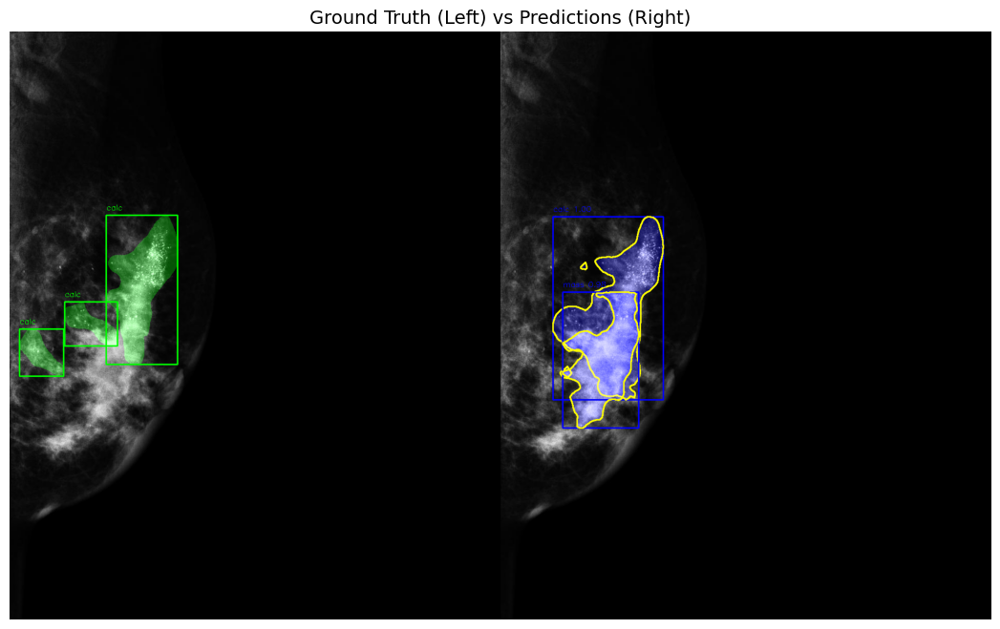


calc: No ground truth instances
mass: Avg IoU = 0.851 (1/1 matched)

Overall IoU: 0.851 (1 instances)


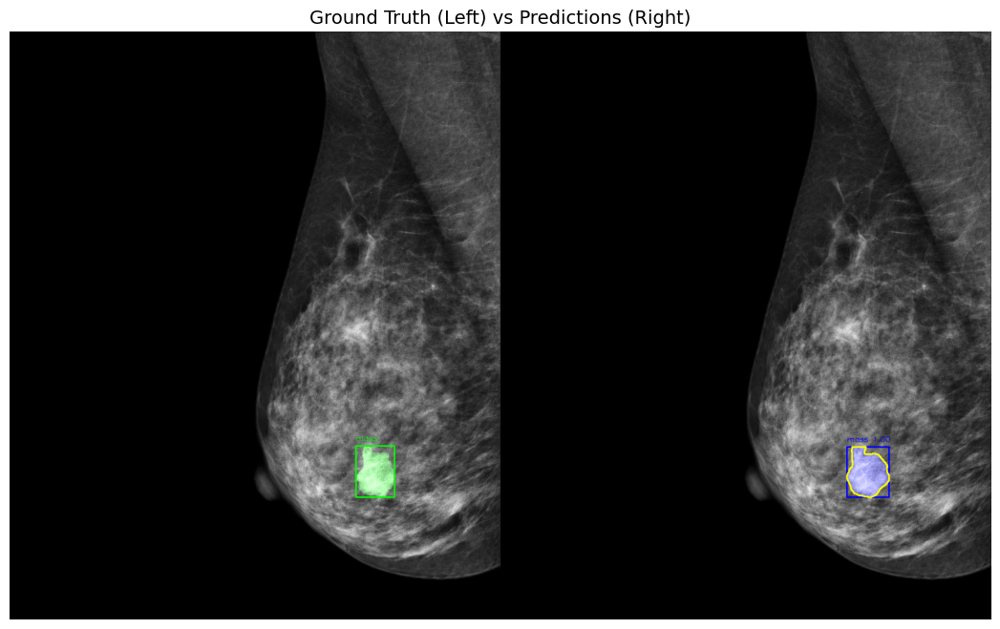


No ground truth masks available


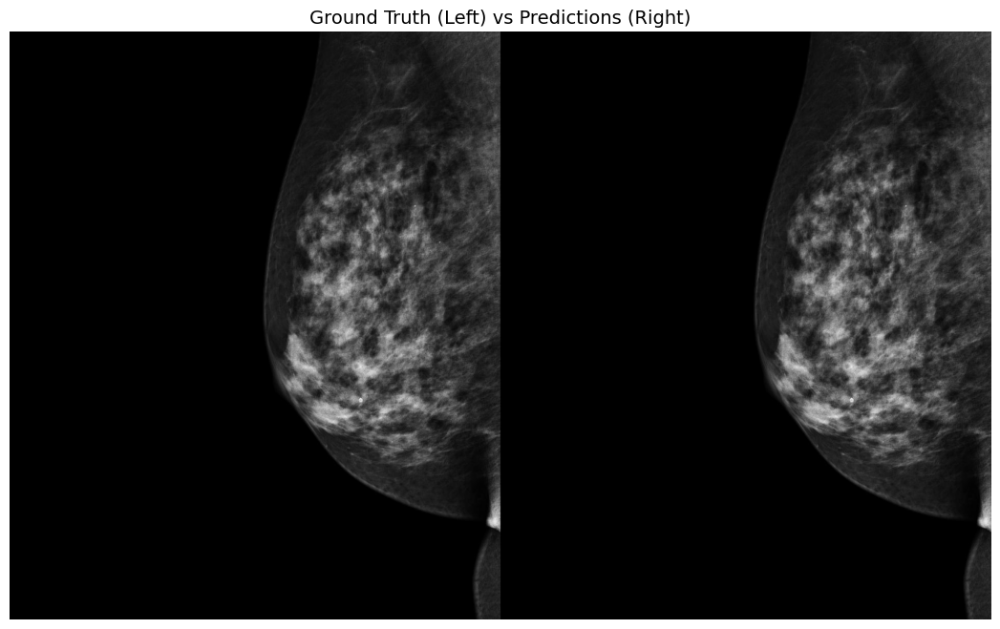


calc: Avg IoU = 0.360 (1/2 matched)
mass: No ground truth instances

Overall IoU: 0.360 (2 instances)


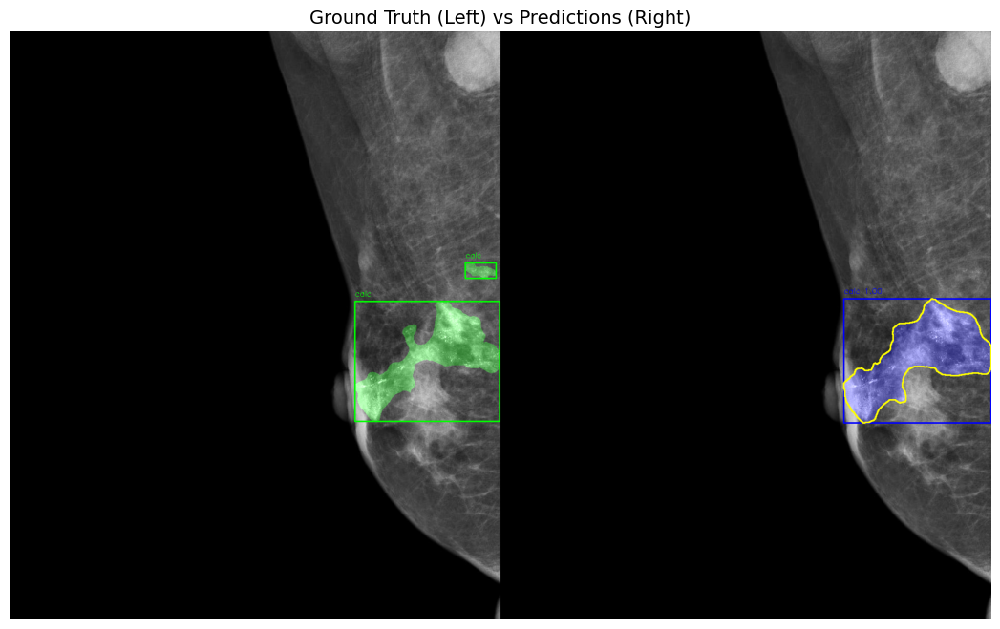


calc: No ground truth instances
mass: Avg IoU = 0.884 (1/1 matched)

Overall IoU: 0.884 (1 instances)


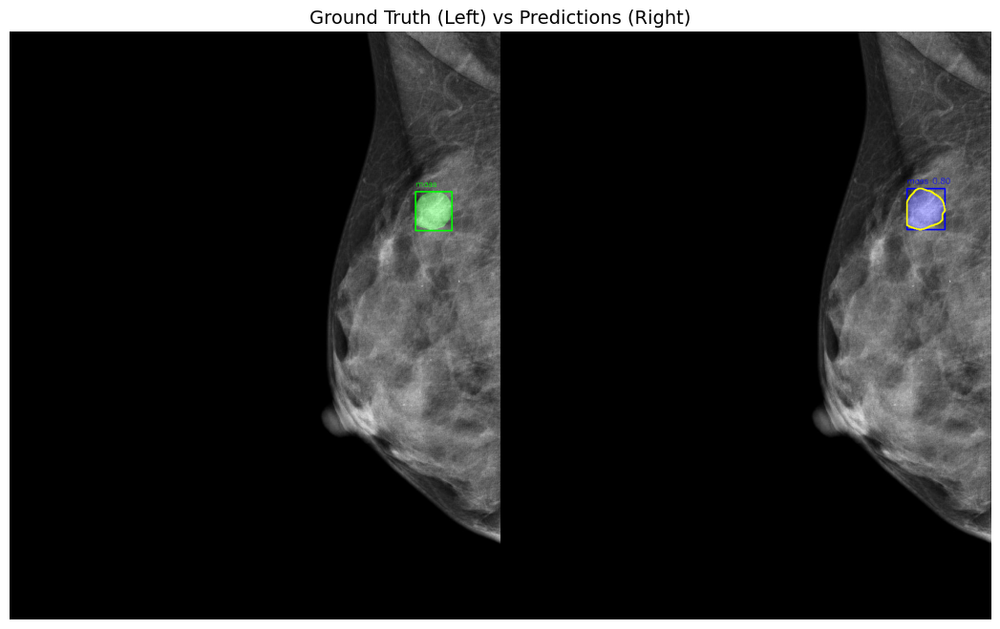


No ground truth masks available


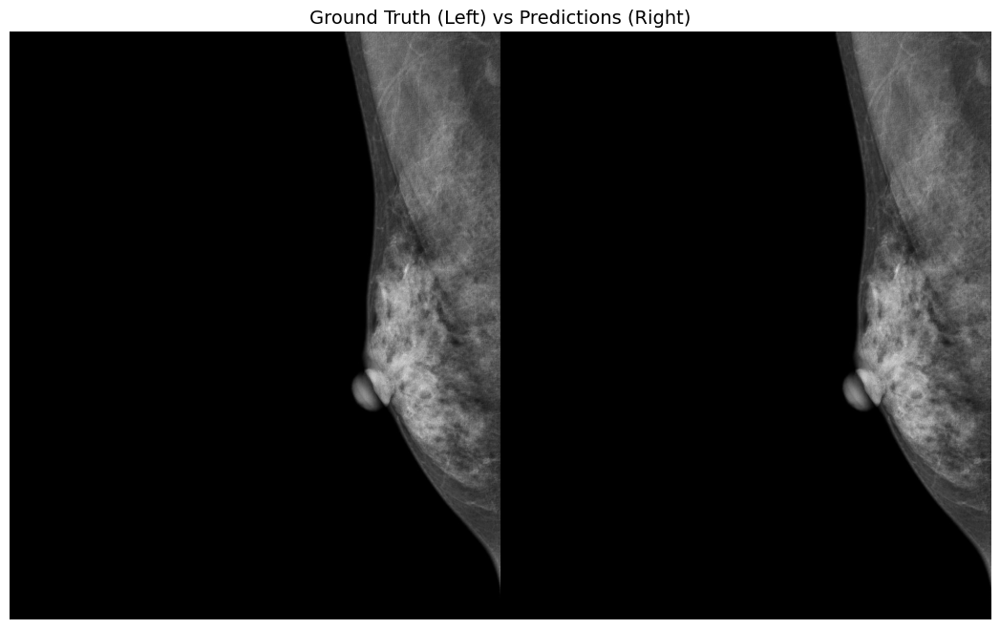


calc: Avg IoU = 0.312 (1/1 matched)
mass: Avg IoU = 0.300 (1/1 matched)

Overall IoU: 0.306 (2 instances)


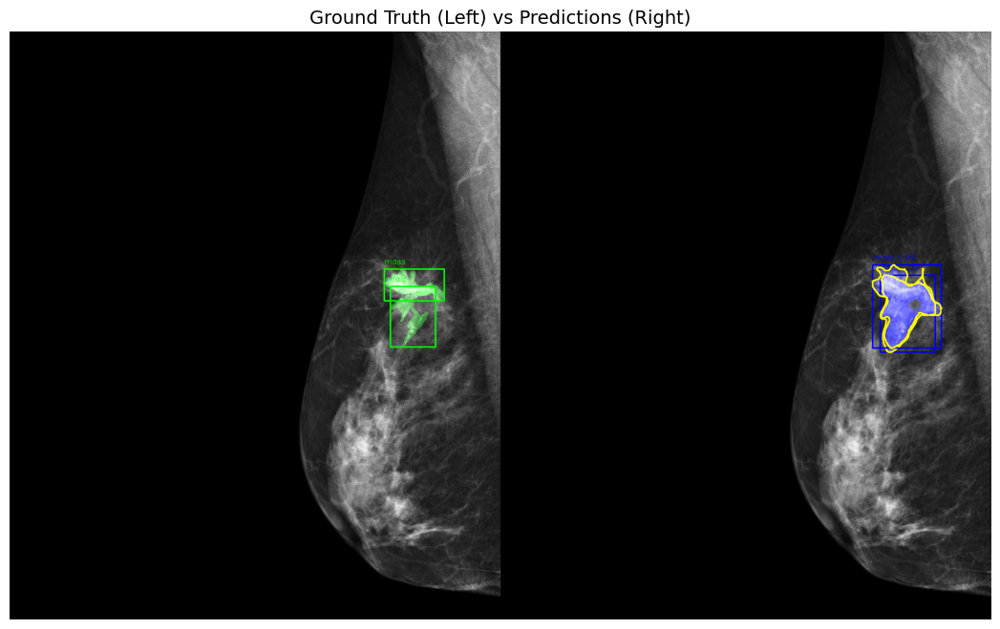


calc: No ground truth instances
mass: Avg IoU = 0.419 (1/1 matched)

Overall IoU: 0.419 (1 instances)


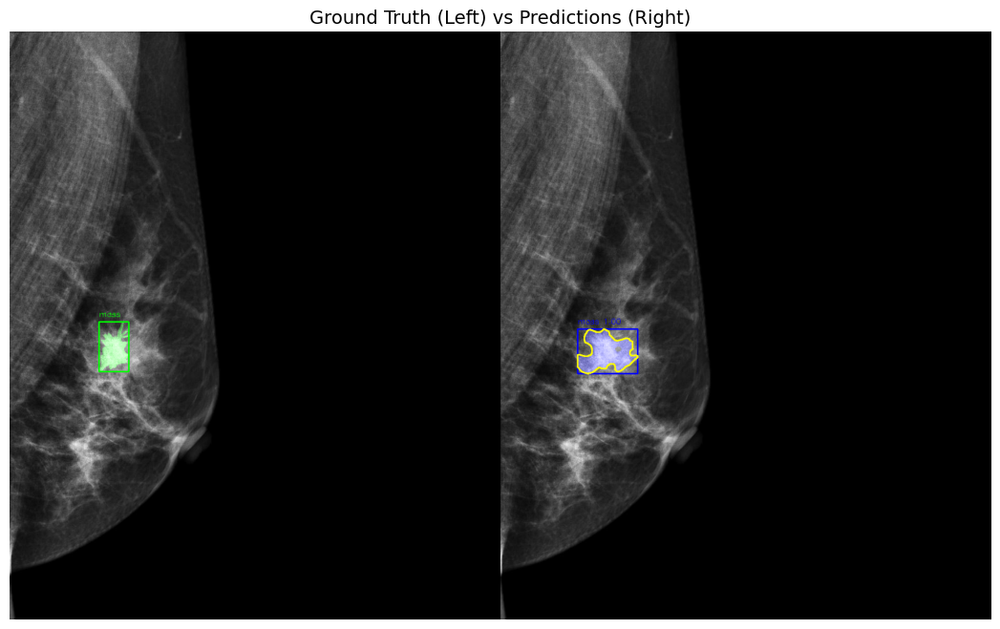


calc: Avg IoU = 0.489 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.489 (1 instances)


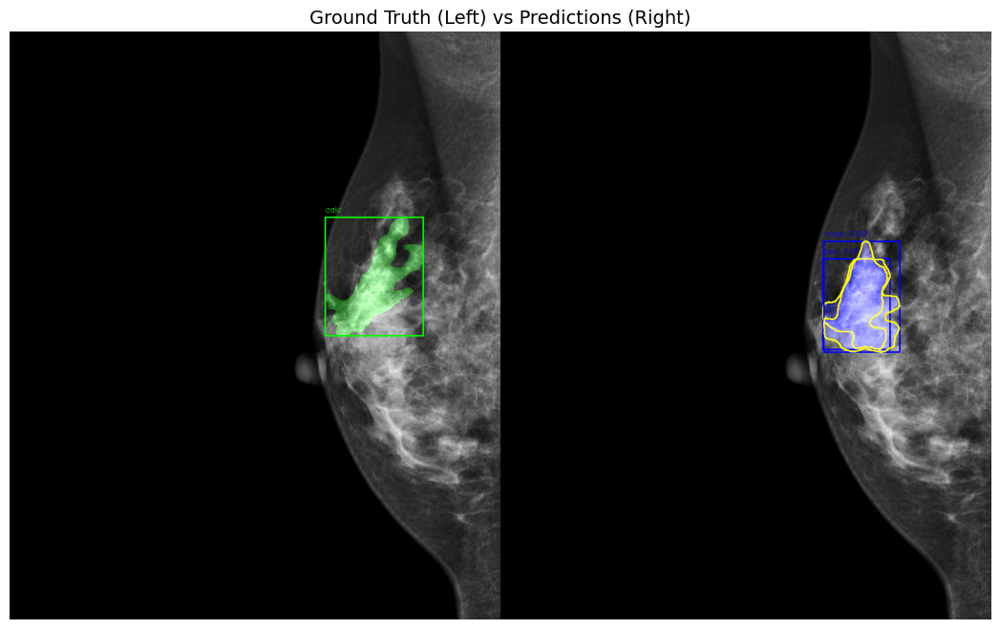


No ground truth masks available


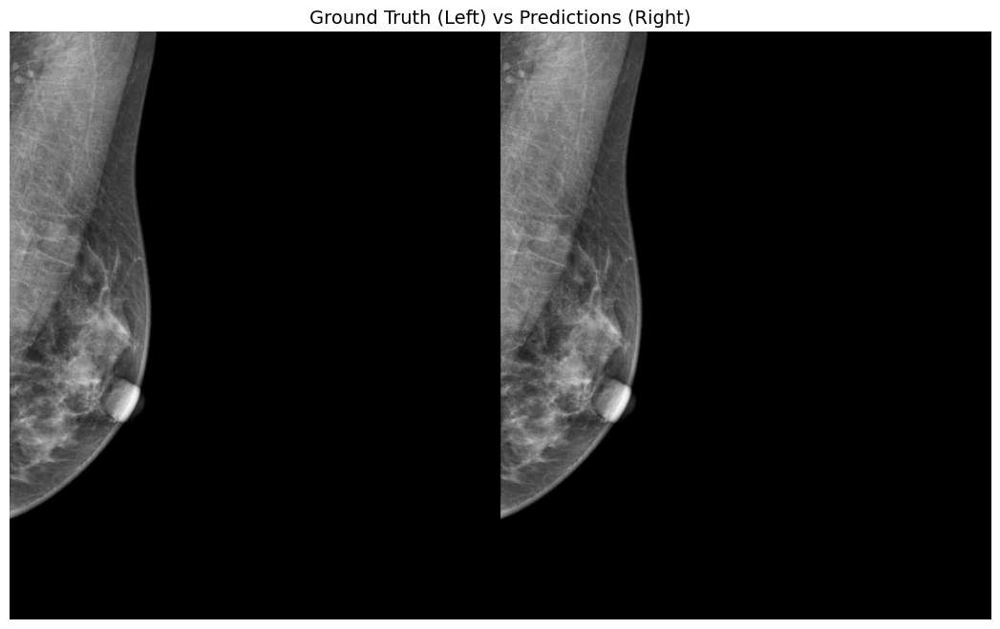


calc: No ground truth instances
mass: Avg IoU = 0.697 (1/1 matched)

Overall IoU: 0.697 (1 instances)


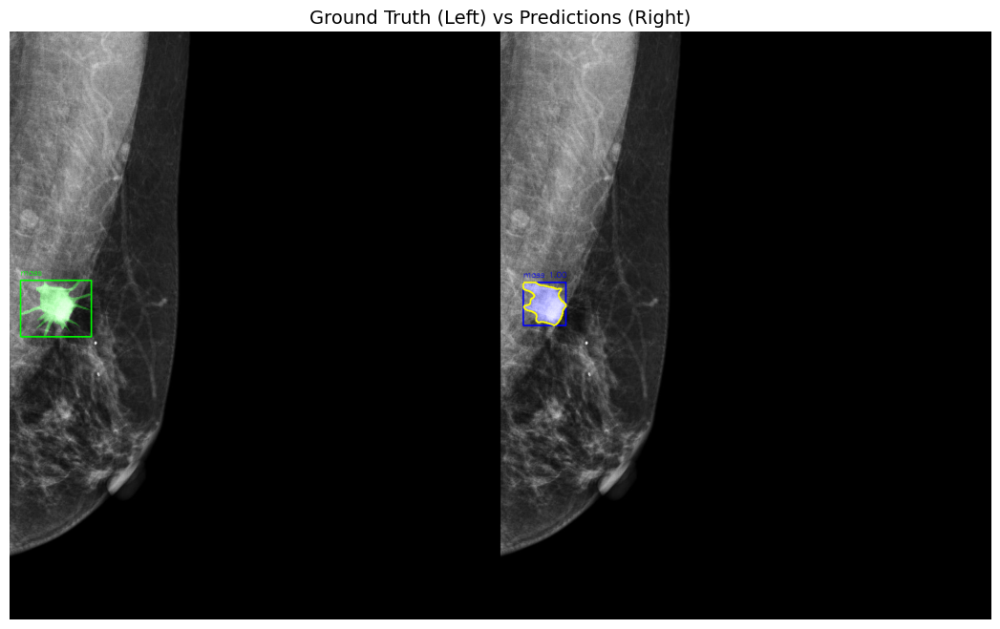


calc: No ground truth instances
mass: Avg IoU = 0.921 (1/1 matched)

Overall IoU: 0.921 (1 instances)


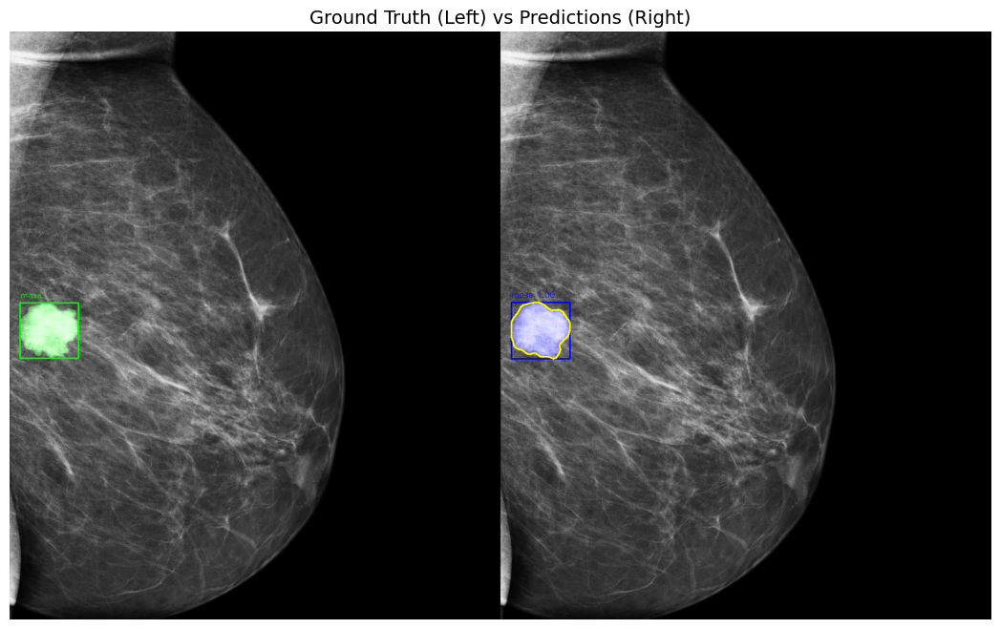


calc: No ground truth instances
mass: Avg IoU = 0.593 (1/1 matched)

Overall IoU: 0.593 (1 instances)


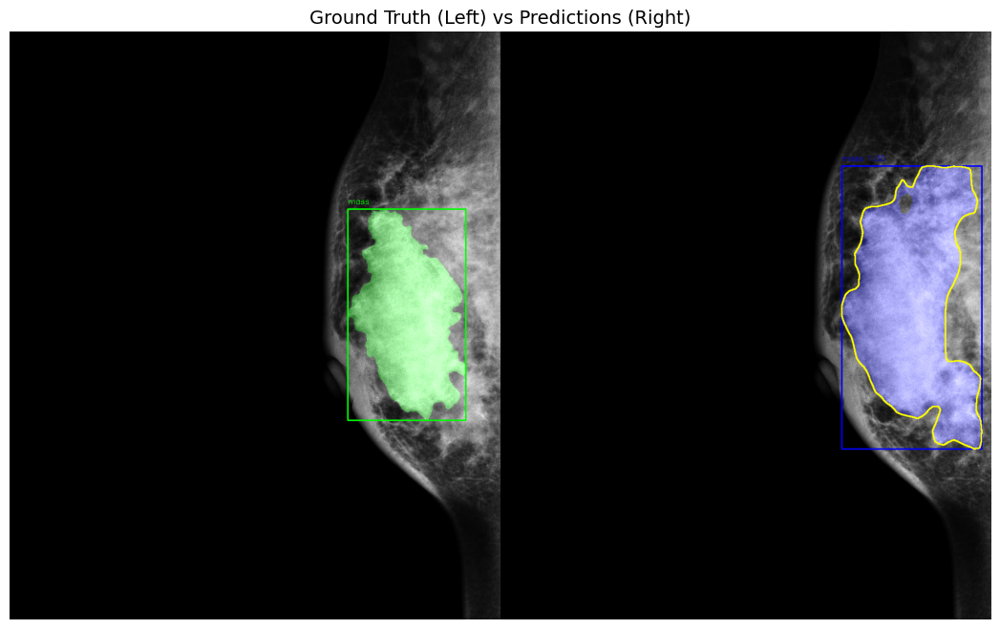


calc: No ground truth instances
mass: Avg IoU = 0.889 (1/1 matched)

Overall IoU: 0.889 (1 instances)


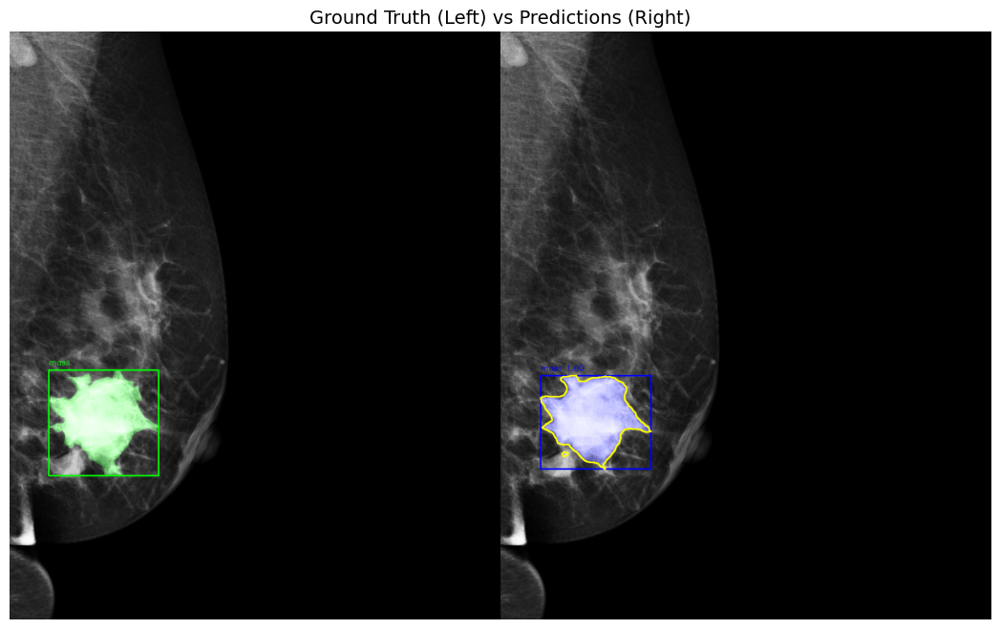


calc: No ground truth instances
mass: Avg IoU = 0.648 (1/1 matched)

Overall IoU: 0.648 (1 instances)


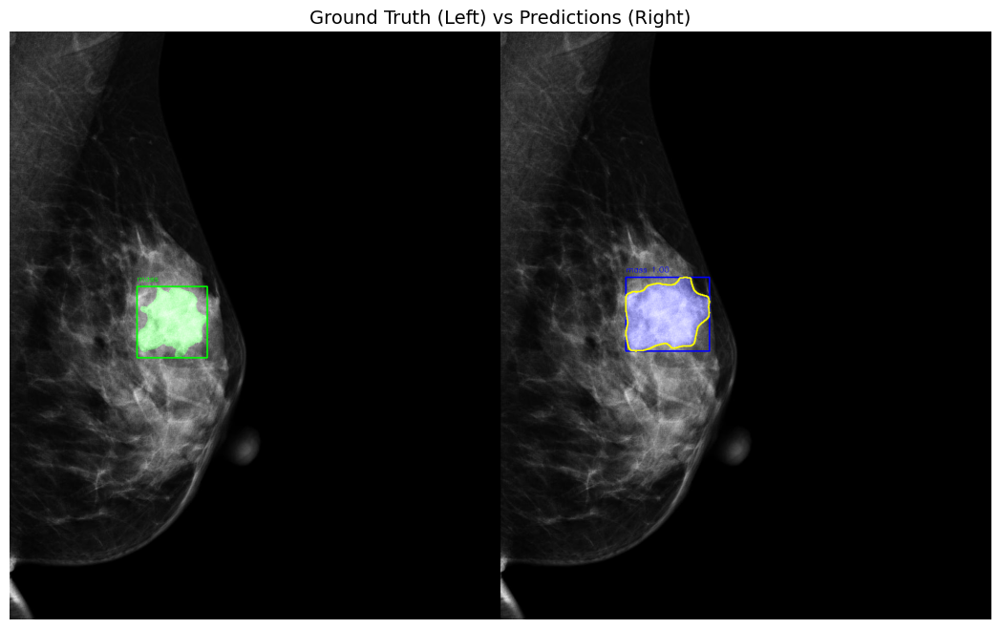


calc: No ground truth instances
mass: Avg IoU = 0.000 (0/1 matched)

Overall IoU: 0.000 (1 instances)


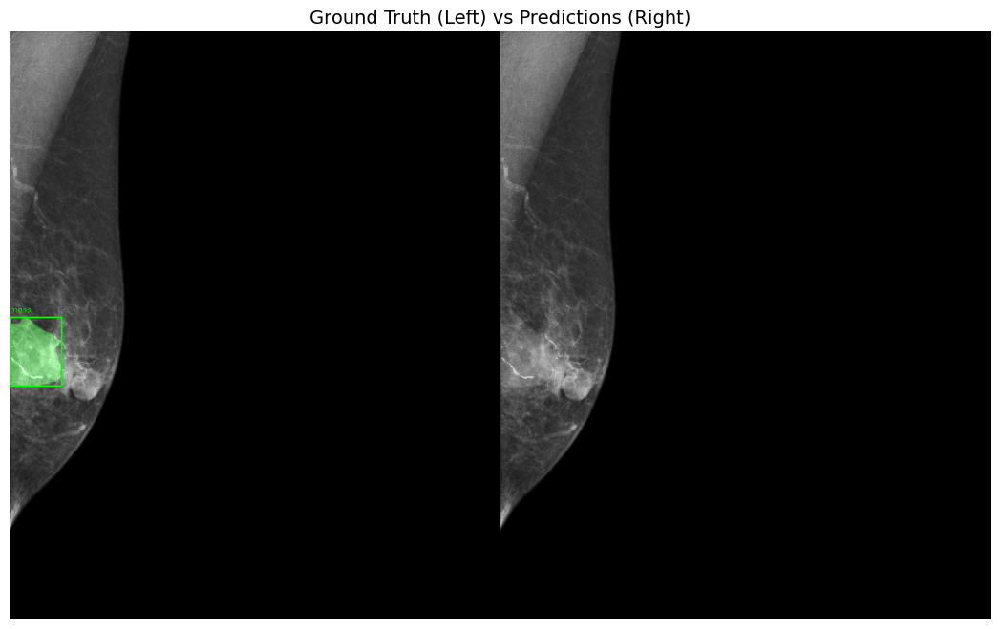


calc: No ground truth instances
mass: Avg IoU = 0.874 (1/1 matched)

Overall IoU: 0.874 (1 instances)


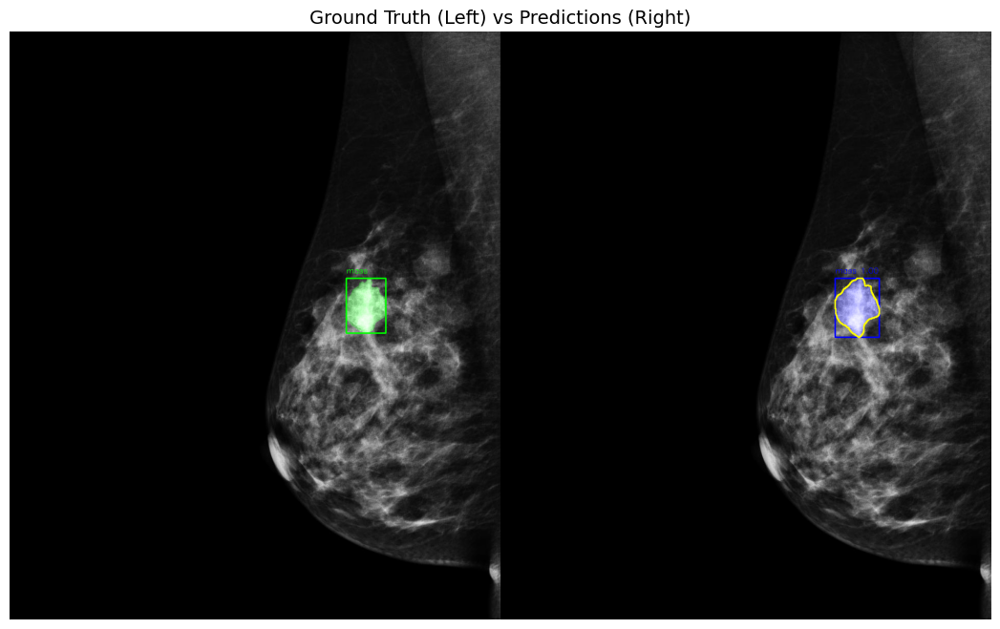


calc: No ground truth instances
mass: Avg IoU = 0.517 (1/1 matched)

Overall IoU: 0.517 (1 instances)


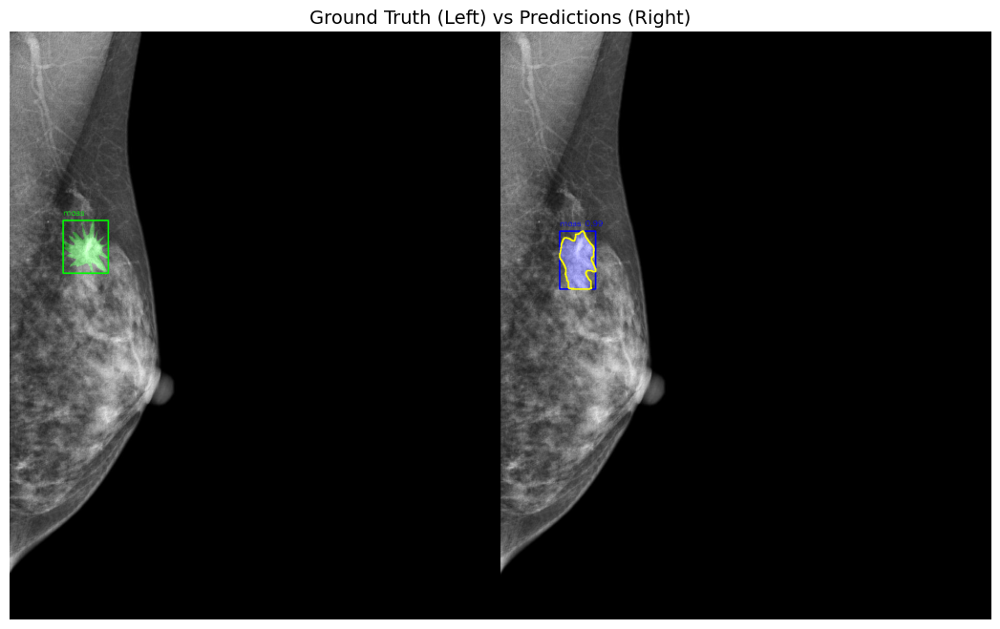


calc: No ground truth instances
mass: Avg IoU = 0.642 (1/1 matched)

Overall IoU: 0.642 (1 instances)


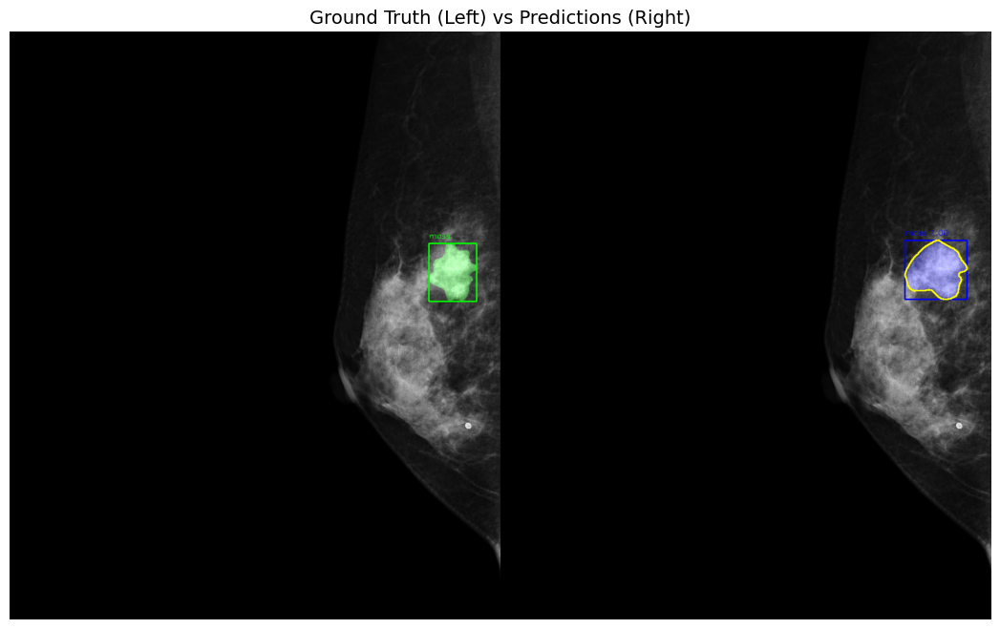


calc: No ground truth instances
mass: Avg IoU = 0.923 (1/1 matched)

Overall IoU: 0.923 (1 instances)


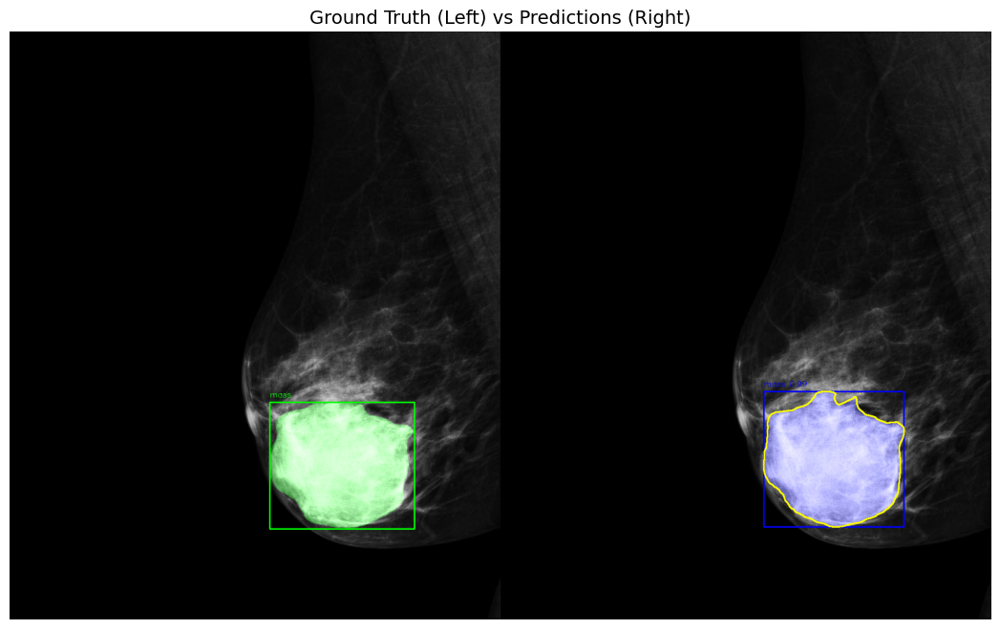


No ground truth masks available


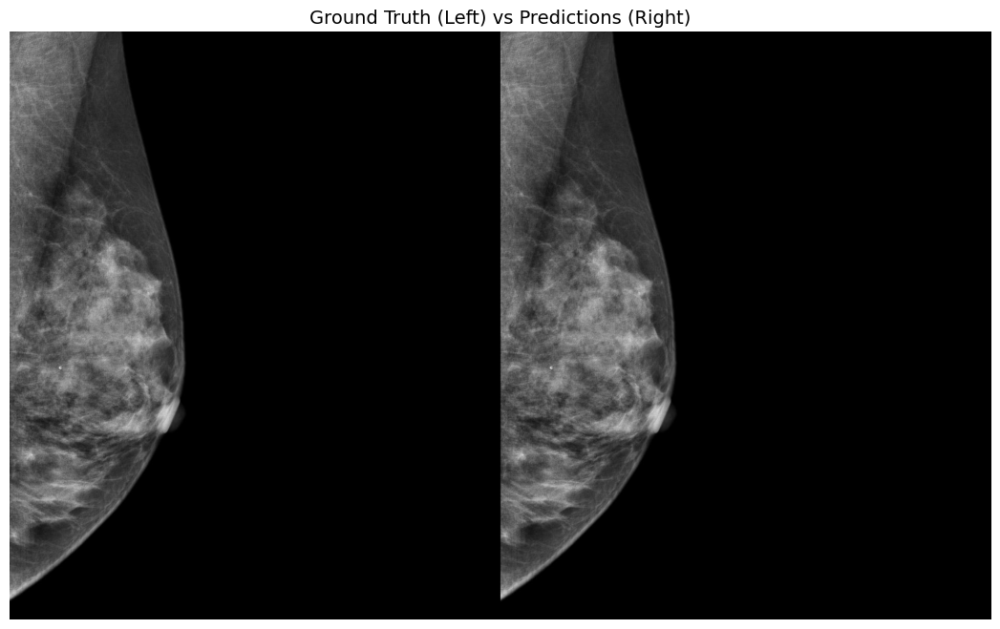


calc: No ground truth instances
mass: Avg IoU = 0.545 (1/1 matched)

Overall IoU: 0.545 (1 instances)


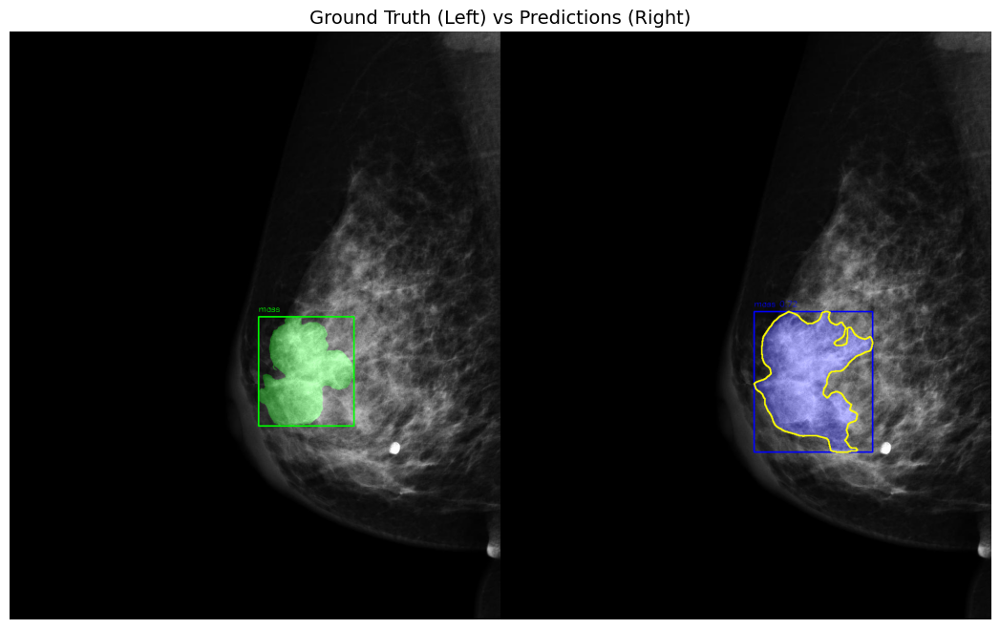


calc: No ground truth instances
mass: Avg IoU = 0.826 (1/1 matched)

Overall IoU: 0.826 (1 instances)


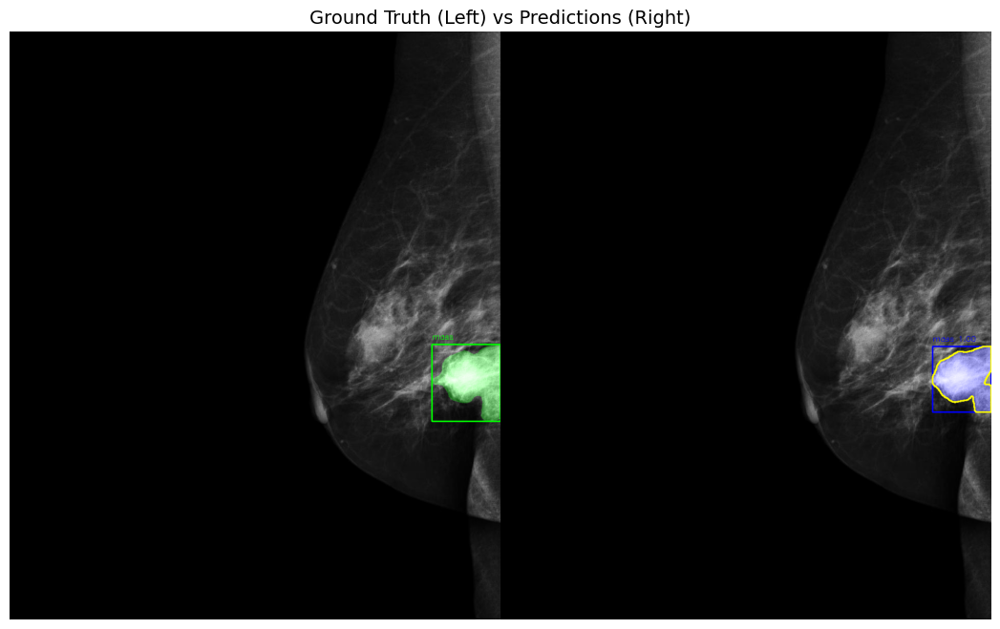


calc: No ground truth instances
mass: Avg IoU = 0.903 (1/1 matched)

Overall IoU: 0.903 (1 instances)


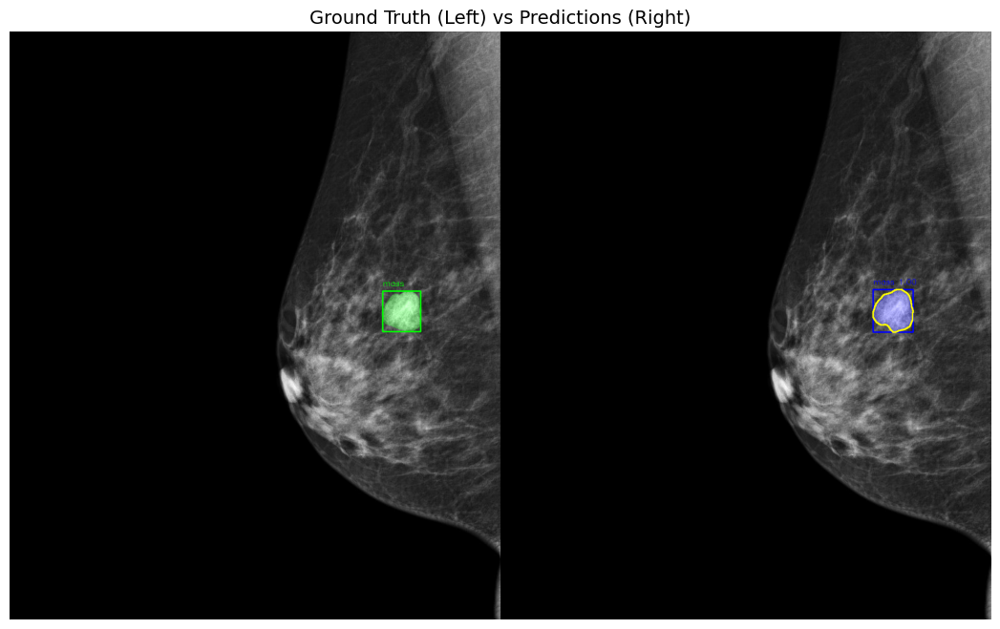


calc: Avg IoU = 0.326 (1/1 matched)
mass: Avg IoU = 0.744 (1/1 matched)

Overall IoU: 0.535 (2 instances)


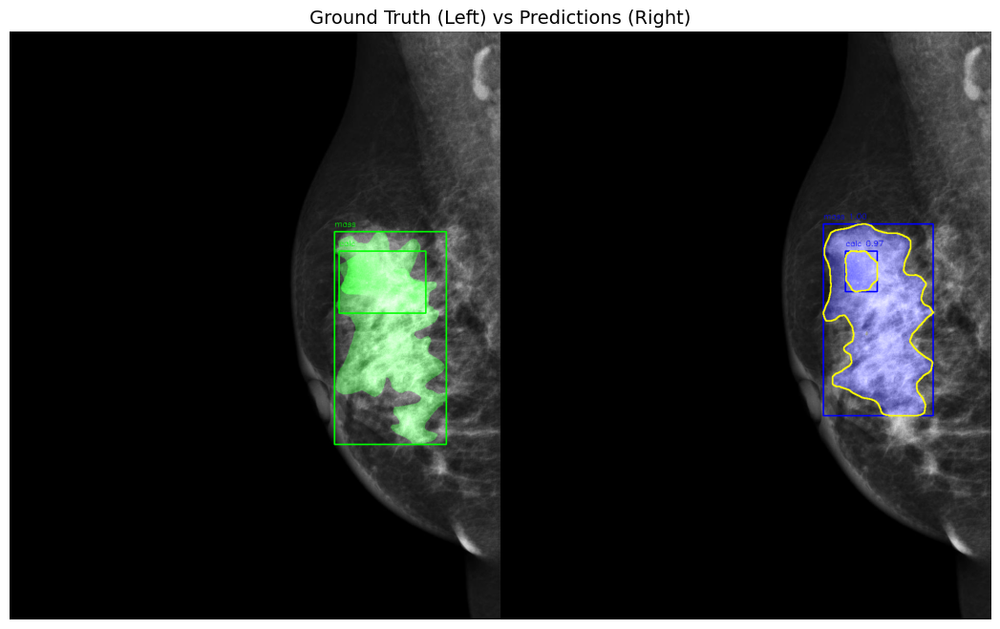


No ground truth masks available


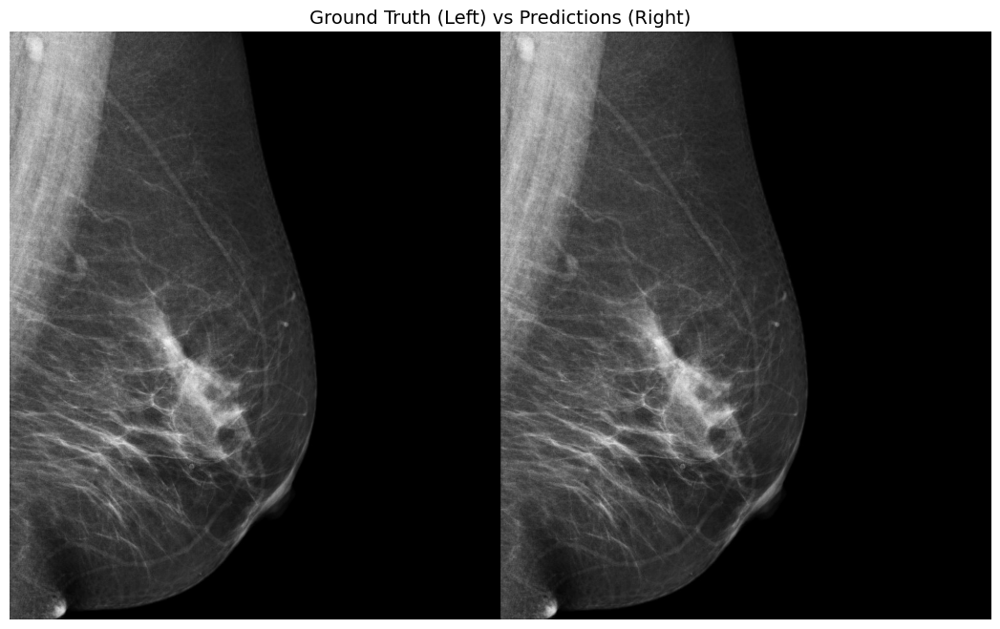


calc: Avg IoU = 0.000 (0/1 matched)
mass: No ground truth instances

Overall IoU: 0.000 (1 instances)


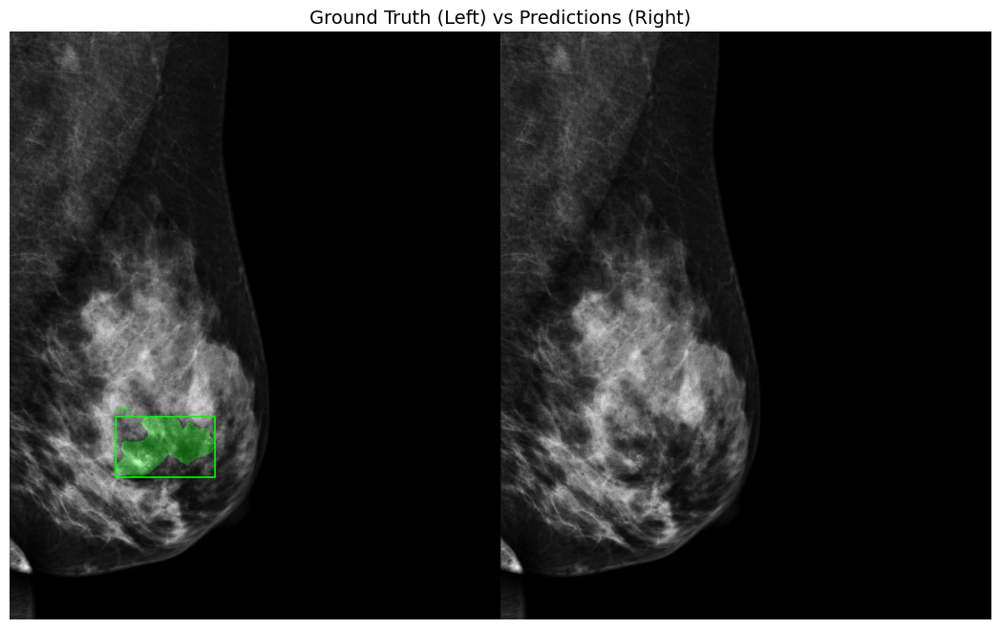


No ground truth masks available


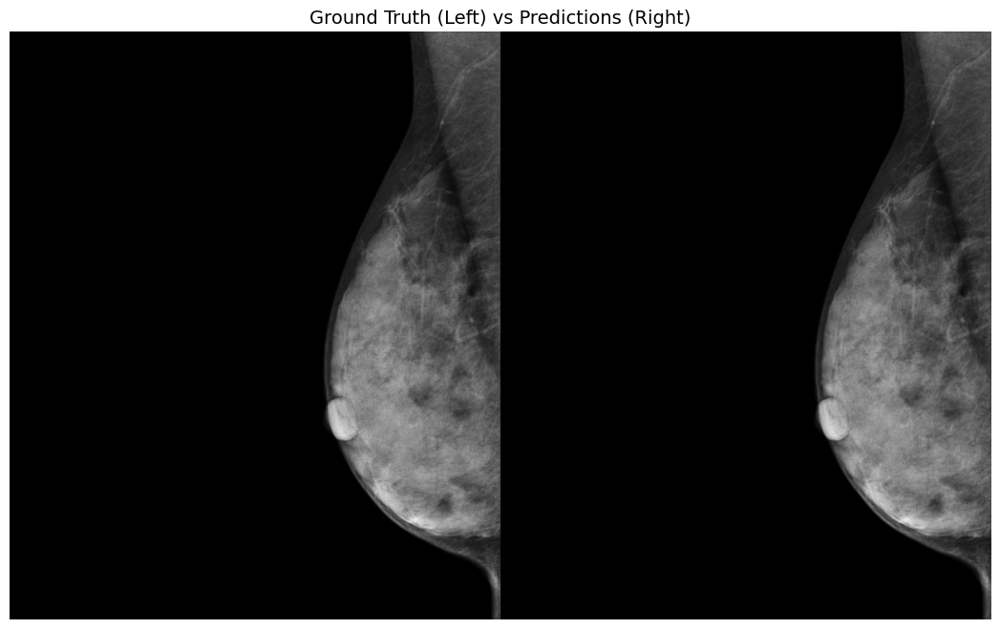


No ground truth masks available


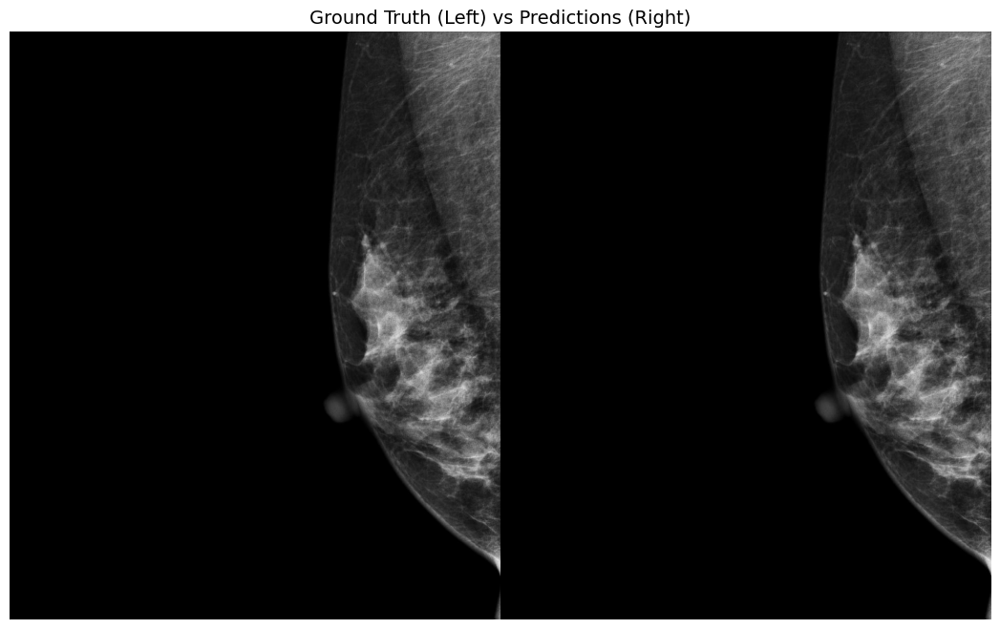


calc: No ground truth instances
mass: Avg IoU = 0.680 (1/1 matched)

Overall IoU: 0.680 (1 instances)


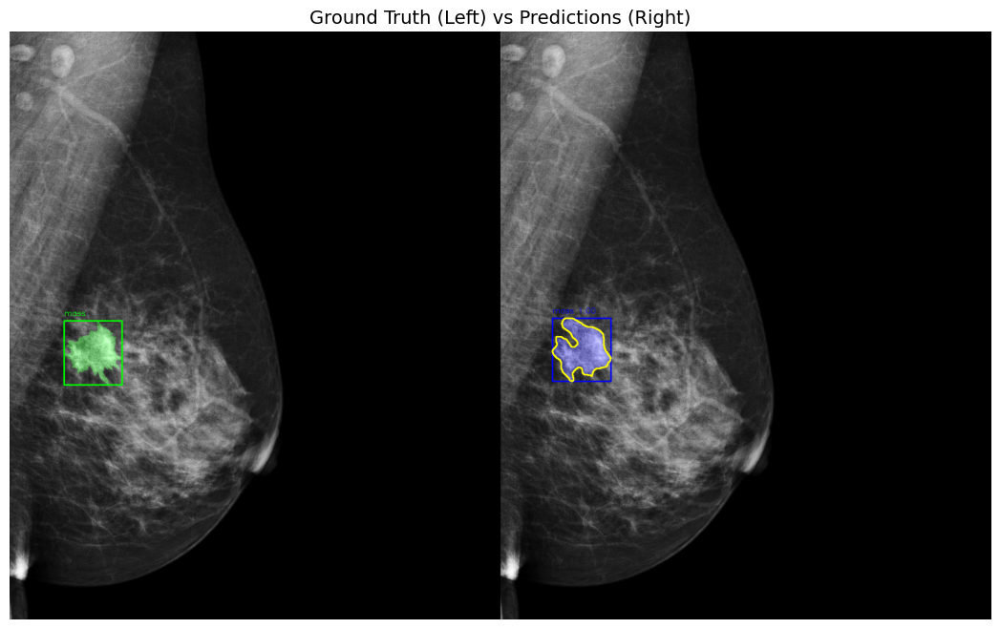


calc: Avg IoU = 0.348 (1/1 matched)
mass: Avg IoU = 0.788 (1/1 matched)

Overall IoU: 0.568 (2 instances)


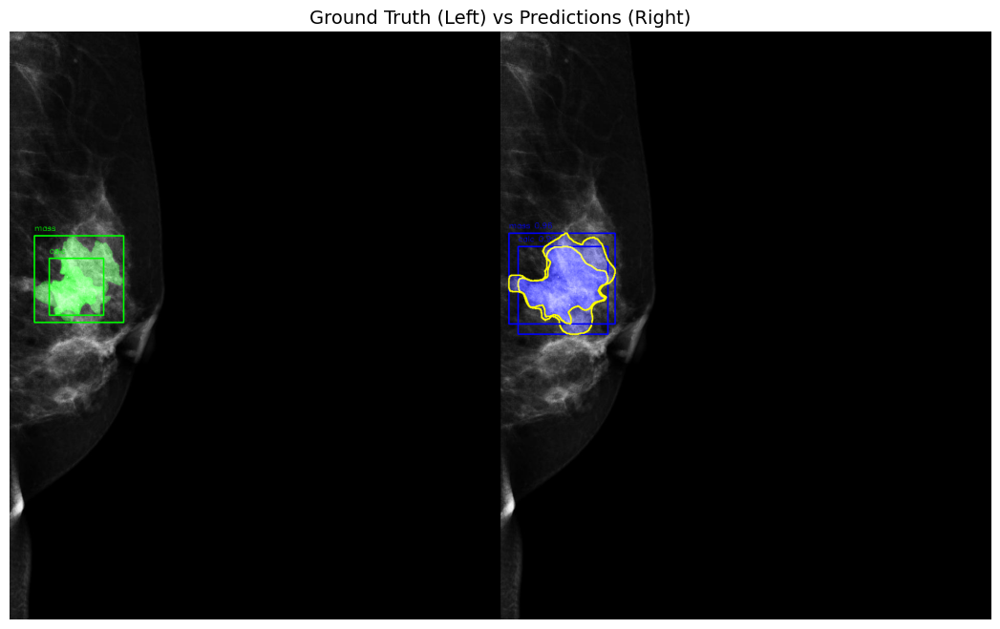


No ground truth masks available


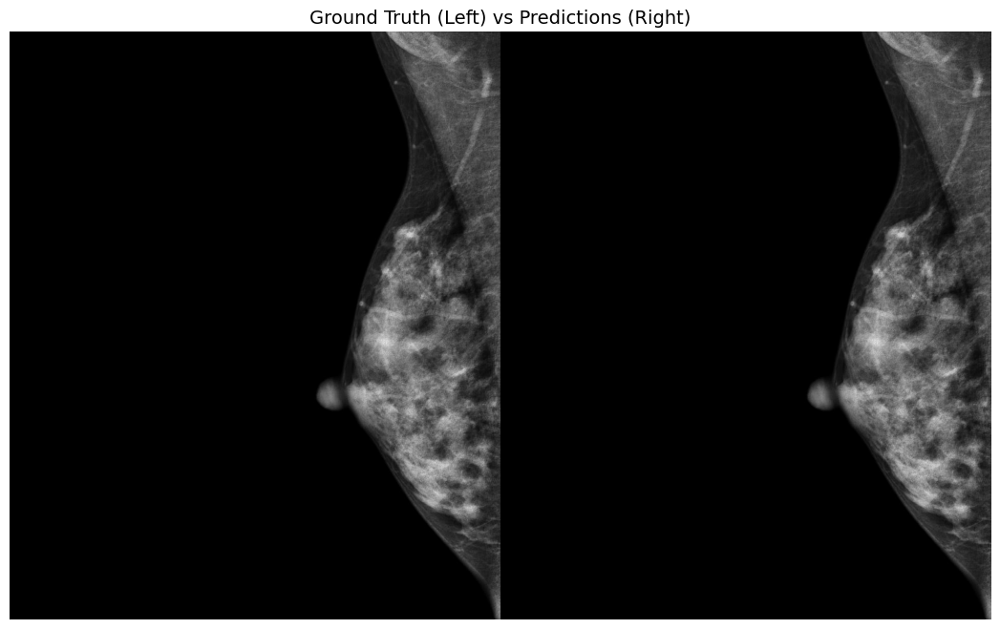


No ground truth masks available


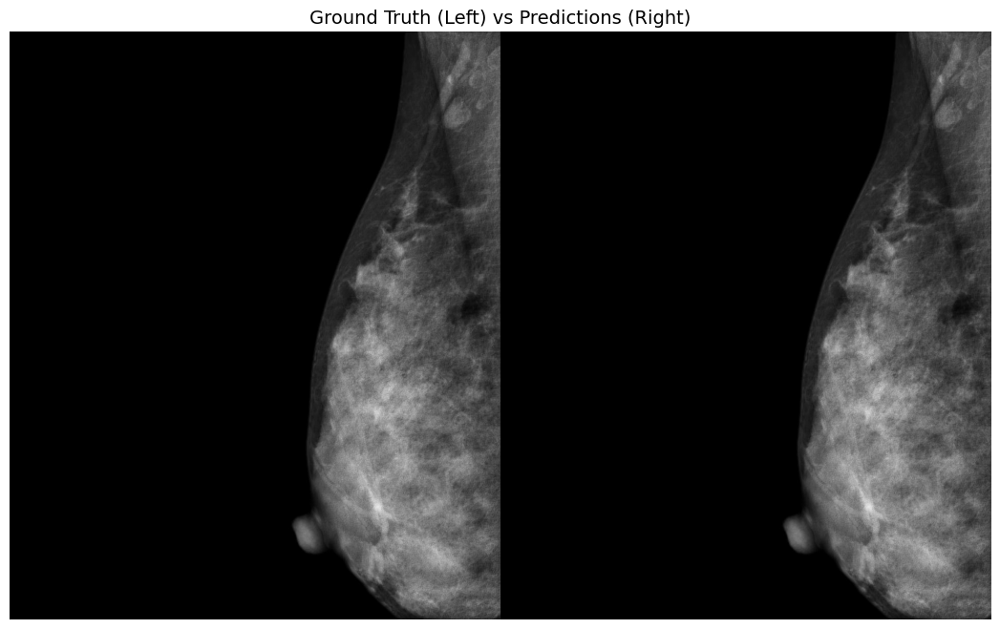


No ground truth masks available


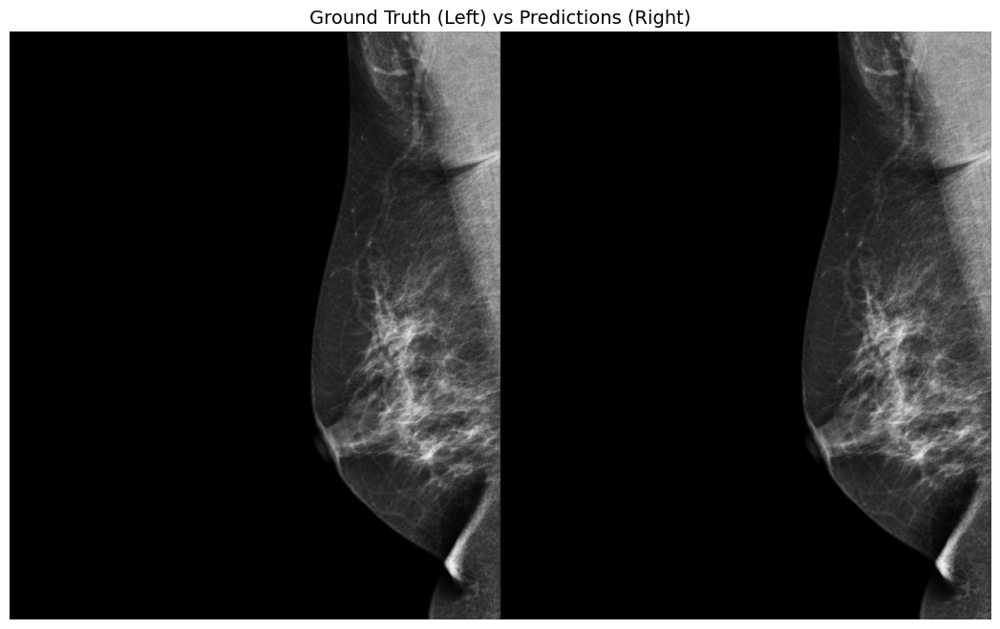


calc: Avg IoU = 0.324 (1/1 matched)
mass: Avg IoU = 0.715 (1/1 matched)

Overall IoU: 0.519 (2 instances)


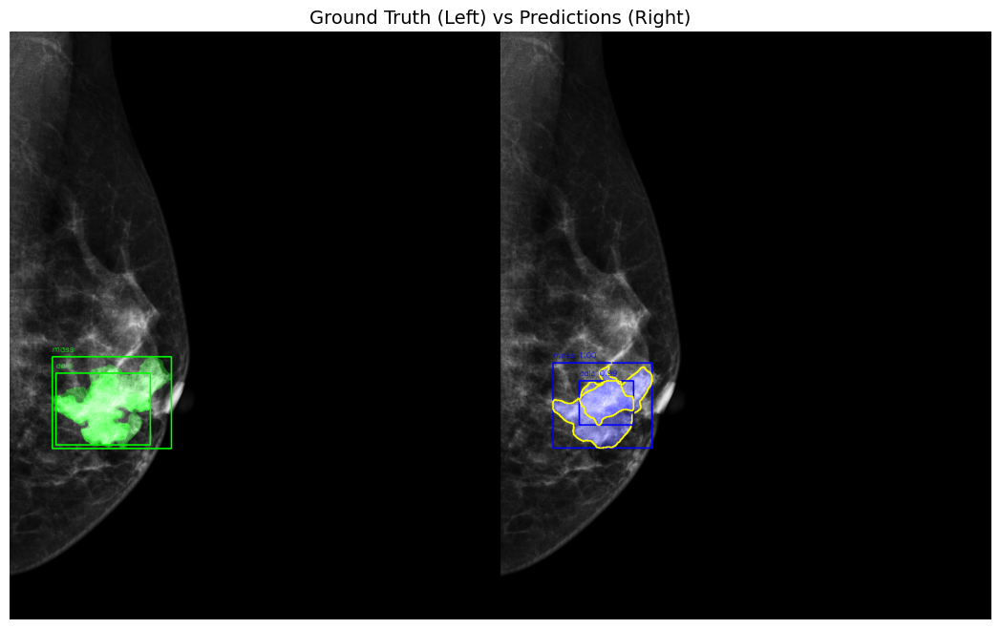


calc: No ground truth instances
mass: Avg IoU = 0.572 (1/1 matched)

Overall IoU: 0.572 (1 instances)


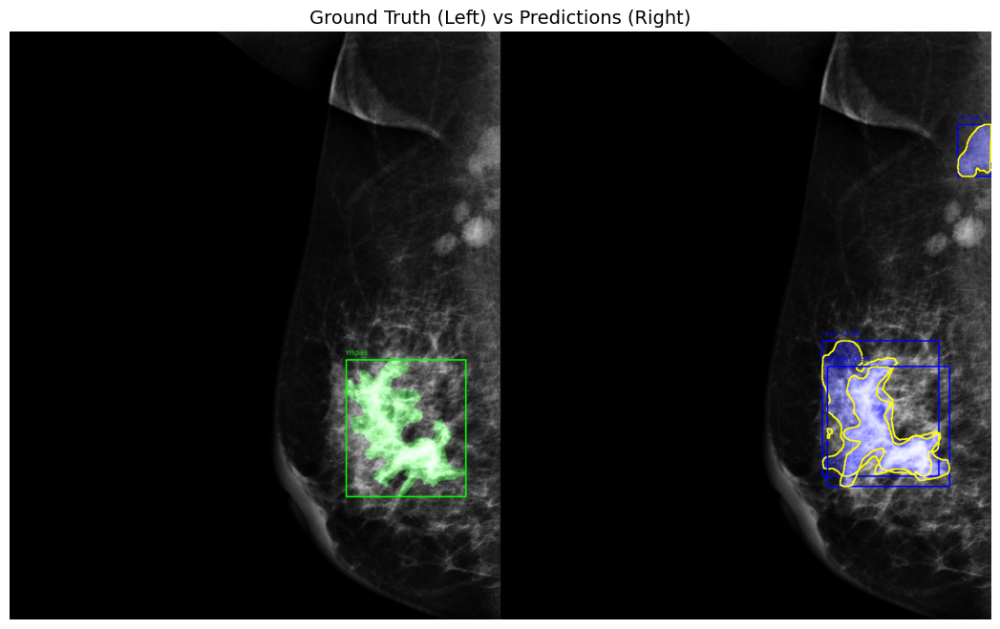


calc: Avg IoU = 0.742 (1/1 matched)
mass: Avg IoU = 0.747 (1/1 matched)

Overall IoU: 0.744 (2 instances)


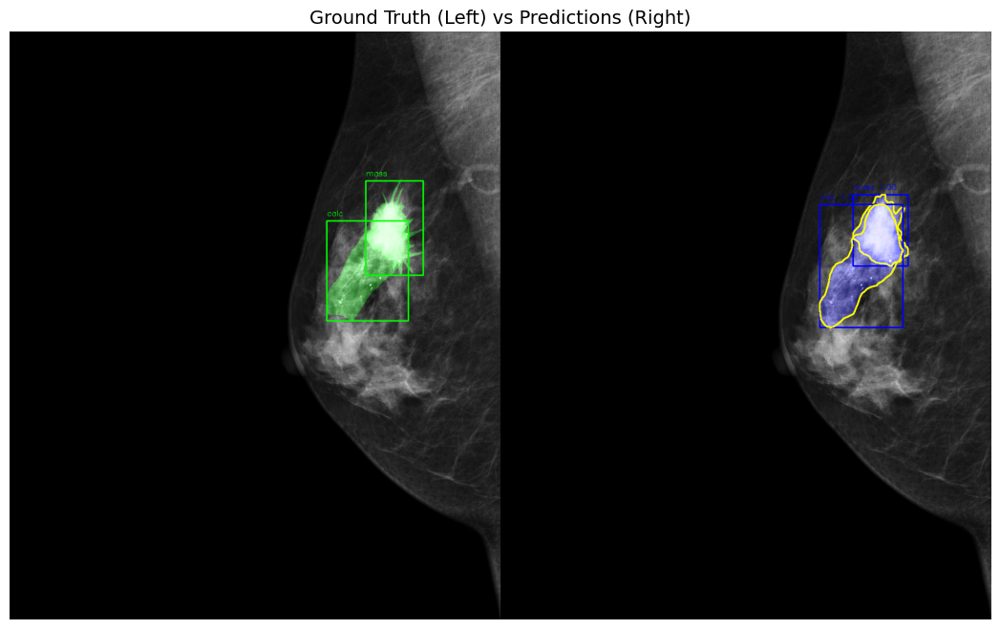


No ground truth masks available


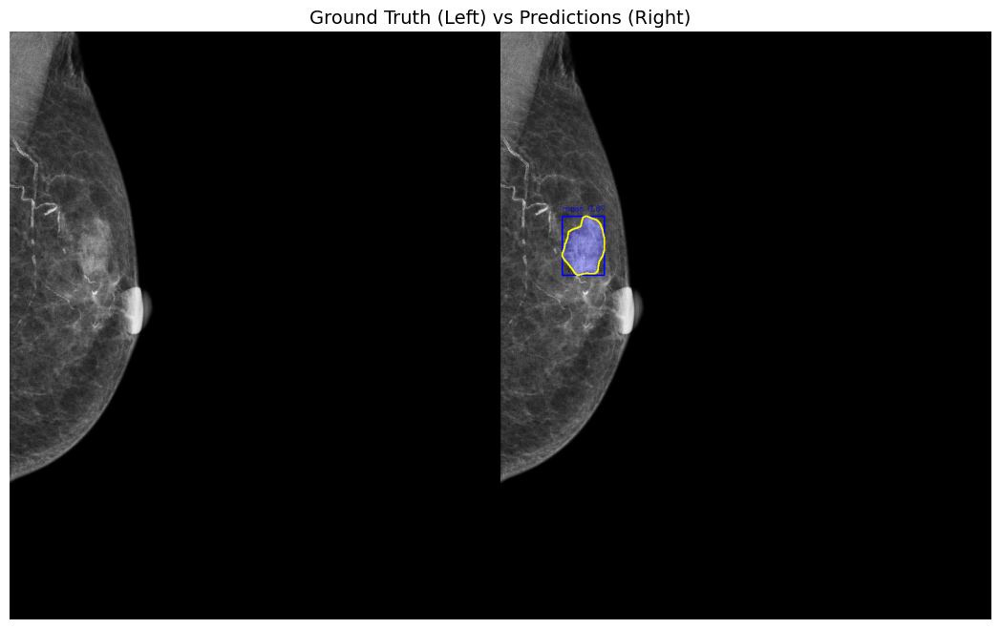


calc: Avg IoU = 0.656 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.656 (1 instances)


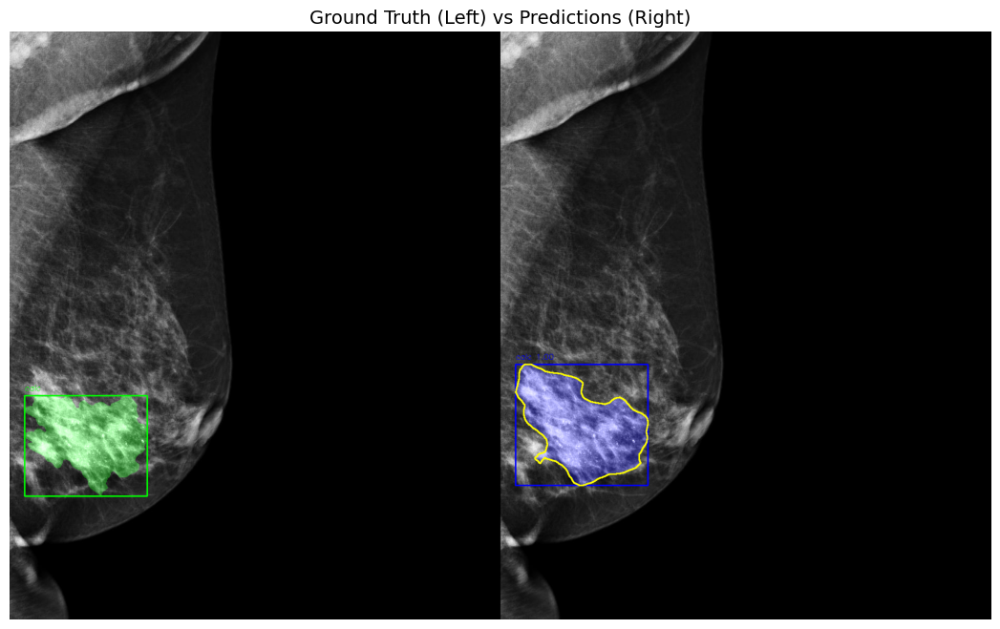


calc: Avg IoU = 0.718 (1/1 matched)
mass: Avg IoU = 0.590 (1/1 matched)

Overall IoU: 0.654 (2 instances)


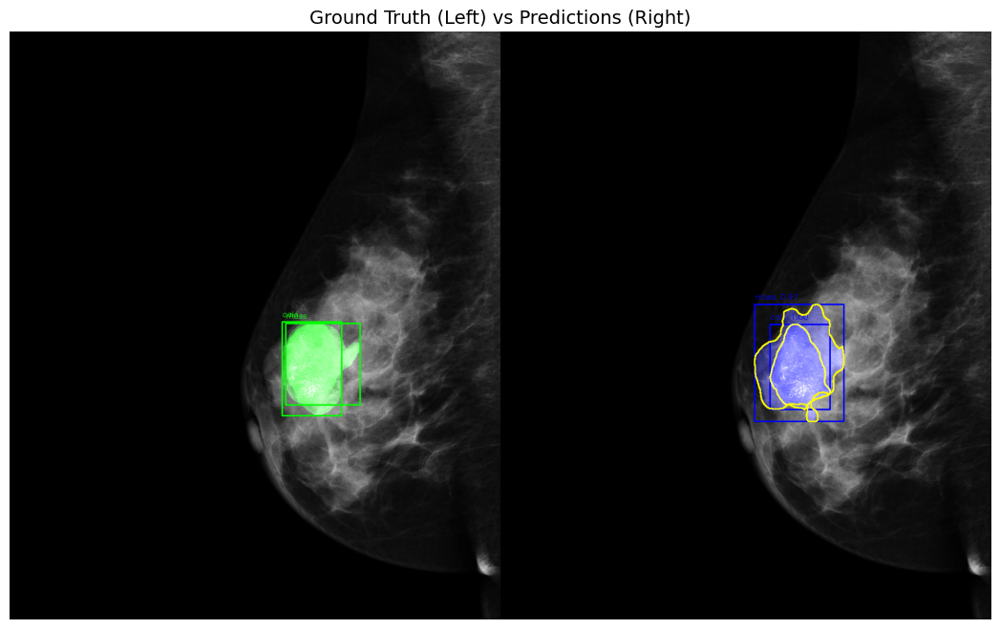


No ground truth masks available


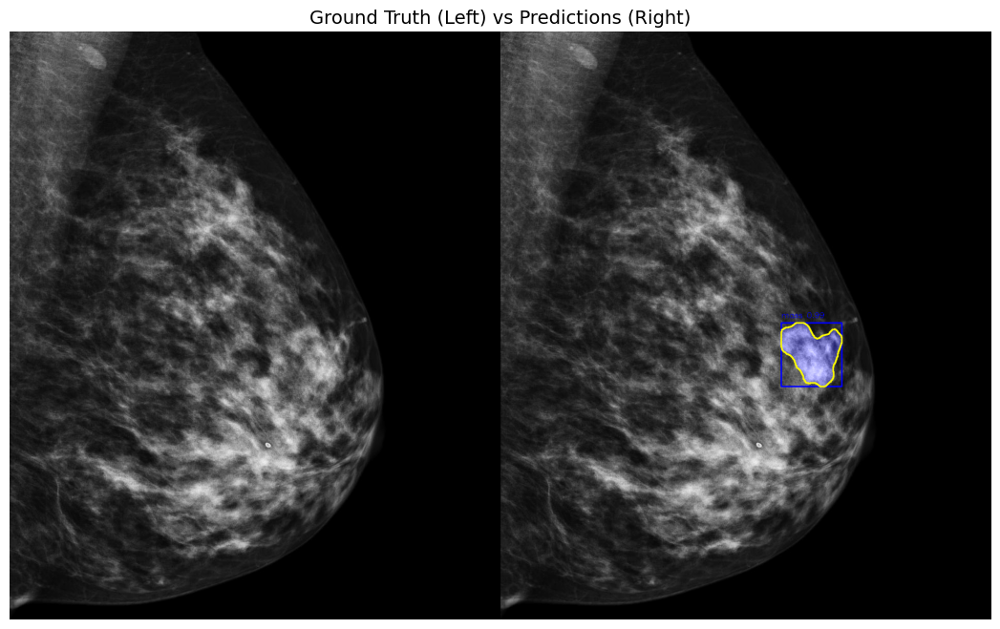


calc: No ground truth instances
mass: Avg IoU = 0.864 (1/1 matched)

Overall IoU: 0.864 (1 instances)


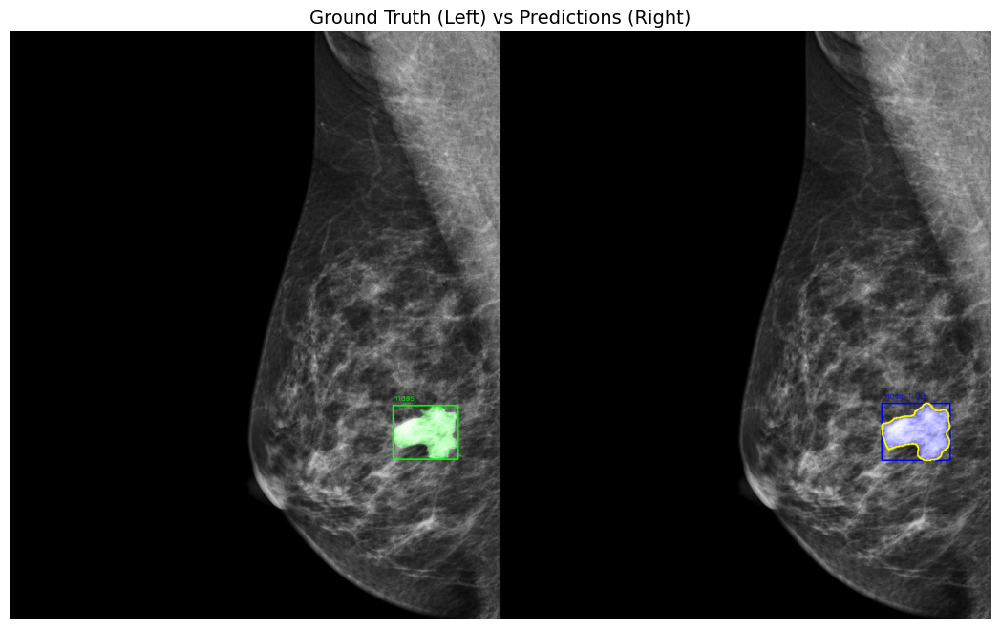


No ground truth masks available


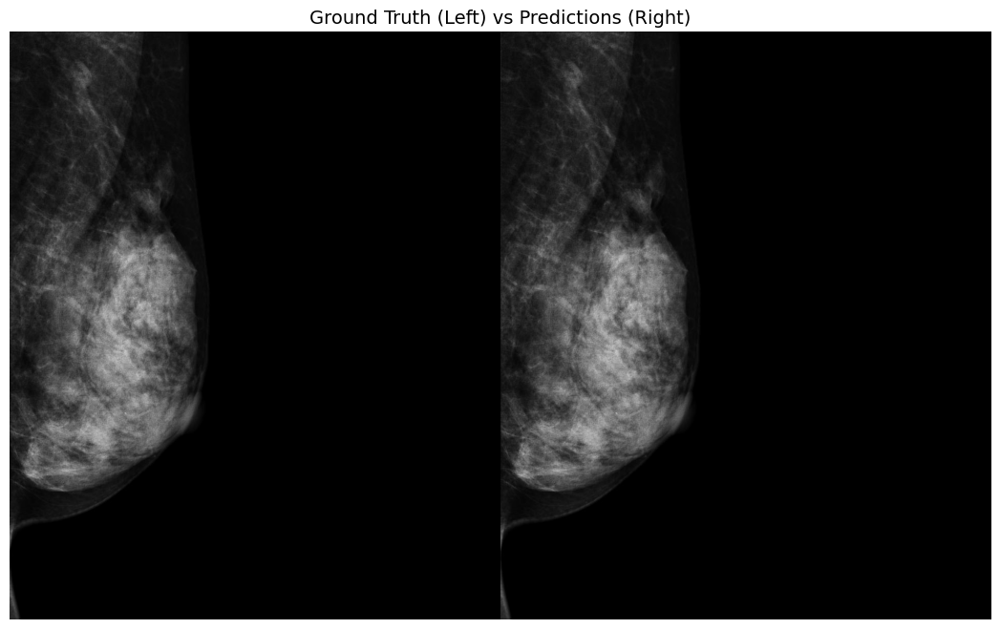


calc: Avg IoU = 0.407 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.407 (1 instances)


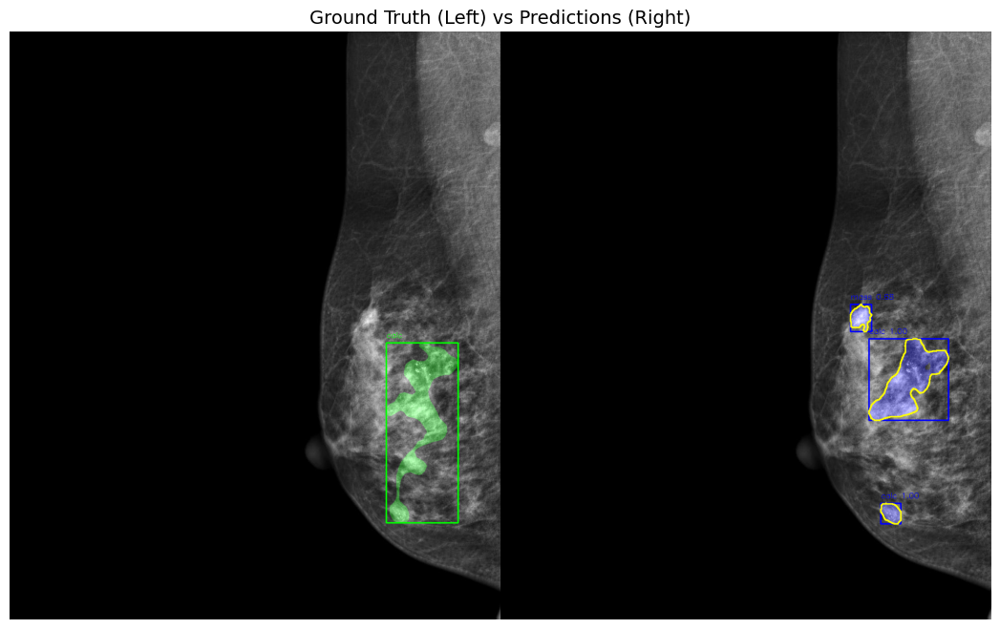


calc: Avg IoU = 0.779 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.779 (1 instances)


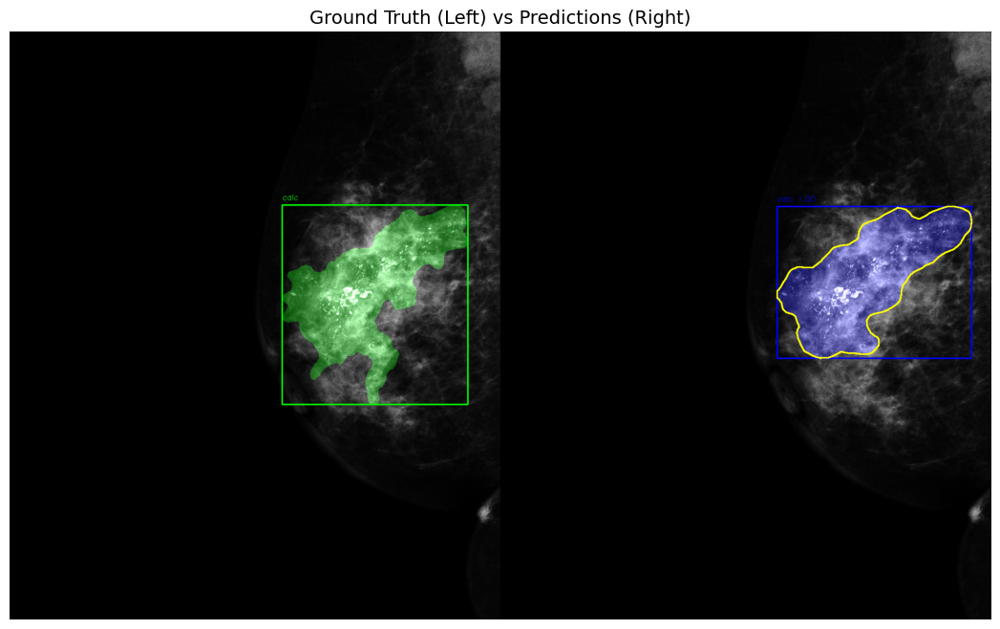


calc: No ground truth instances
mass: Avg IoU = 0.870 (1/1 matched)

Overall IoU: 0.870 (1 instances)


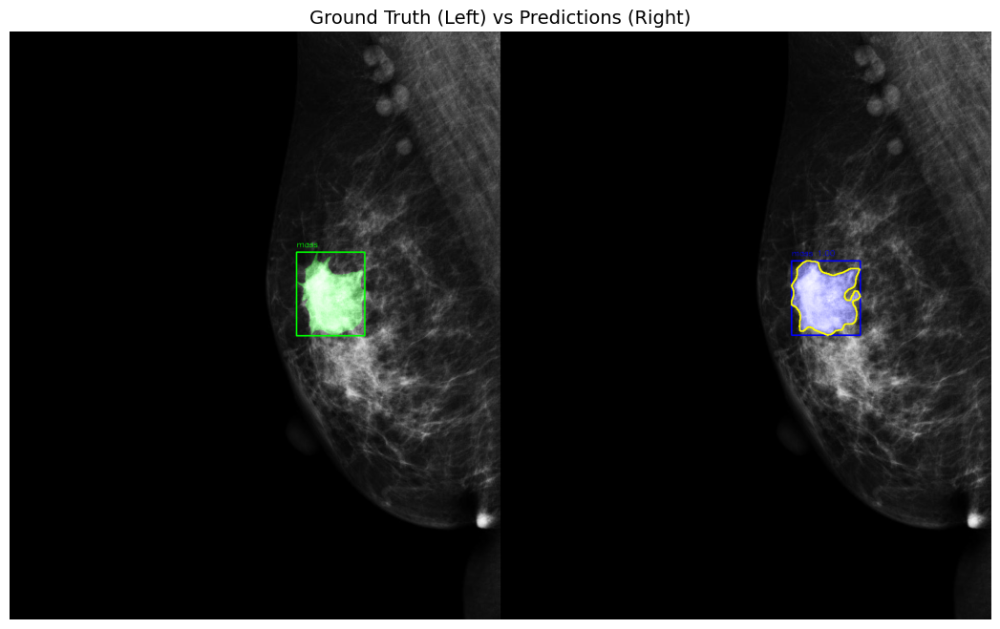


calc: No ground truth instances
mass: Avg IoU = 0.904 (1/1 matched)

Overall IoU: 0.904 (1 instances)


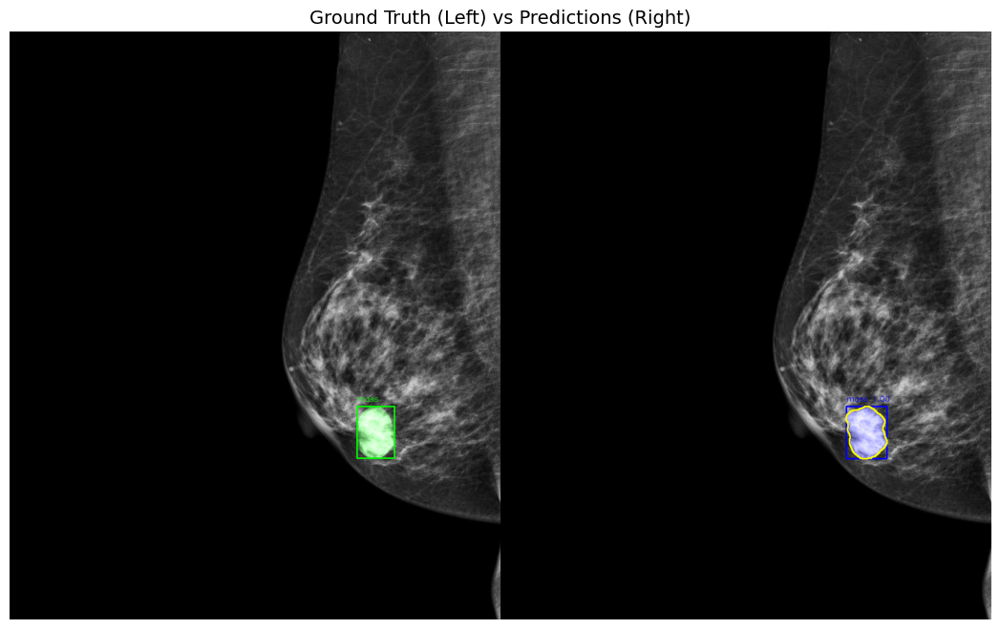


No ground truth masks available


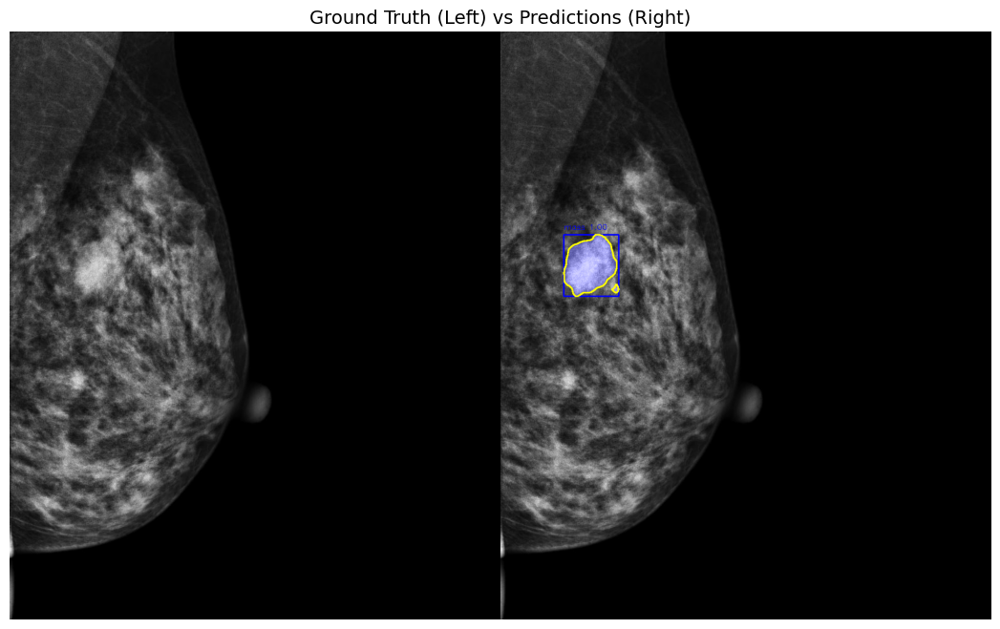


calc: Avg IoU = 0.836 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.836 (1 instances)


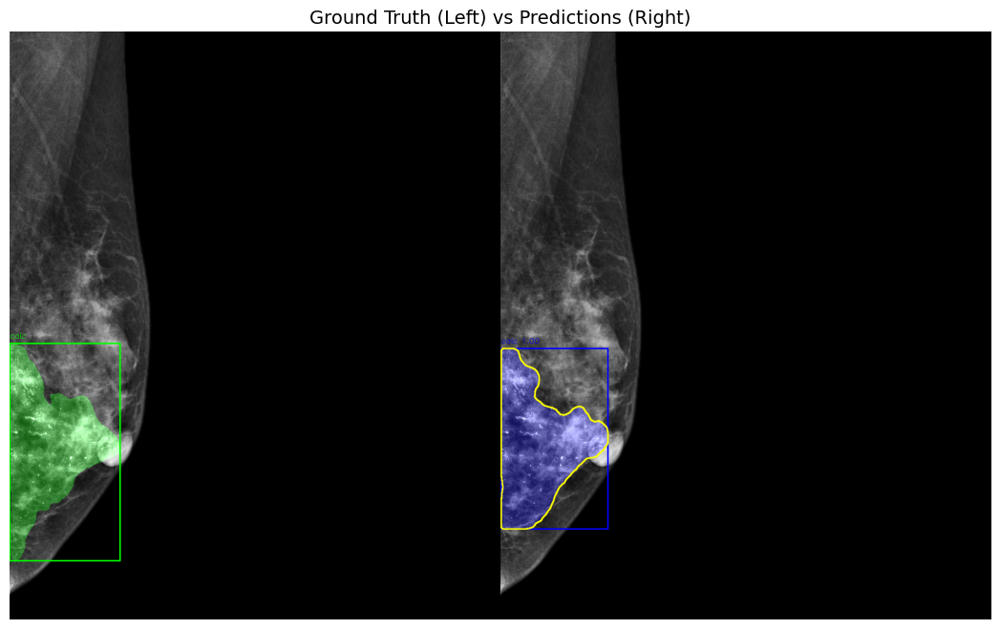


No ground truth masks available


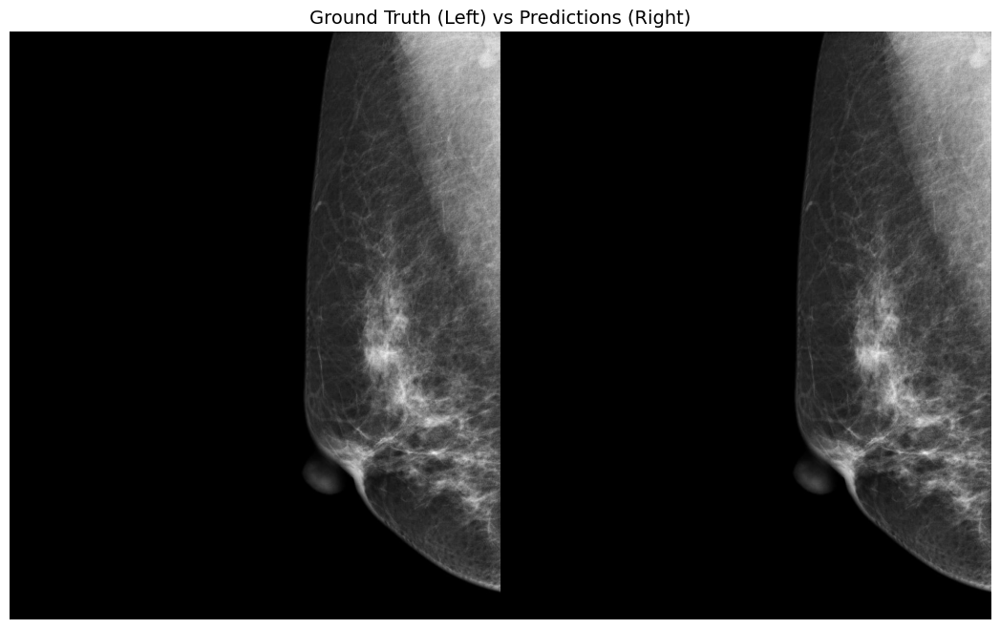


calc: No ground truth instances
mass: Avg IoU = 0.863 (1/1 matched)

Overall IoU: 0.863 (1 instances)


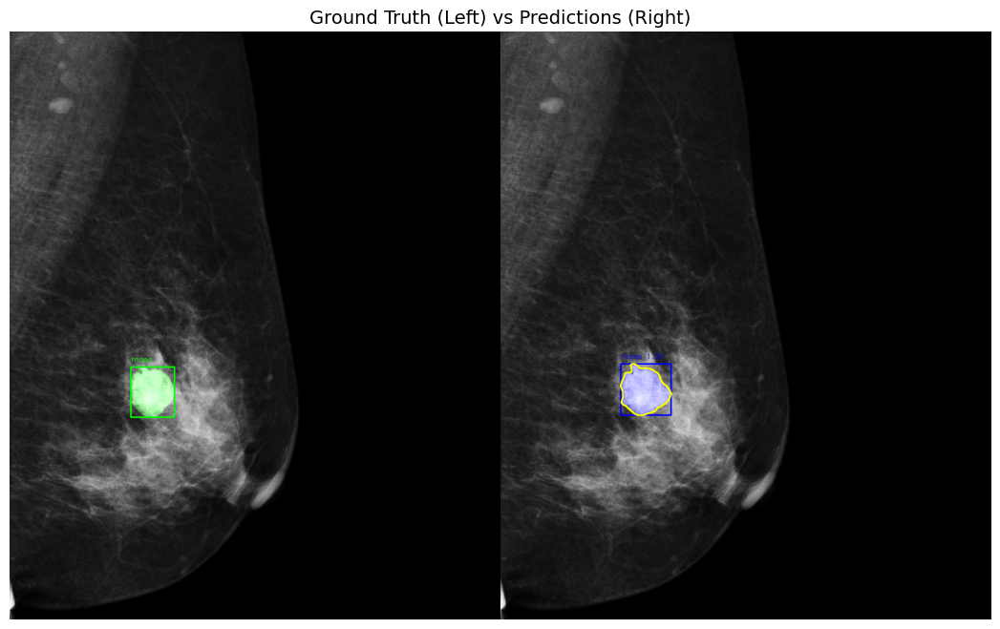


calc: No ground truth instances
mass: Avg IoU = 0.853 (1/1 matched)

Overall IoU: 0.853 (1 instances)


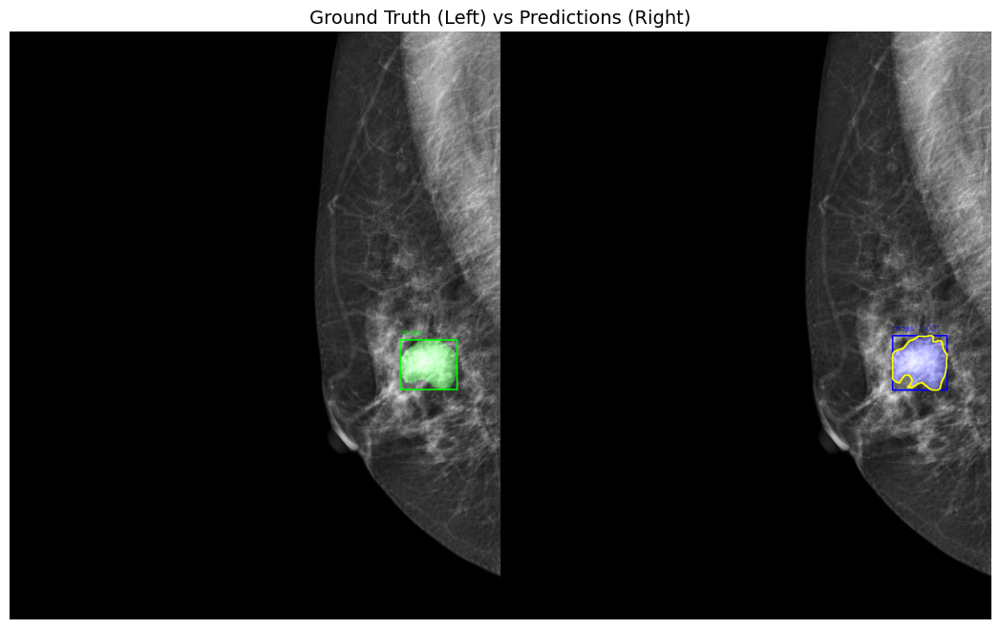


calc: Avg IoU = 0.709 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.709 (1 instances)


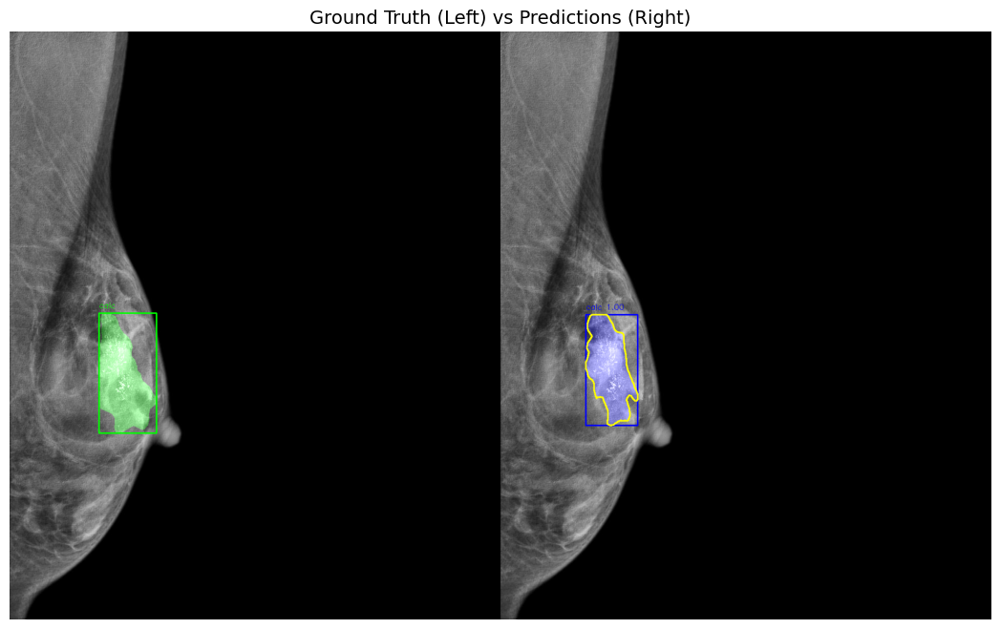


calc: No ground truth instances
mass: Avg IoU = 0.854 (1/1 matched)

Overall IoU: 0.854 (1 instances)


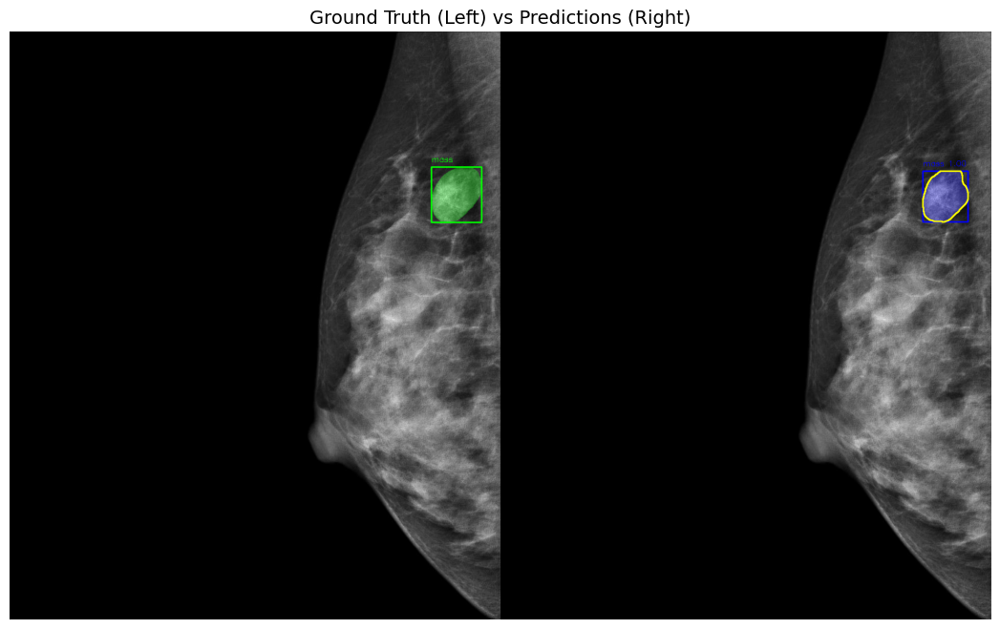


calc: Avg IoU = 0.559 (1/1 matched)
mass: Avg IoU = 0.506 (1/1 matched)

Overall IoU: 0.533 (2 instances)


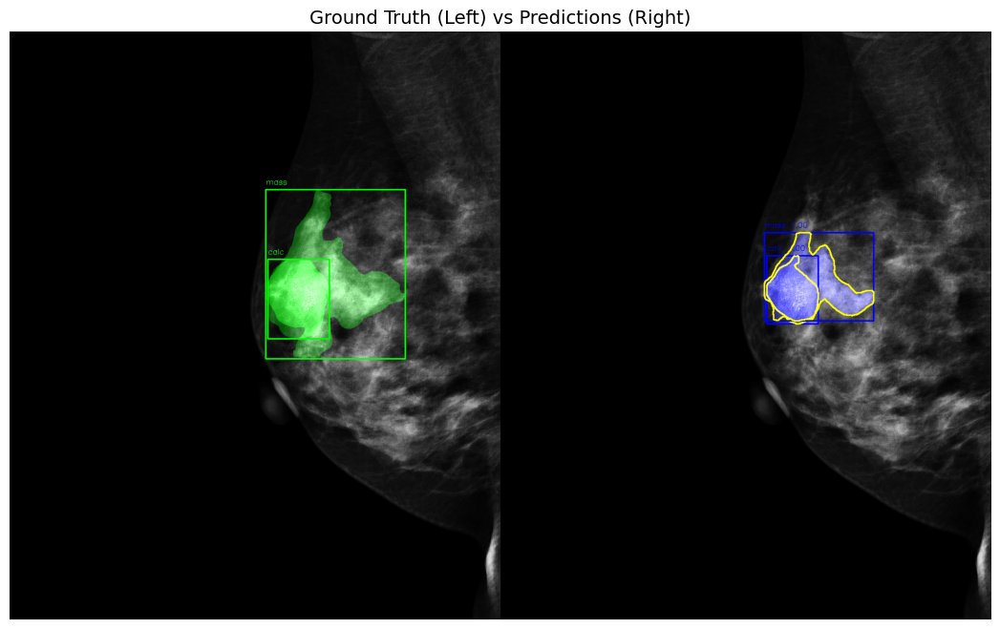


calc: No ground truth instances
mass: Avg IoU = 0.744 (1/1 matched)

Overall IoU: 0.744 (1 instances)


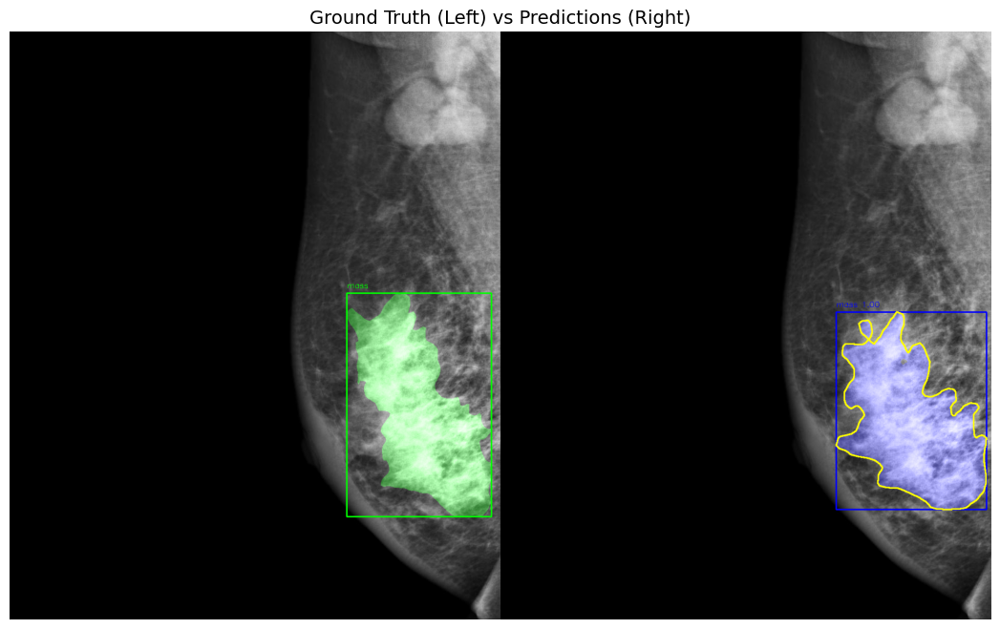


calc: No ground truth instances
mass: Avg IoU = 0.856 (1/1 matched)

Overall IoU: 0.856 (1 instances)


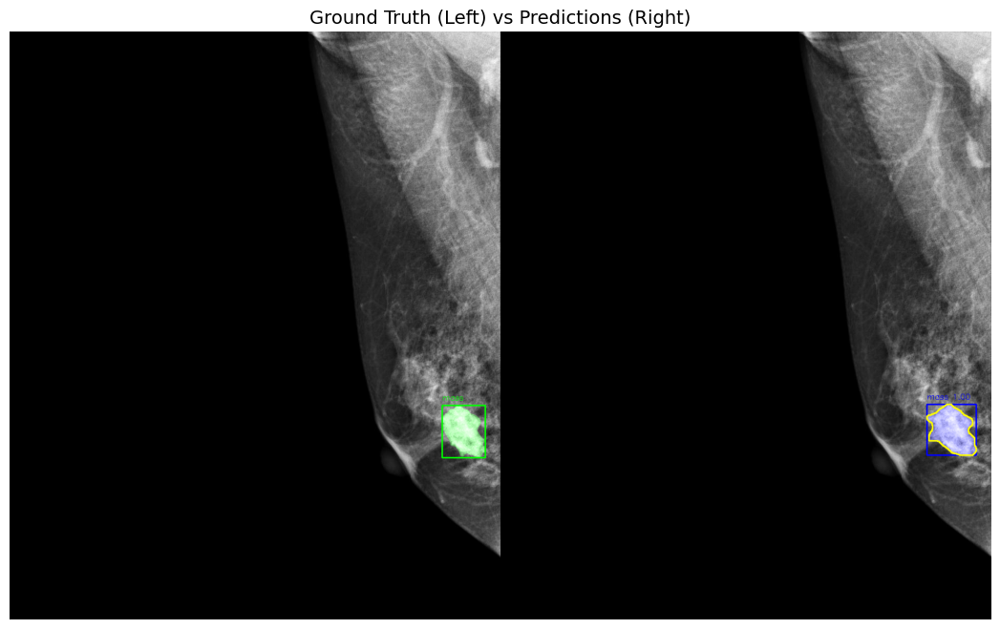


calc: No ground truth instances
mass: Avg IoU = 0.734 (1/1 matched)

Overall IoU: 0.734 (1 instances)


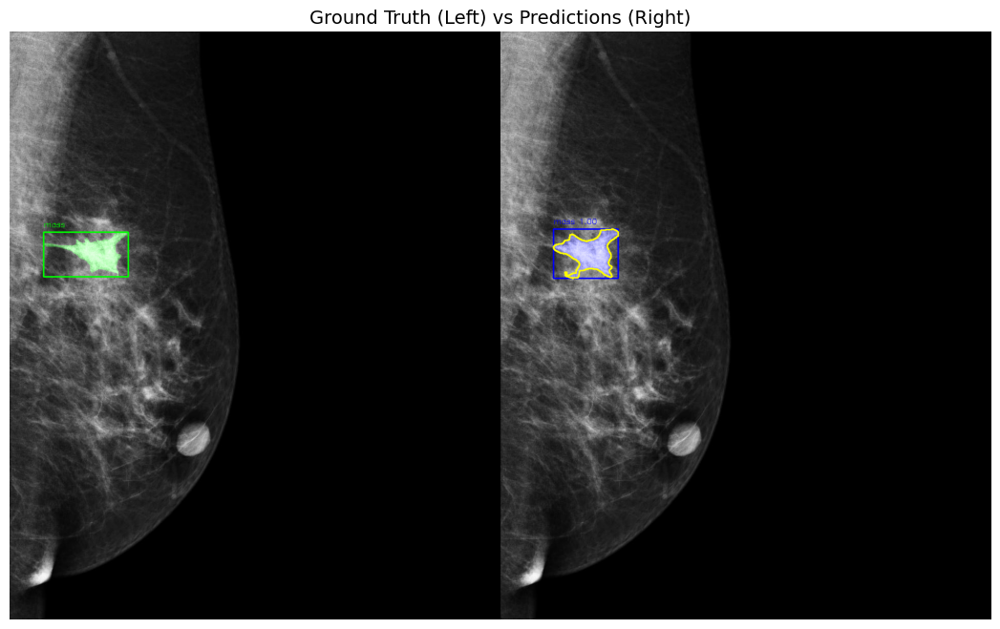


No ground truth masks available


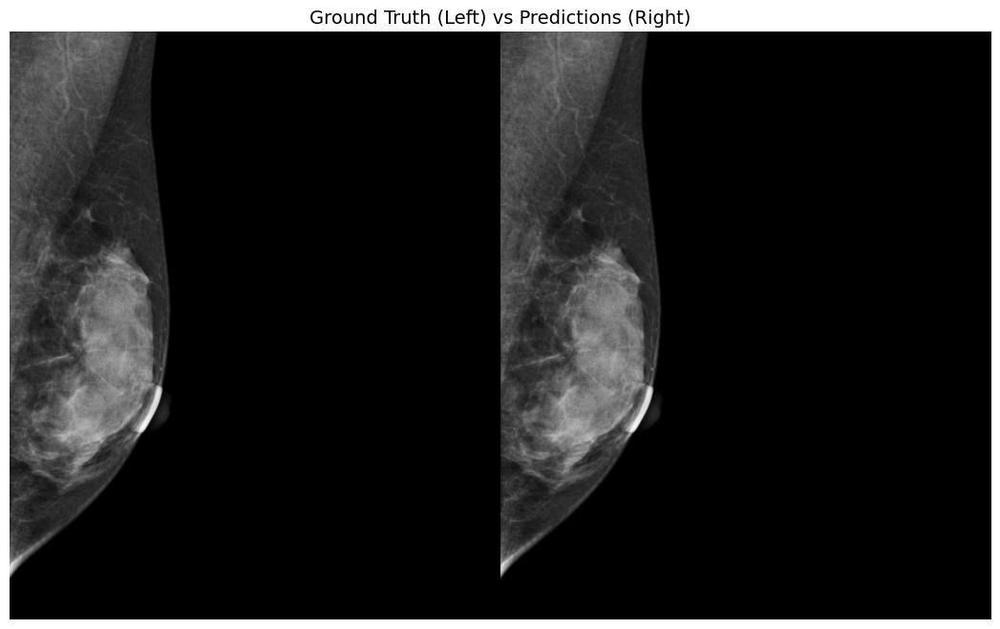


No ground truth masks available


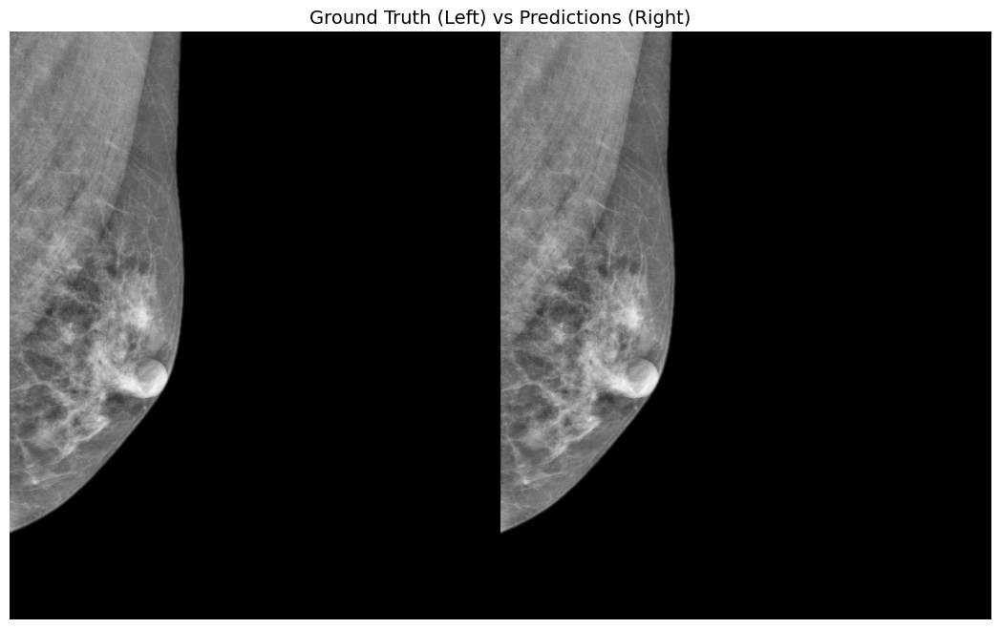


calc: No ground truth instances
mass: Avg IoU = 0.000 (0/1 matched)

Overall IoU: 0.000 (1 instances)


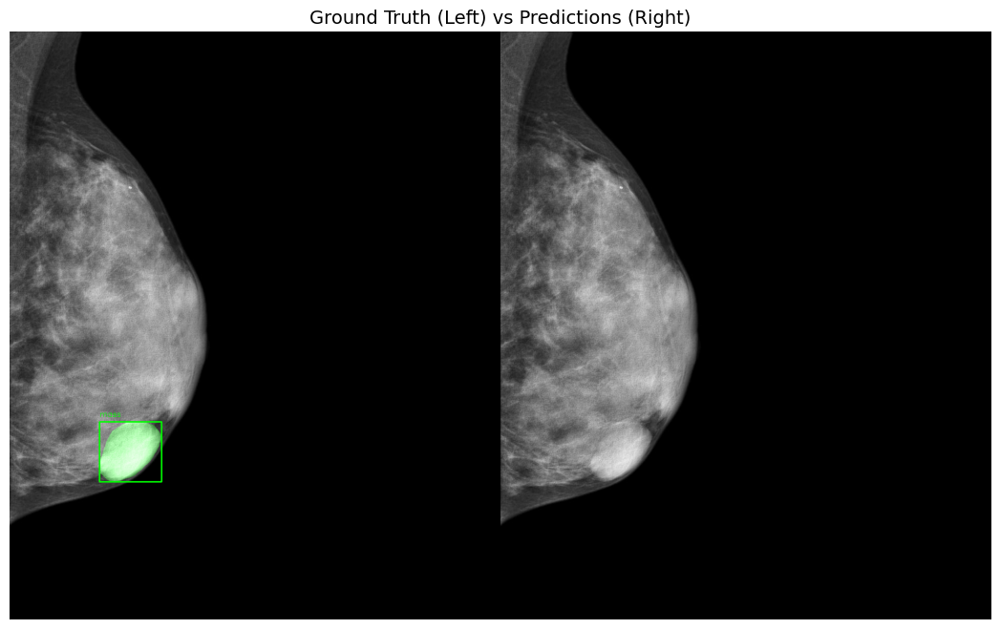


calc: No ground truth instances
mass: Avg IoU = 0.839 (1/1 matched)

Overall IoU: 0.839 (1 instances)


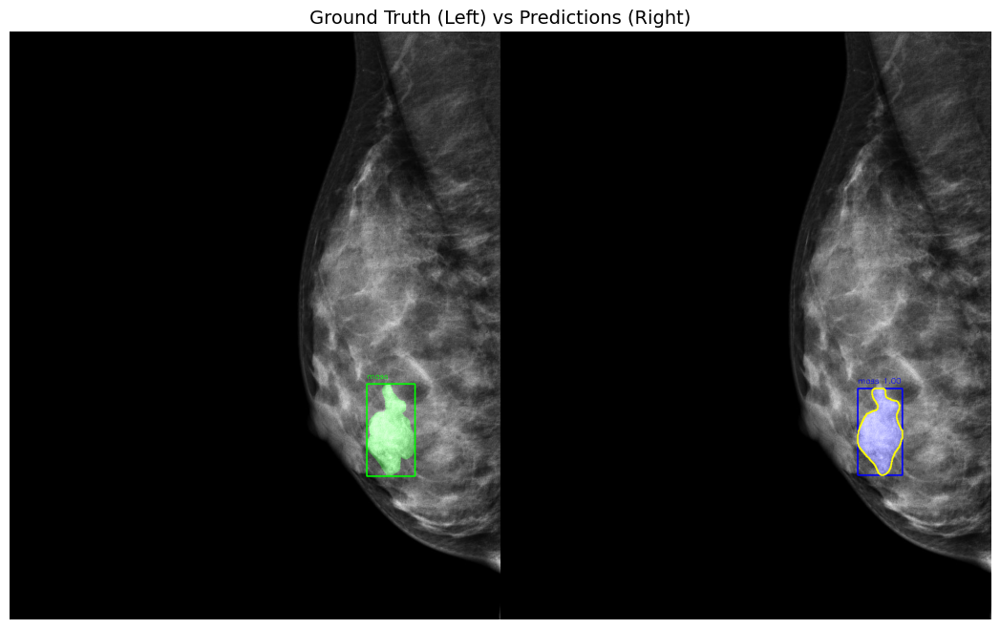


calc: No ground truth instances
mass: Avg IoU = 0.833 (1/1 matched)

Overall IoU: 0.833 (1 instances)


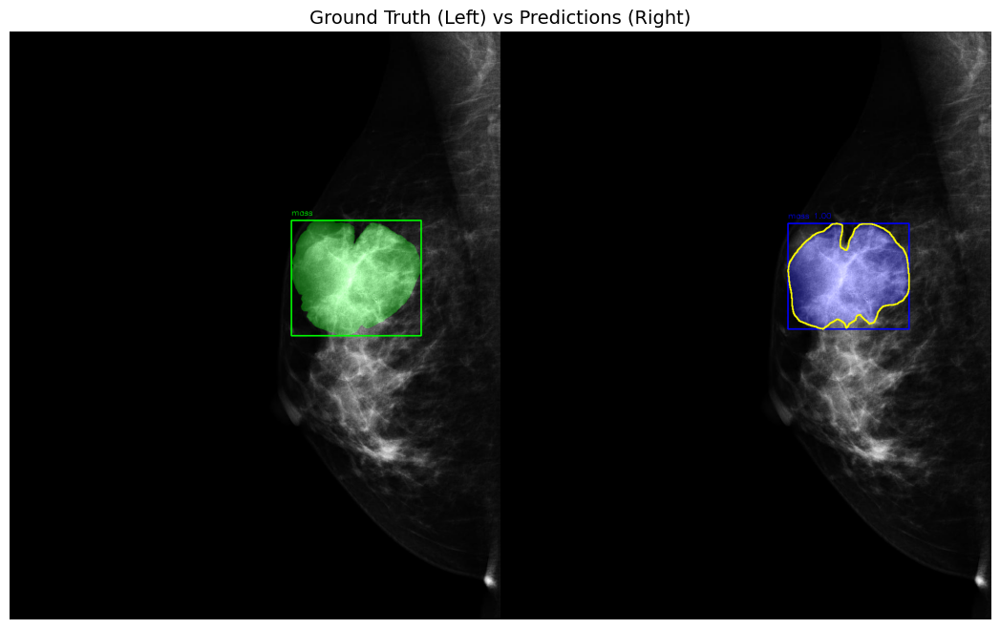


calc: No ground truth instances
mass: Avg IoU = 0.913 (1/1 matched)

Overall IoU: 0.913 (1 instances)


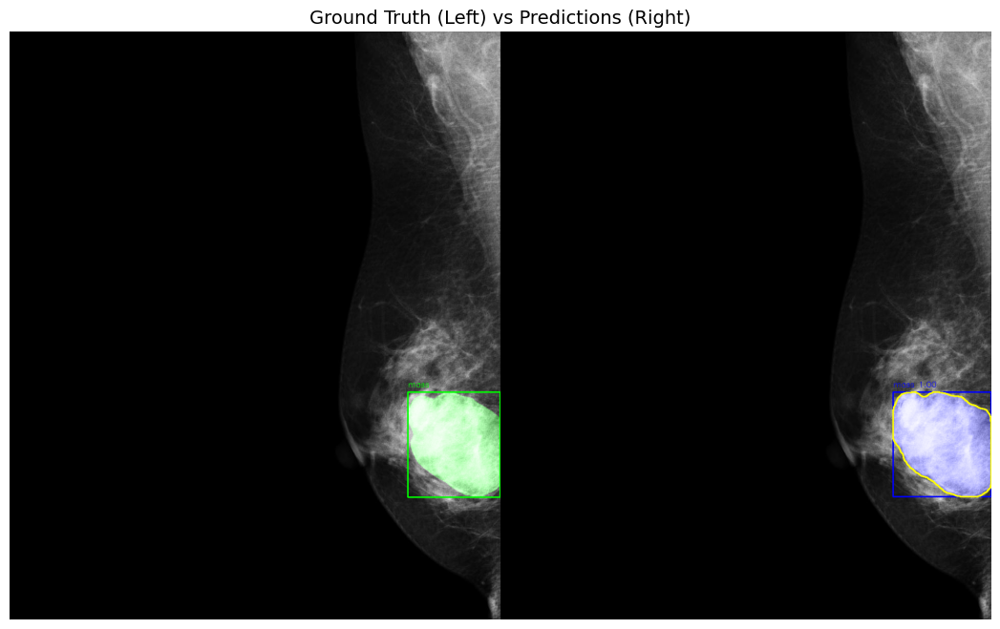


No ground truth masks available


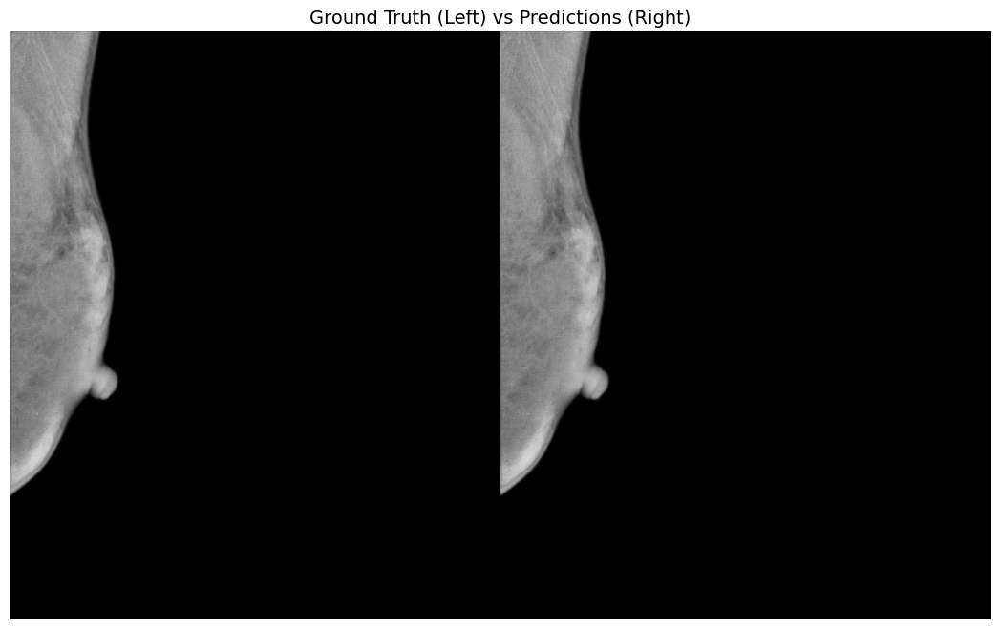


calc: No ground truth instances
mass: Avg IoU = 0.706 (1/1 matched)

Overall IoU: 0.706 (1 instances)


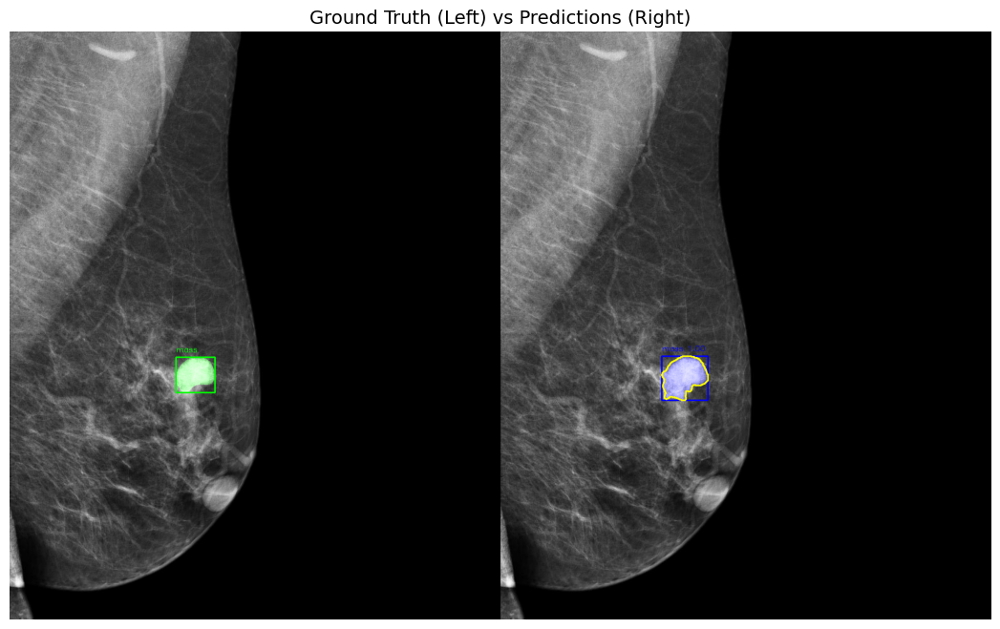


calc: Avg IoU = 0.638 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.638 (1 instances)


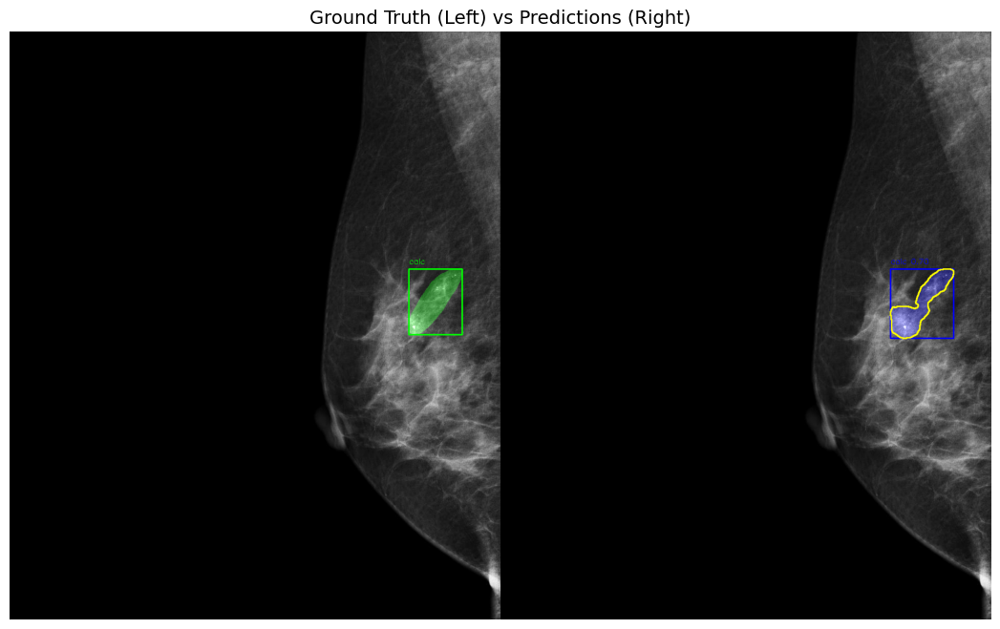


No ground truth masks available


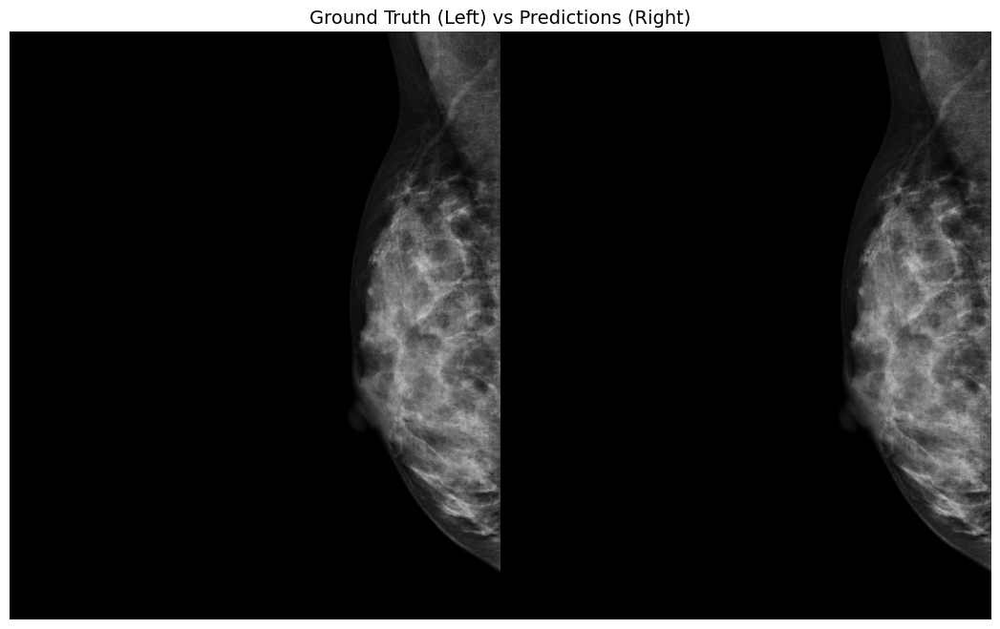


calc: No ground truth instances
mass: Avg IoU = 0.731 (1/1 matched)

Overall IoU: 0.731 (1 instances)


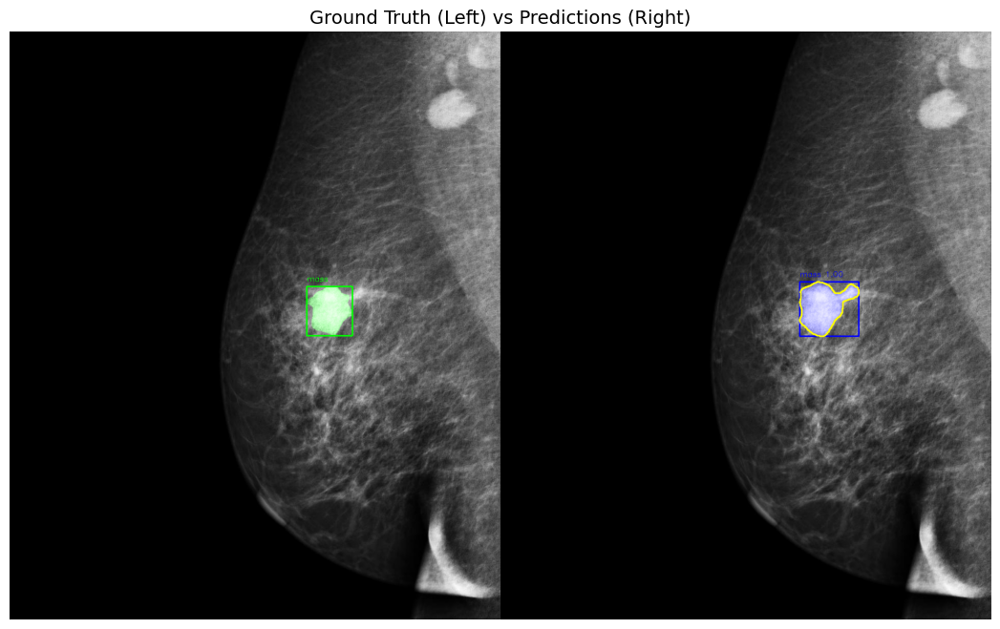


calc: No ground truth instances
mass: Avg IoU = 0.822 (1/1 matched)

Overall IoU: 0.822 (1 instances)


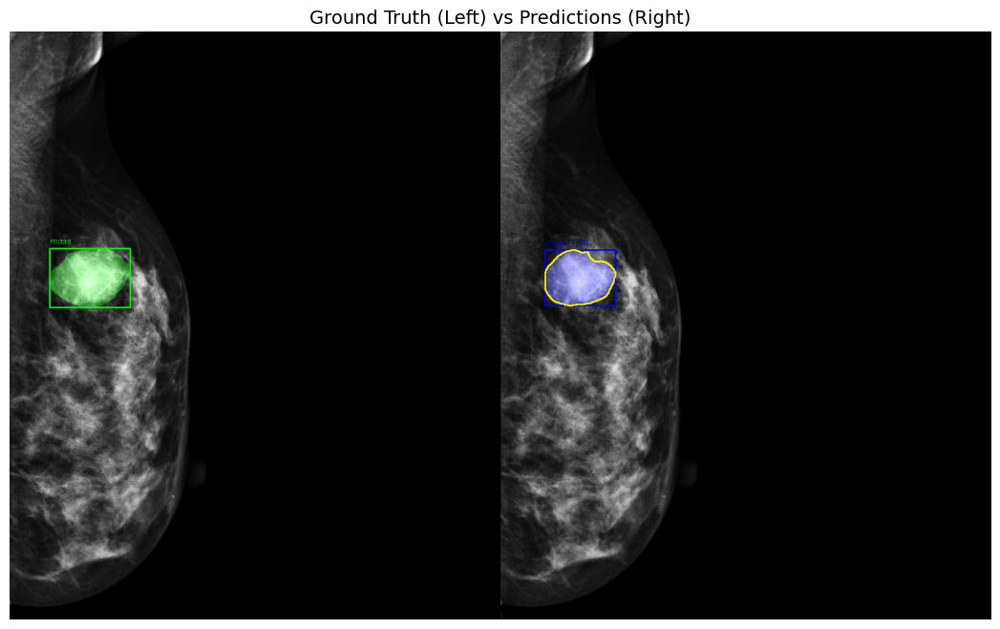


No ground truth masks available


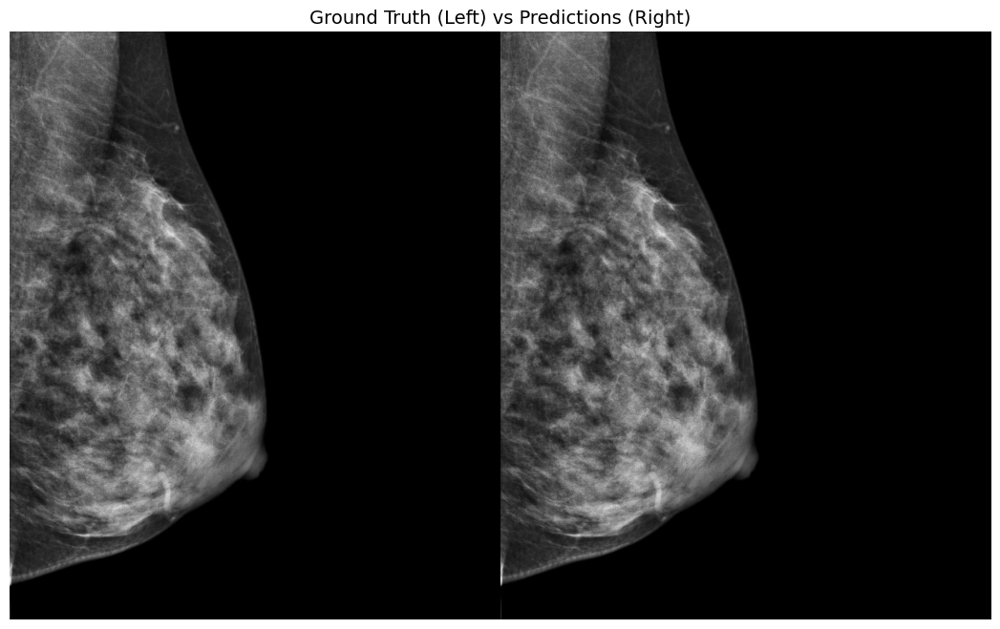


calc: Avg IoU = 0.721 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.721 (1 instances)


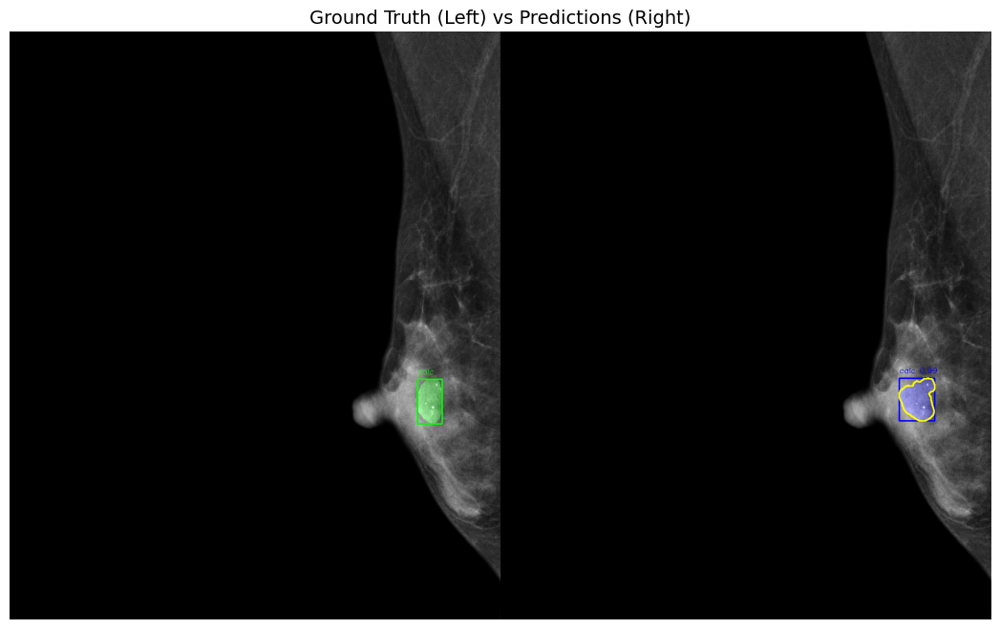


calc: No ground truth instances
mass: Avg IoU = 0.000 (0/1 matched)

Overall IoU: 0.000 (1 instances)


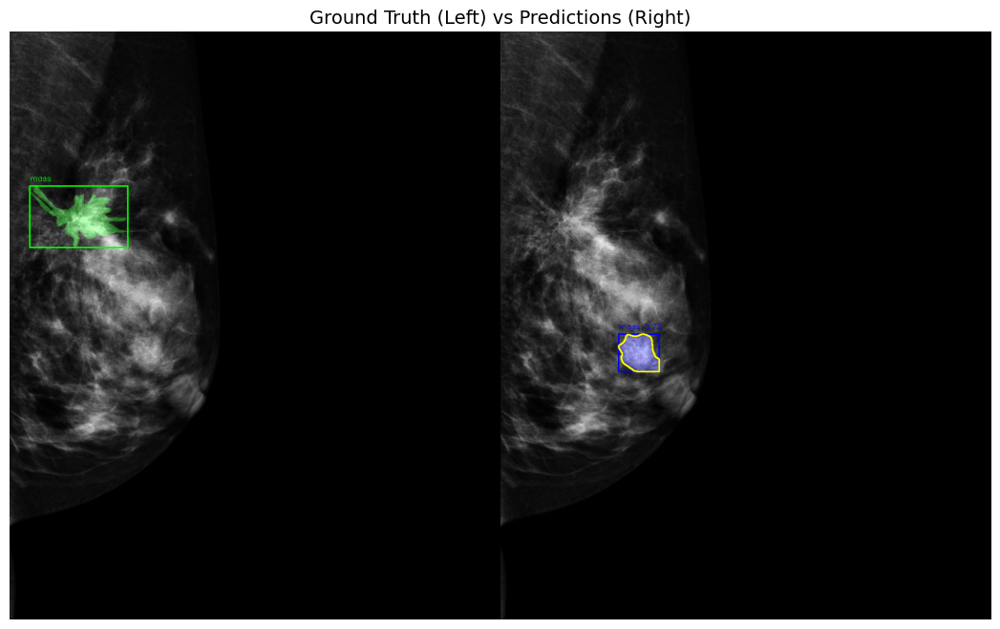


calc: Avg IoU = 0.000 (0/1 matched)
mass: Avg IoU = 0.723 (1/1 matched)

Overall IoU: 0.362 (2 instances)


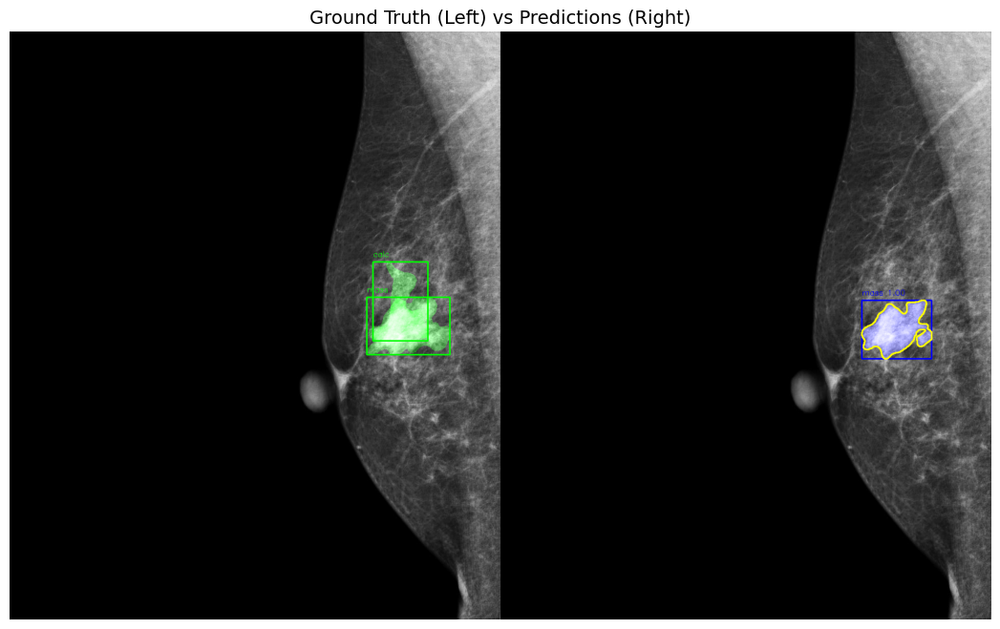


calc: No ground truth instances
mass: Avg IoU = 0.804 (1/1 matched)

Overall IoU: 0.804 (1 instances)


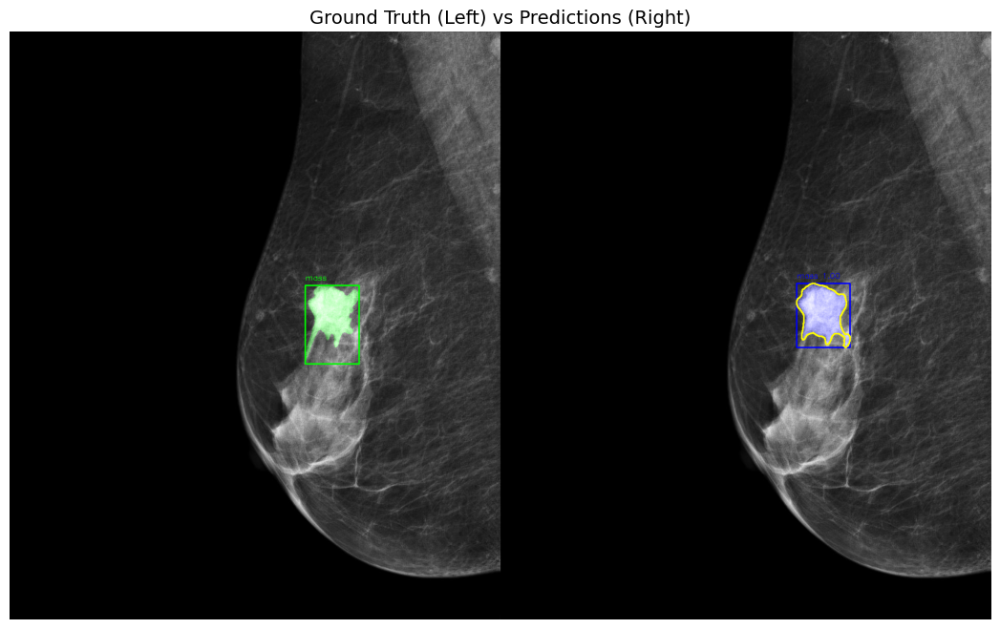


calc: Avg IoU = 0.000 (0/1 matched)
mass: Avg IoU = 0.687 (1/1 matched)

Overall IoU: 0.344 (2 instances)


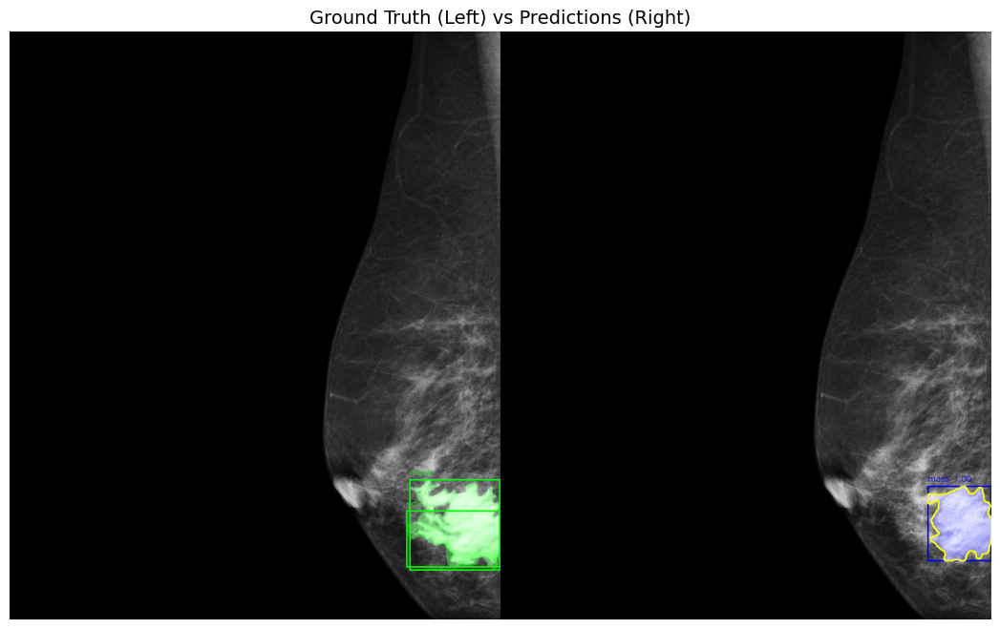


calc: Avg IoU = 0.000 (0/1 matched)
mass: Avg IoU = 0.780 (1/1 matched)

Overall IoU: 0.390 (2 instances)


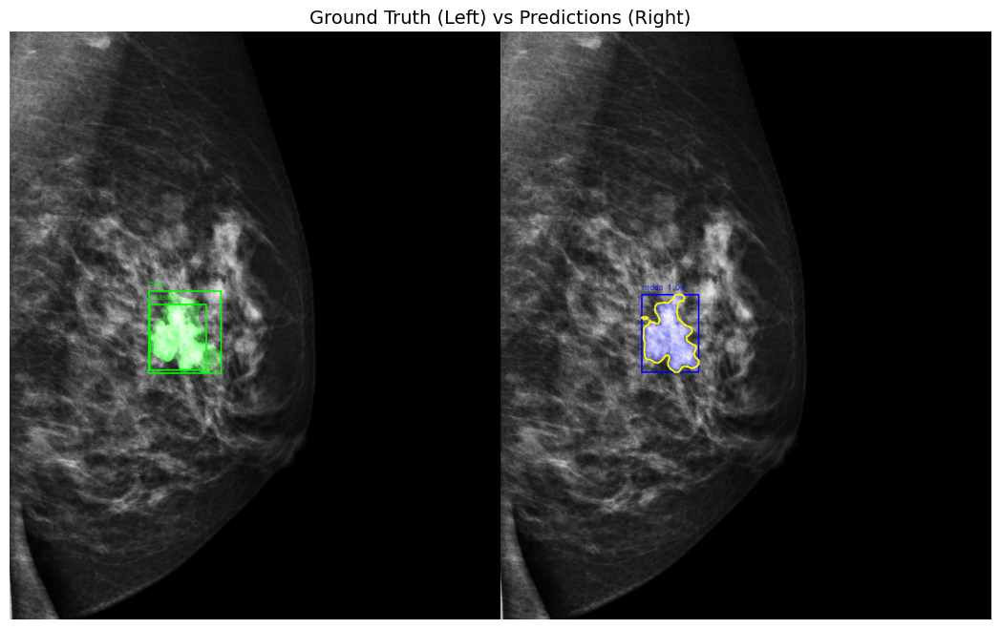


No ground truth masks available


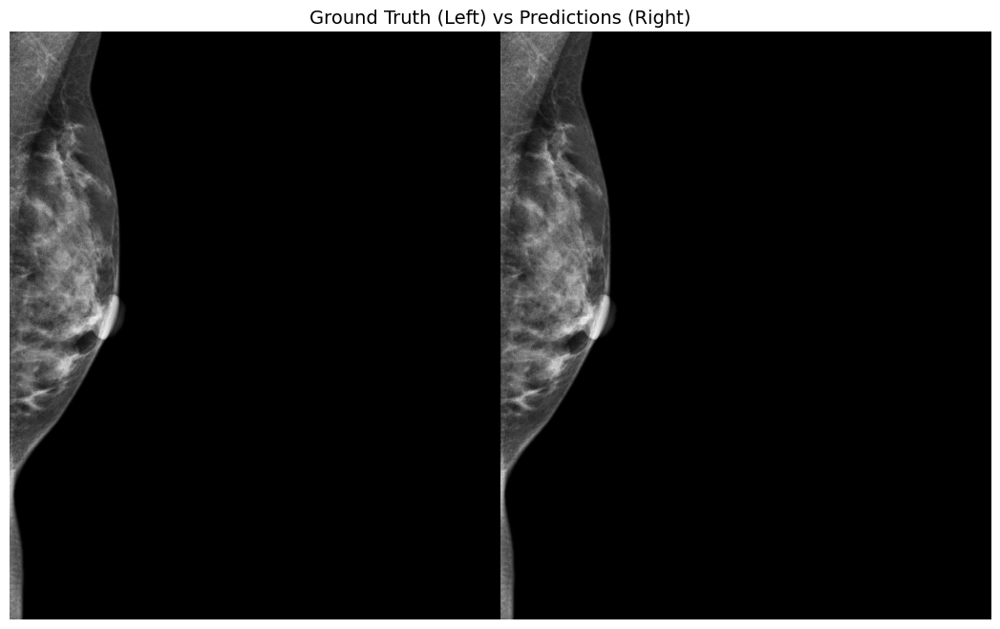


calc: Avg IoU = 0.608 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.608 (1 instances)


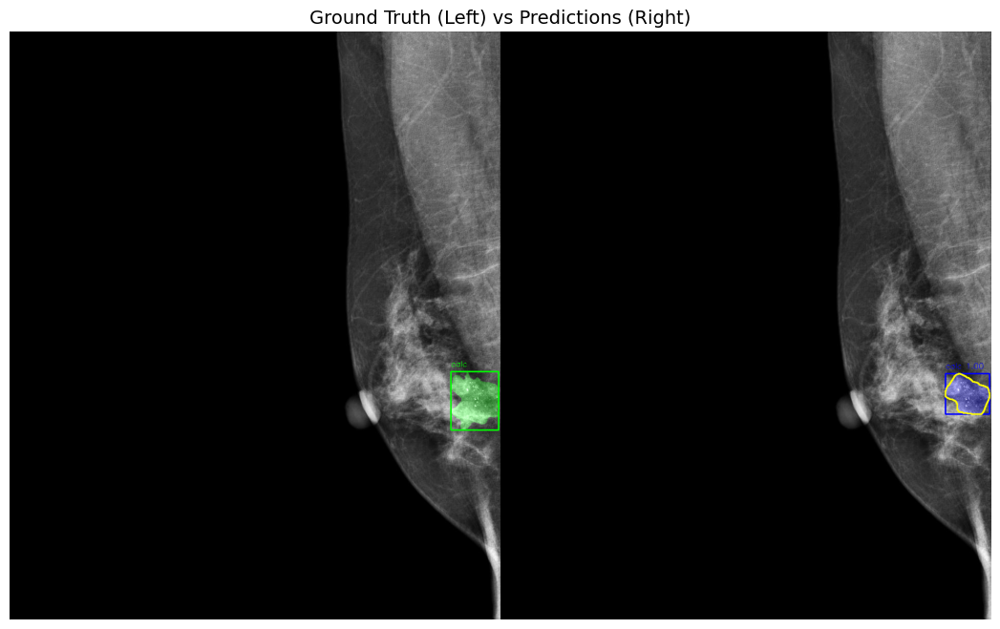


calc: No ground truth instances
mass: Avg IoU = 0.851 (1/1 matched)

Overall IoU: 0.851 (1 instances)


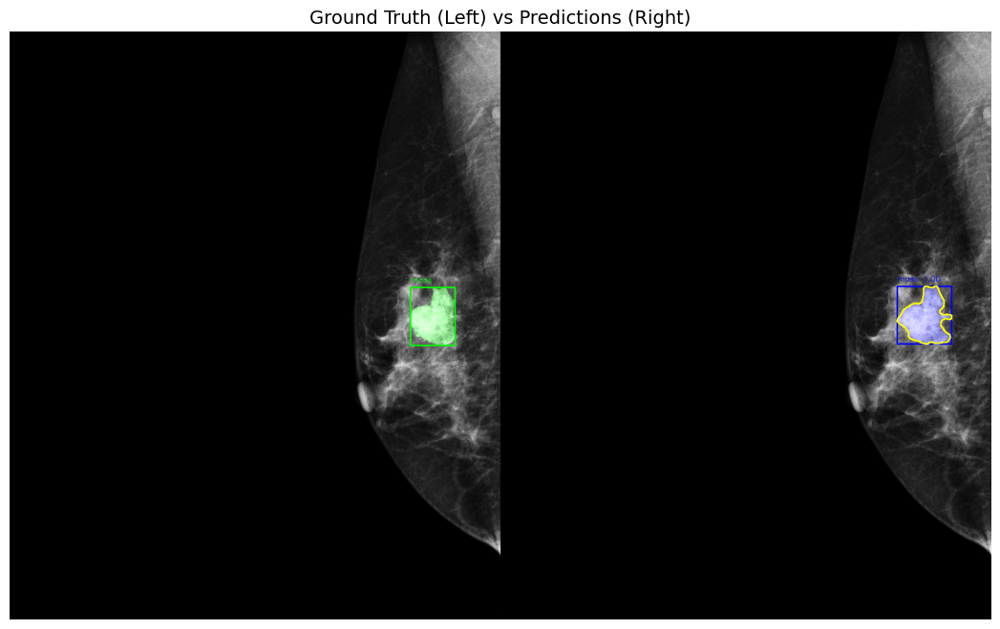


calc: No ground truth instances
mass: Avg IoU = 0.845 (1/1 matched)

Overall IoU: 0.845 (1 instances)


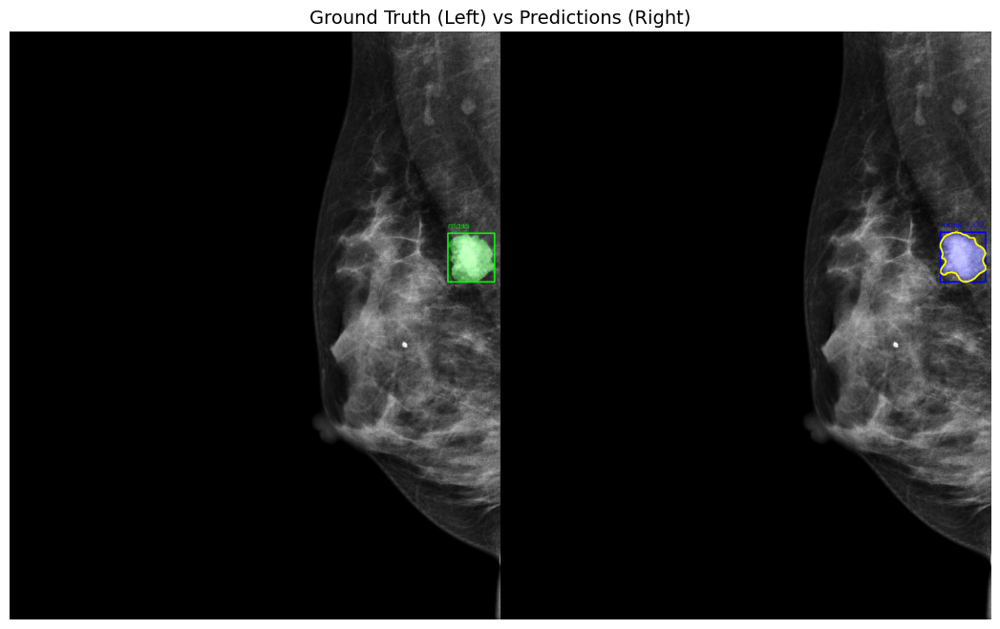


No ground truth masks available


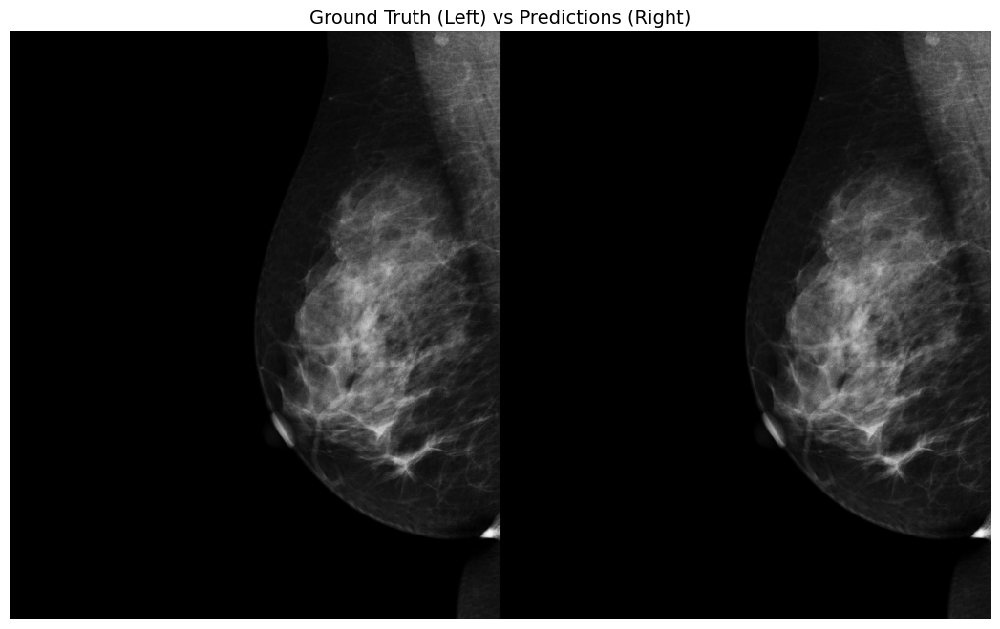


calc: No ground truth instances
mass: Avg IoU = 0.808 (1/1 matched)

Overall IoU: 0.808 (1 instances)


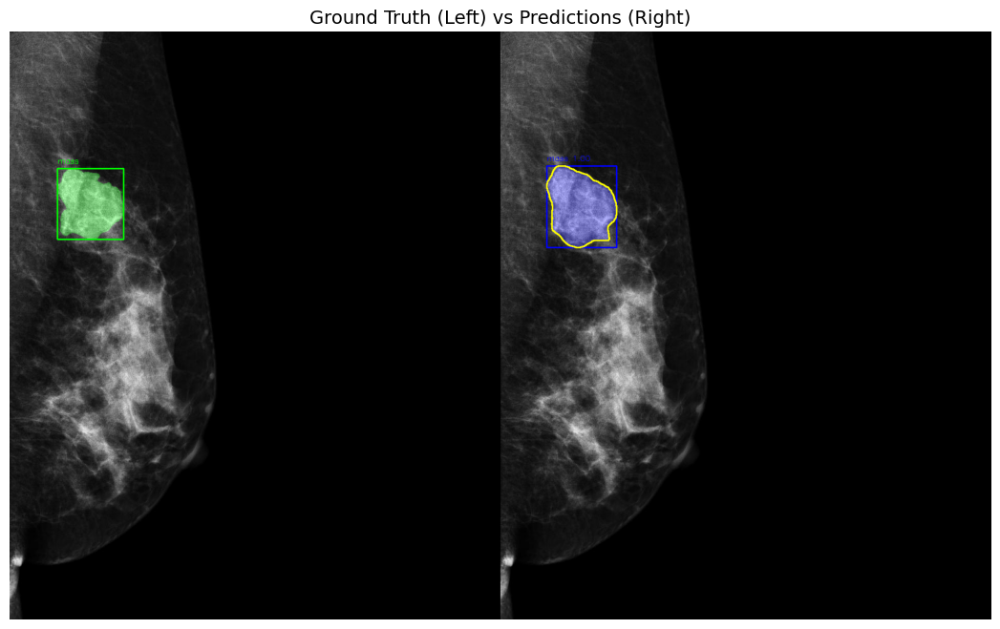


calc: No ground truth instances
mass: Avg IoU = 0.000 (0/1 matched)

Overall IoU: 0.000 (1 instances)


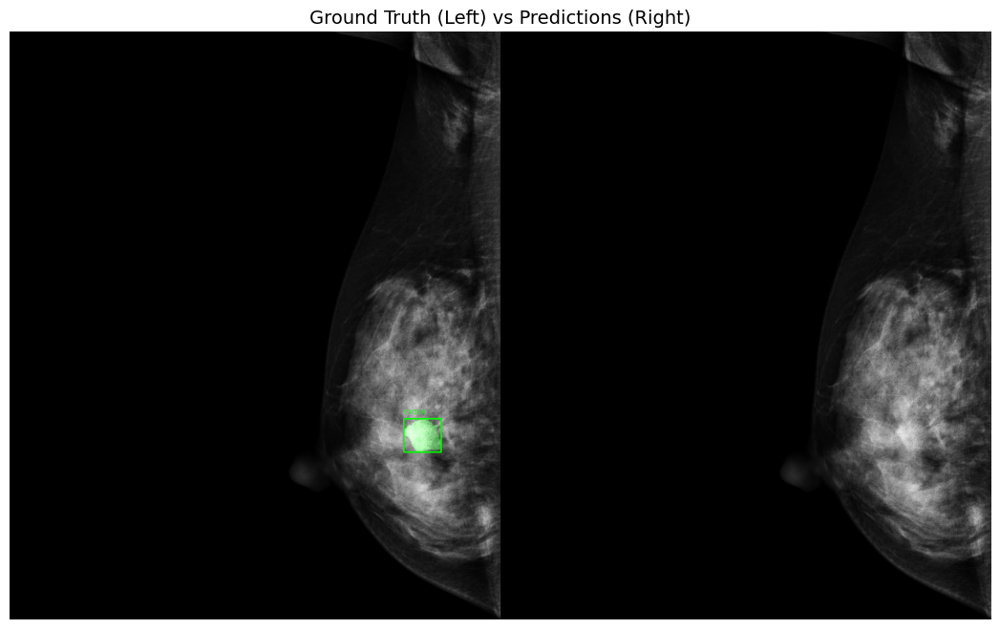


No ground truth masks available


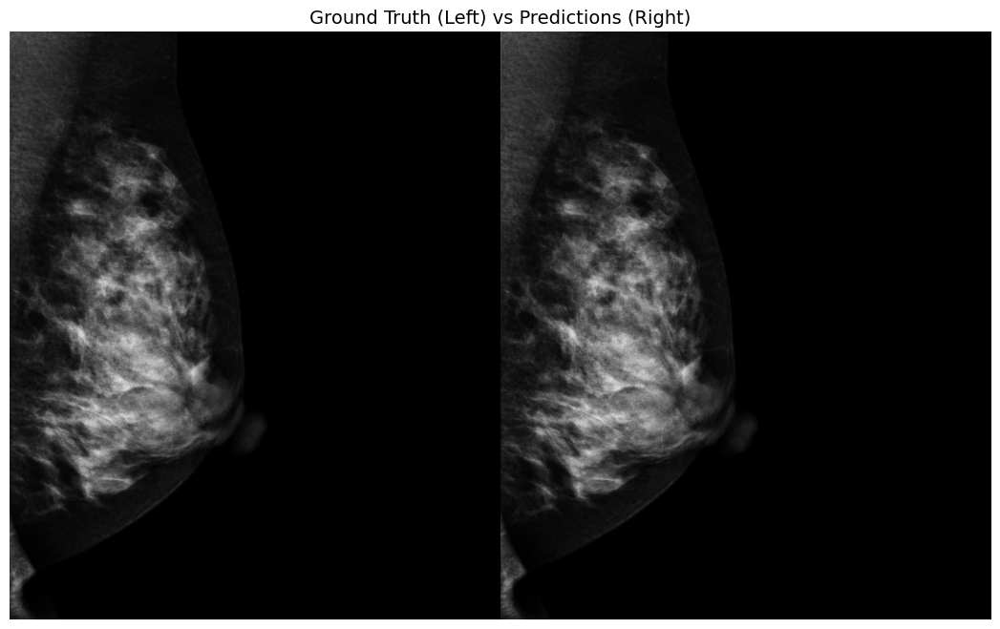


calc: Avg IoU = 0.355 (1/1 matched)
mass: Avg IoU = 0.812 (1/1 matched)

Overall IoU: 0.584 (2 instances)


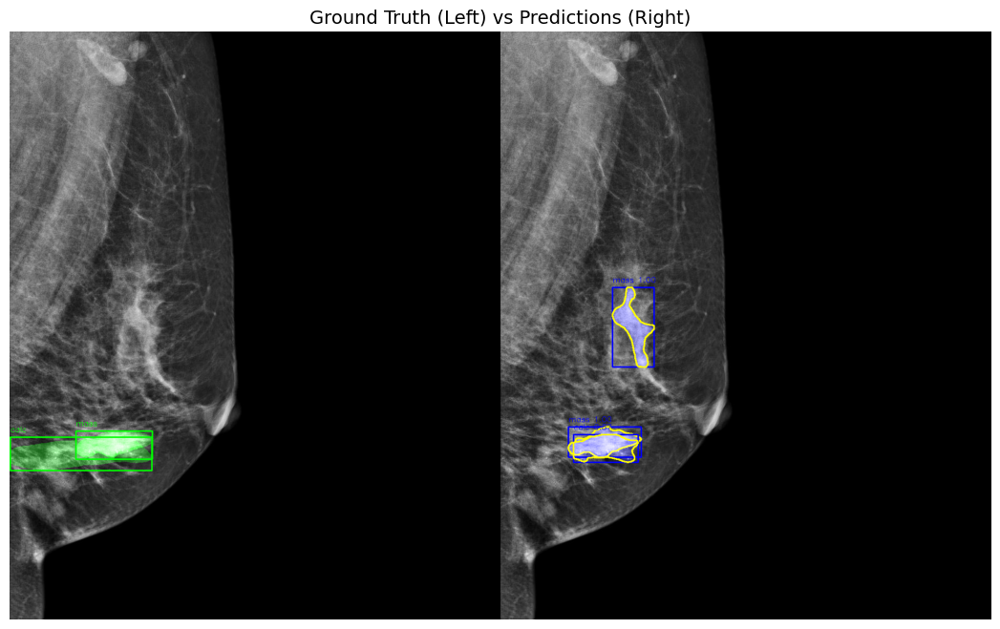


No ground truth masks available


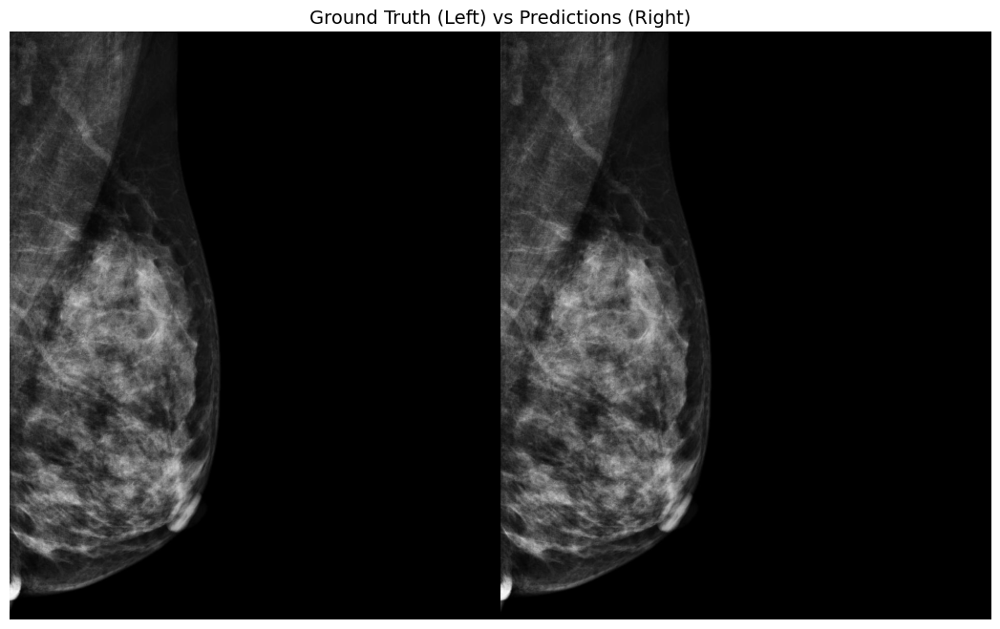


calc: Avg IoU = 0.731 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.731 (1 instances)


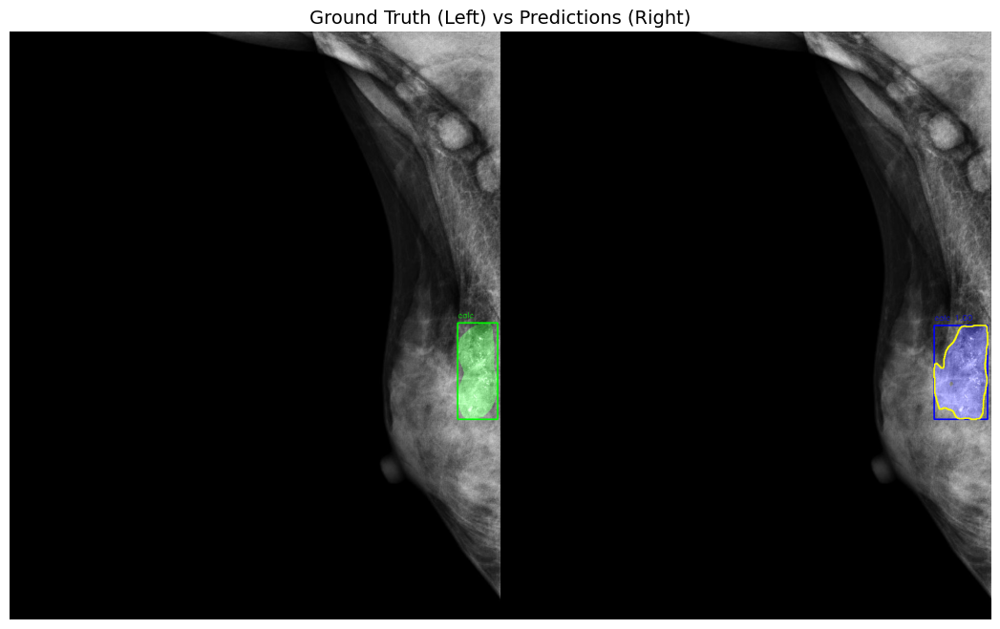


calc: No ground truth instances
mass: Avg IoU = 0.890 (1/1 matched)

Overall IoU: 0.890 (1 instances)


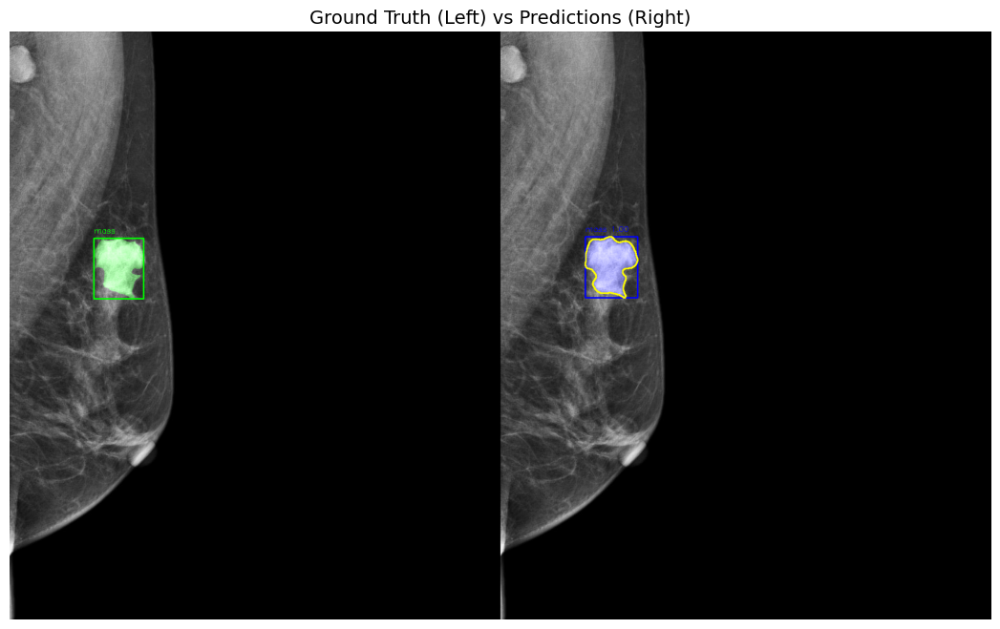


No ground truth masks available


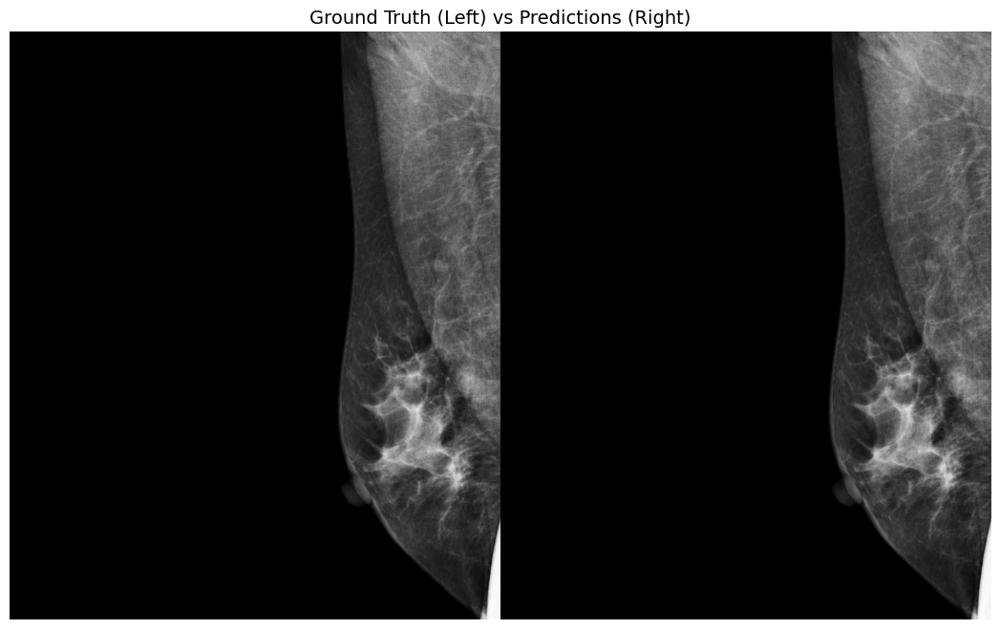


calc: No ground truth instances
mass: Avg IoU = 0.699 (1/1 matched)

Overall IoU: 0.699 (1 instances)


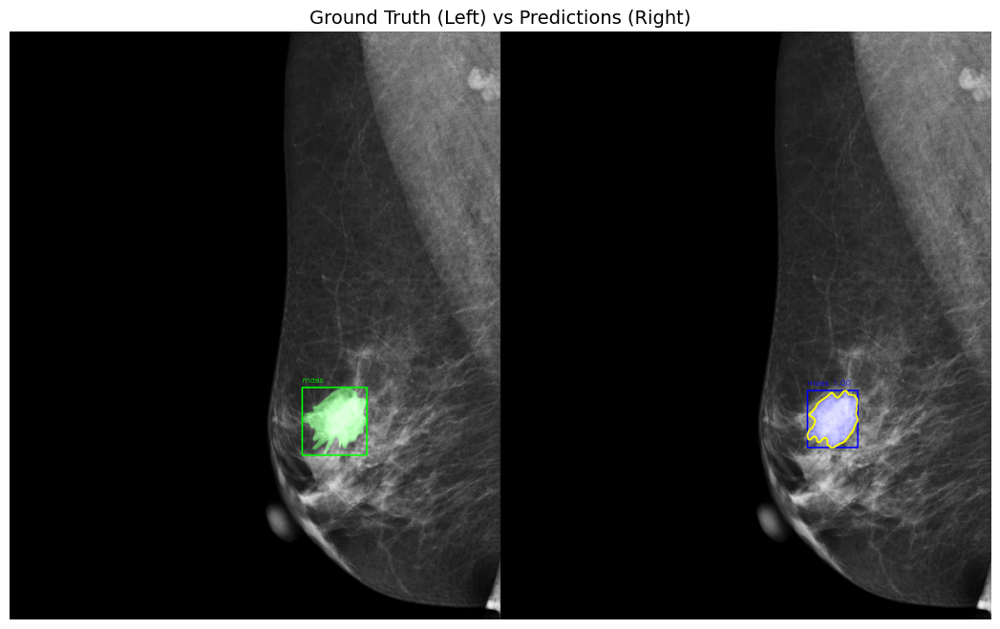


calc: Avg IoU = 0.522 (1/1 matched)
mass: Avg IoU = 0.397 (1/1 matched)

Overall IoU: 0.460 (2 instances)


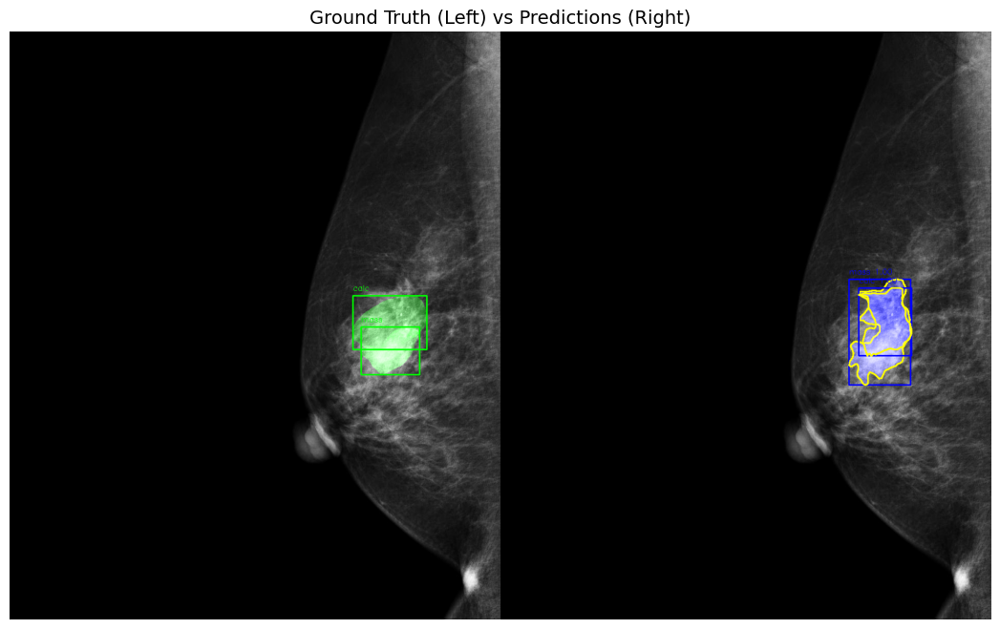


calc: No ground truth instances
mass: Avg IoU = 0.685 (1/1 matched)

Overall IoU: 0.685 (1 instances)


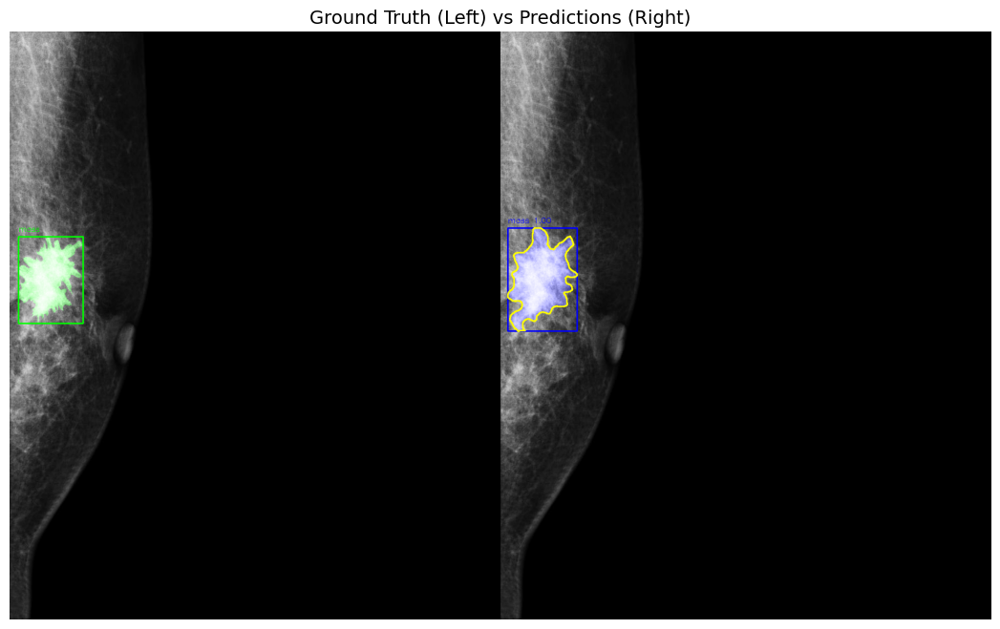


calc: No ground truth instances
mass: Avg IoU = 0.771 (1/1 matched)

Overall IoU: 0.771 (1 instances)


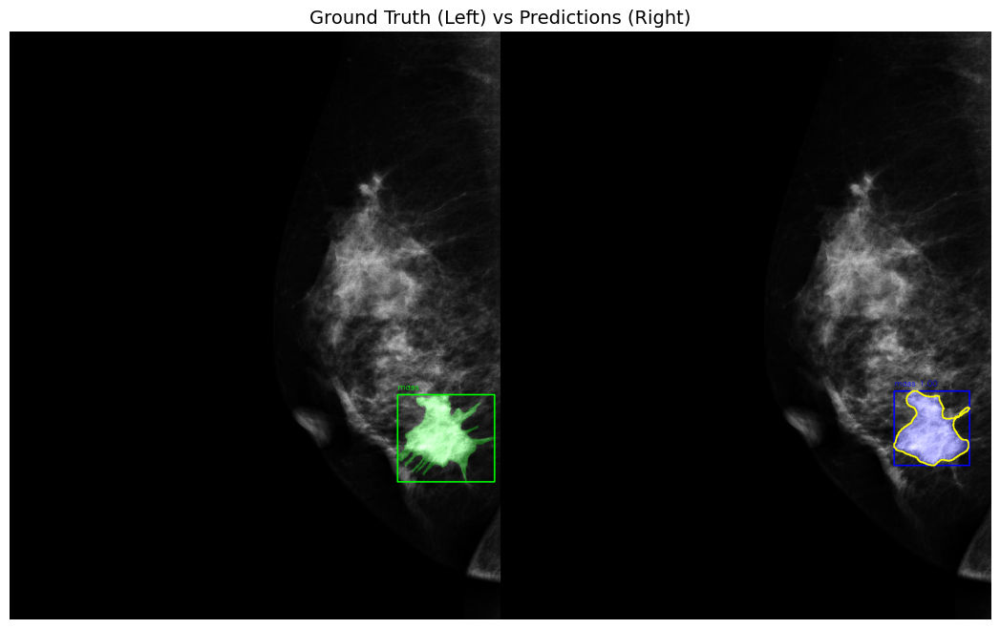


calc: No ground truth instances
mass: Avg IoU = 0.359 (1/1 matched)

Overall IoU: 0.359 (1 instances)


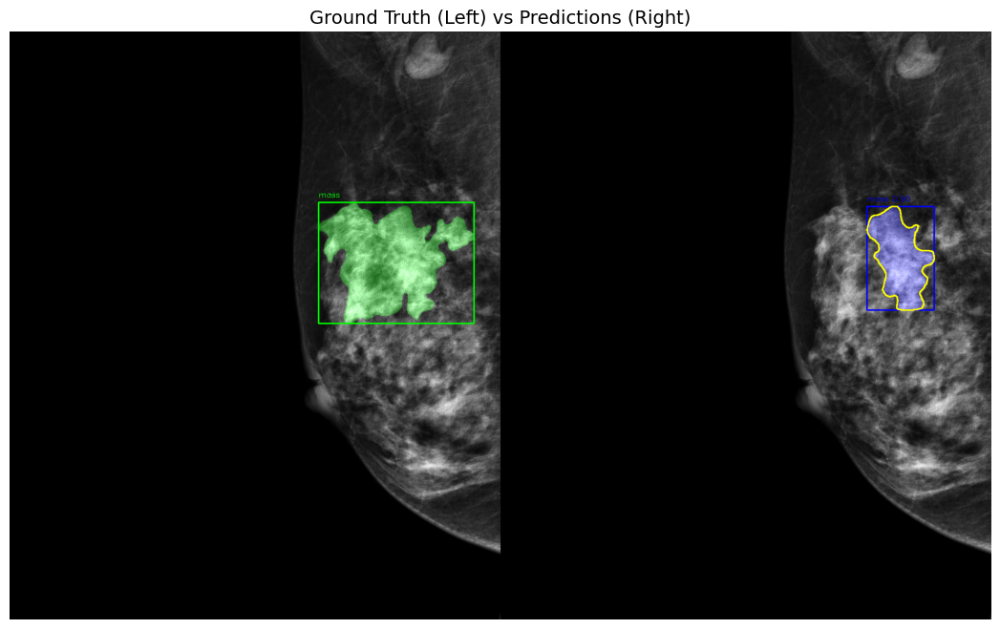


calc: Avg IoU = 0.536 (1/1 matched)
mass: Avg IoU = 0.000 (0/1 matched)

Overall IoU: 0.268 (2 instances)


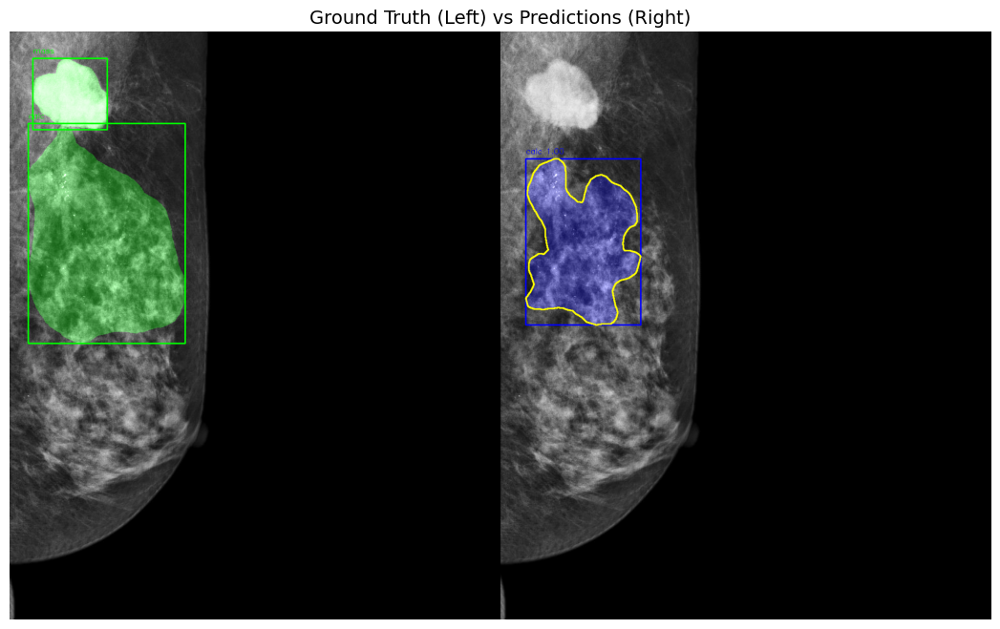


calc: Avg IoU = 0.000 (0/1 matched)
mass: Avg IoU = 0.843 (1/1 matched)

Overall IoU: 0.421 (2 instances)


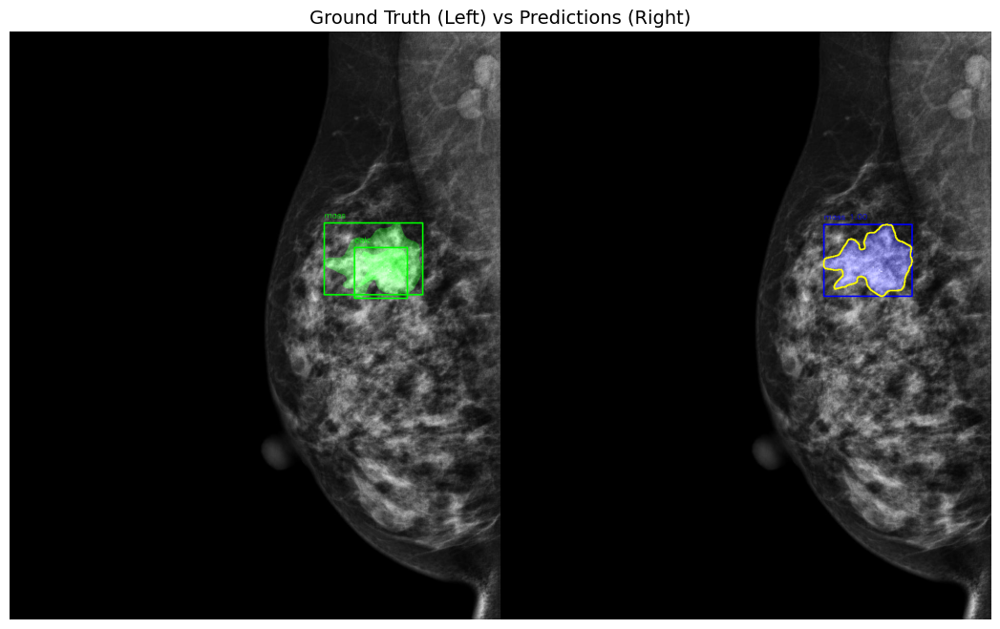


No ground truth masks available


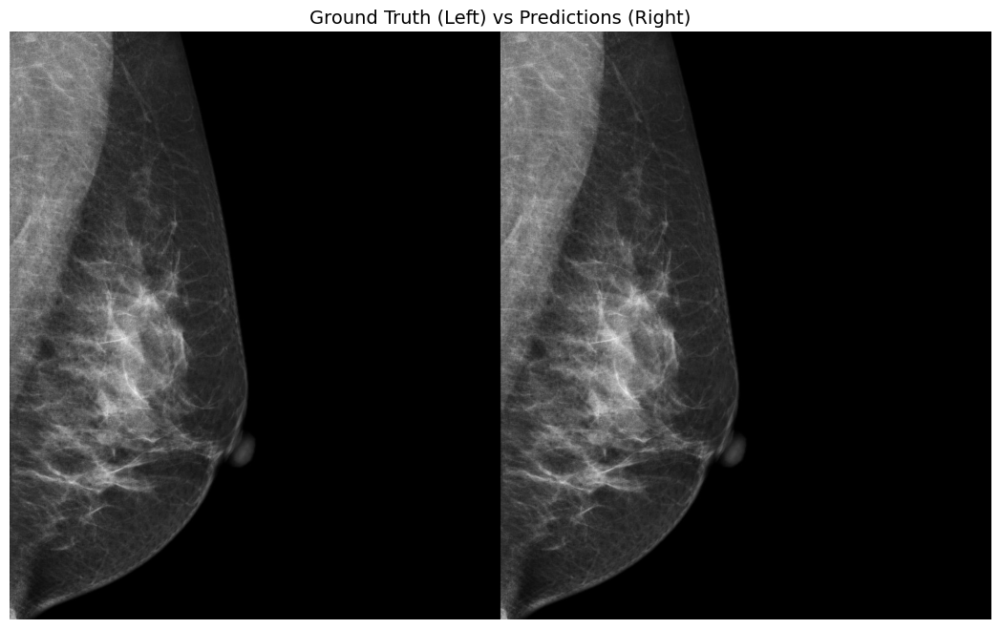


calc: No ground truth instances
mass: Avg IoU = 0.792 (1/1 matched)

Overall IoU: 0.792 (1 instances)


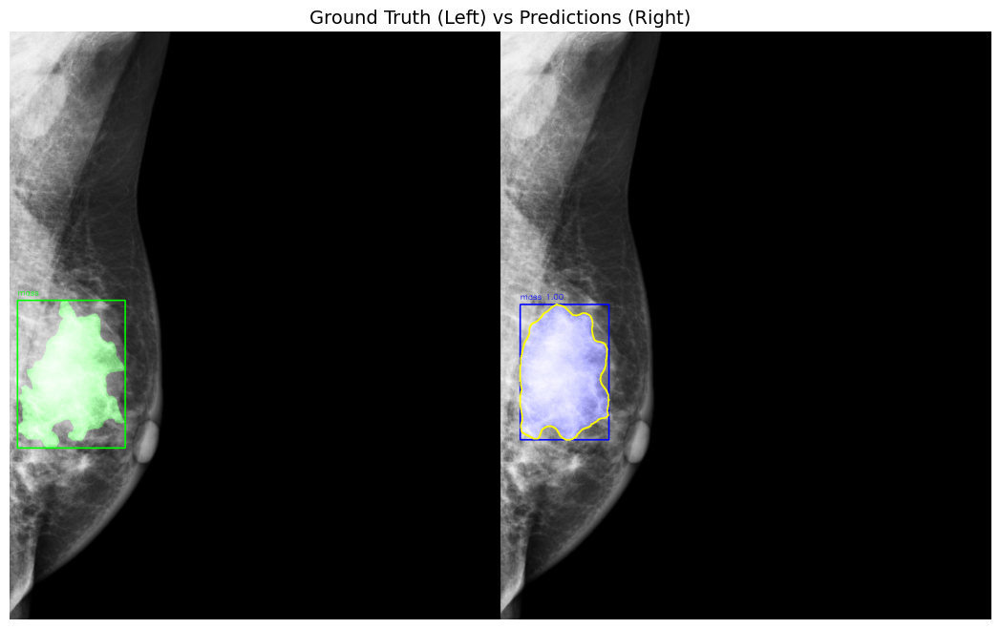


calc: Avg IoU = 0.311 (1/1 matched)
mass: Avg IoU = 0.245 (1/1 matched)

Overall IoU: 0.278 (2 instances)


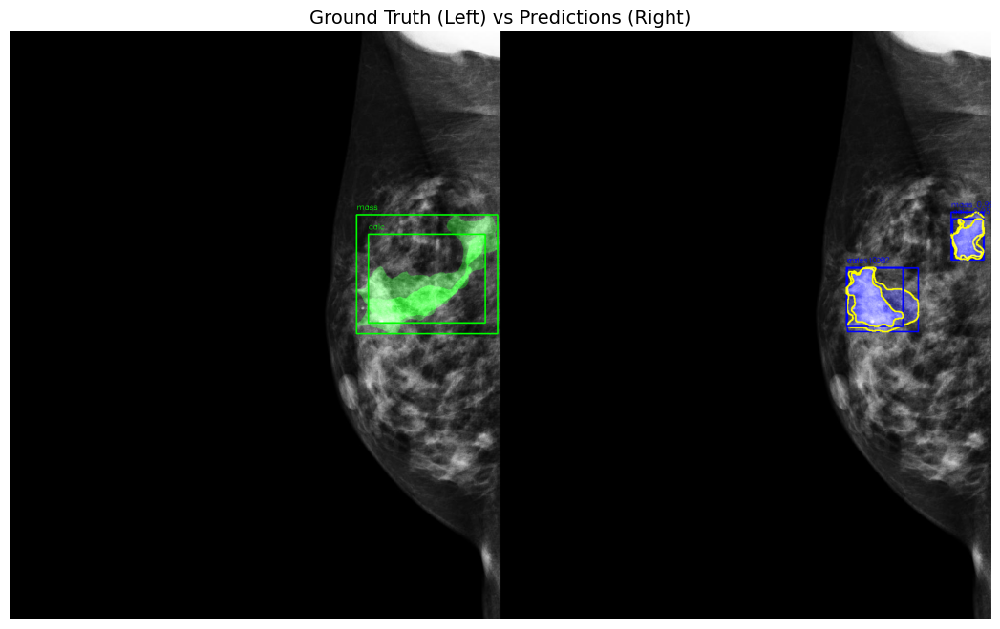


No ground truth masks available


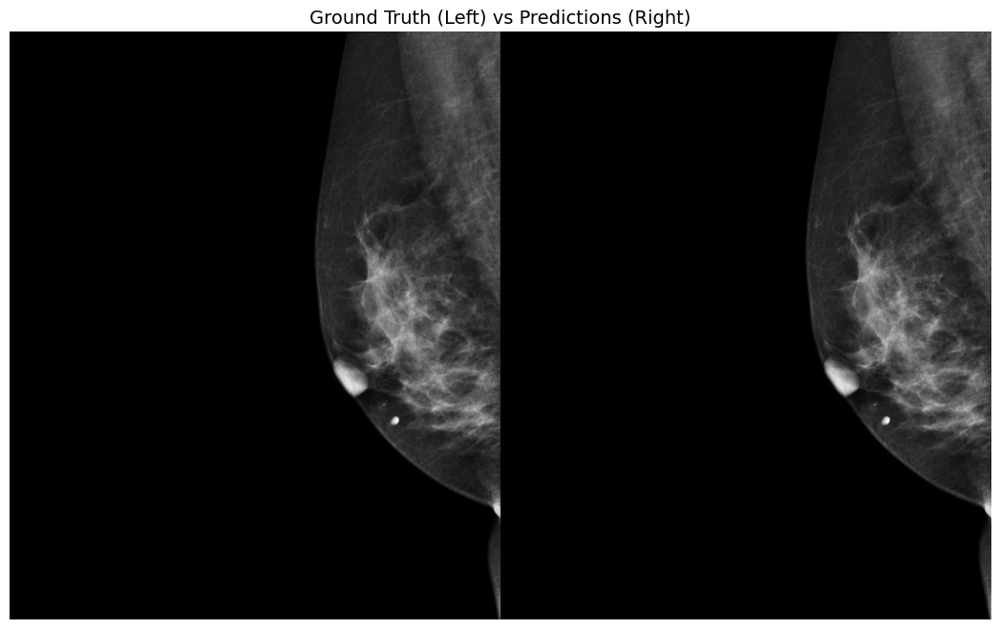


calc: No ground truth instances
mass: Avg IoU = 0.634 (1/1 matched)

Overall IoU: 0.634 (1 instances)


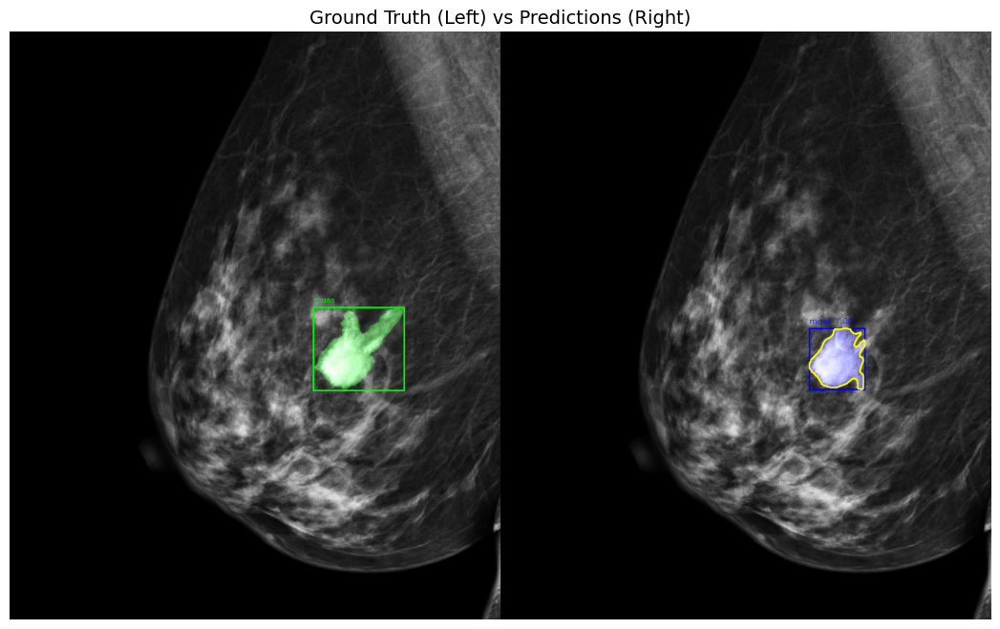


No ground truth masks available


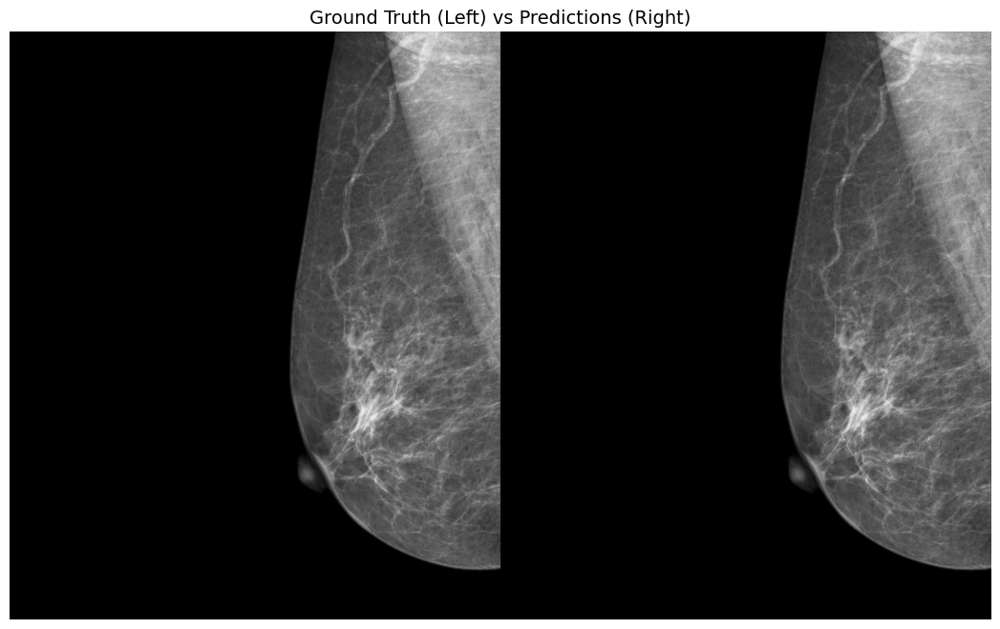


calc: No ground truth instances
mass: Avg IoU = 0.809 (1/1 matched)

Overall IoU: 0.809 (1 instances)


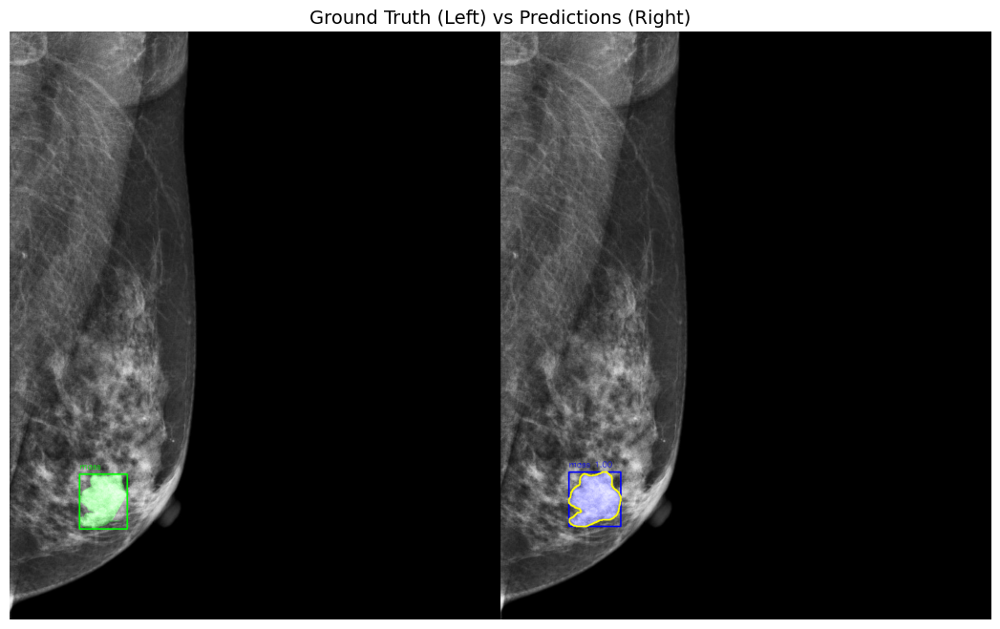


No ground truth masks available


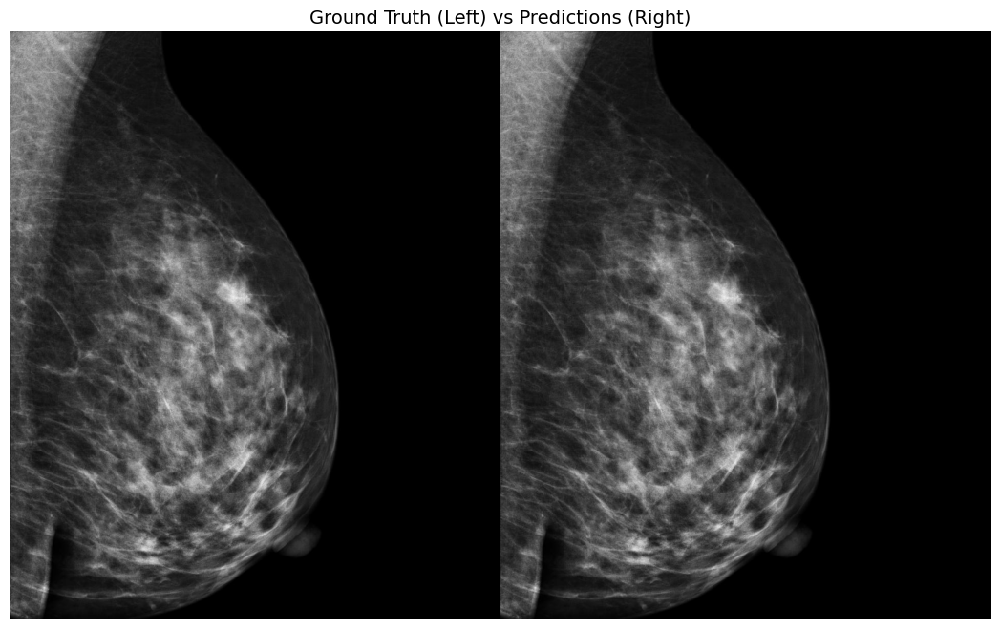


calc: Avg IoU = 0.000 (0/1 matched)
mass: Avg IoU = 0.723 (1/1 matched)

Overall IoU: 0.361 (2 instances)


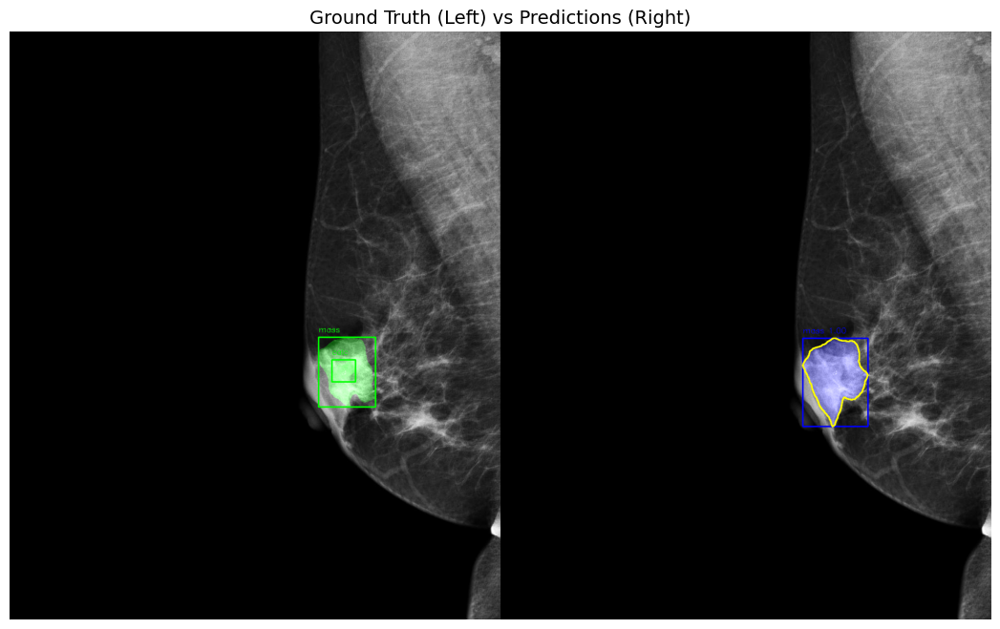


calc: No ground truth instances
mass: Avg IoU = 0.810 (1/1 matched)

Overall IoU: 0.810 (1 instances)


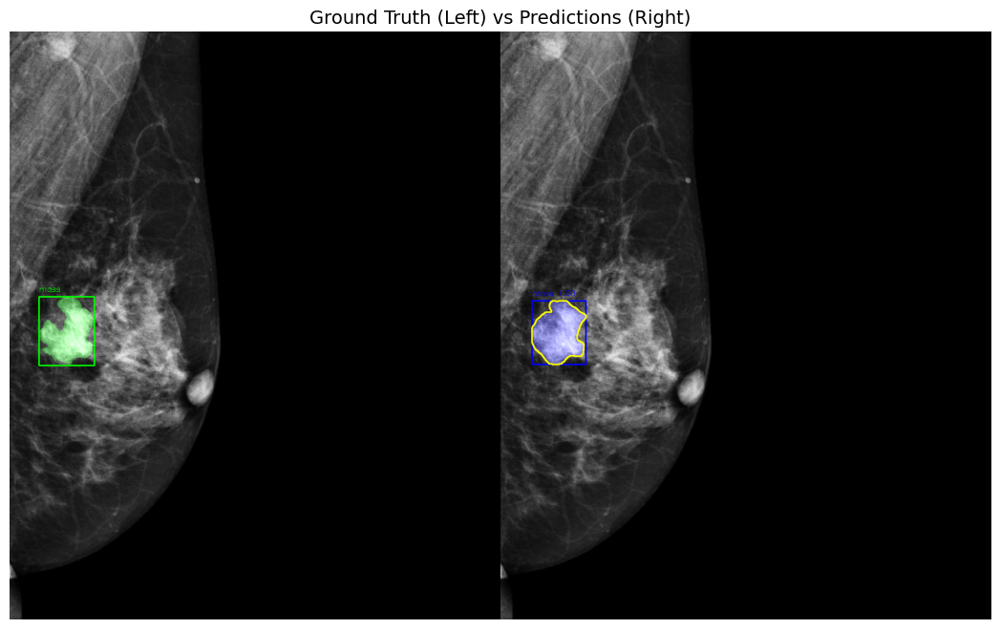


calc: No ground truth instances
mass: Avg IoU = 0.779 (1/1 matched)

Overall IoU: 0.779 (1 instances)


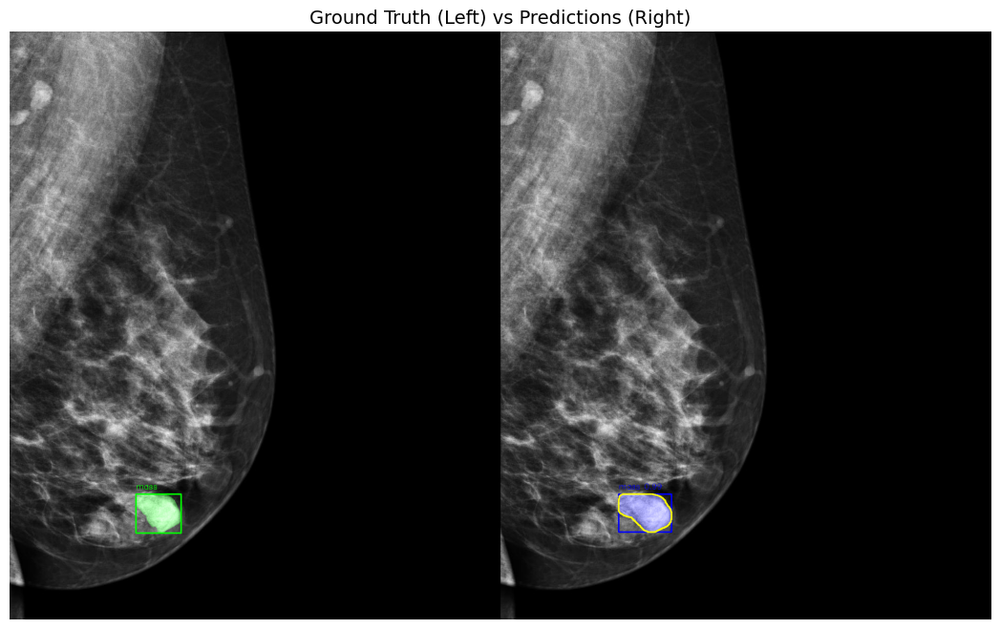


No ground truth masks available


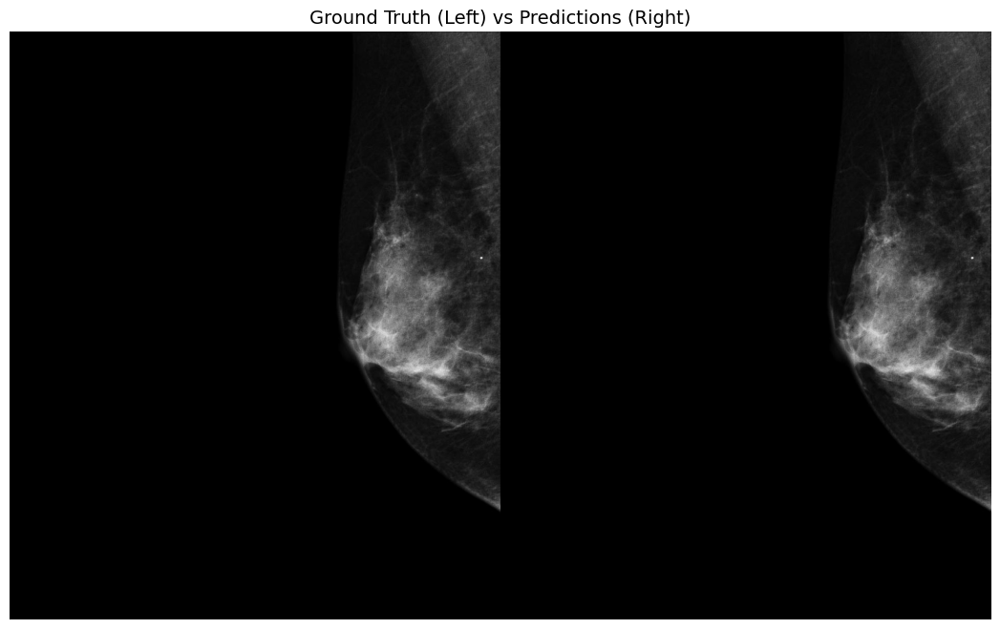


calc: Avg IoU = 0.451 (2/3 matched)
mass: Avg IoU = 0.834 (1/1 matched)

Overall IoU: 0.547 (4 instances)


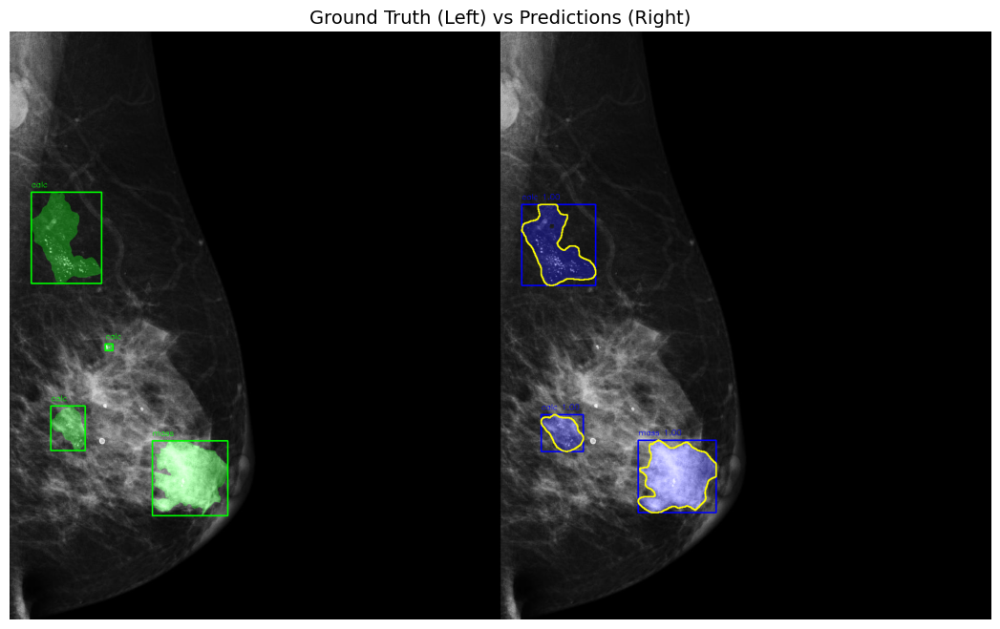


calc: Avg IoU = 0.000 (0/1 matched)
mass: No ground truth instances

Overall IoU: 0.000 (1 instances)


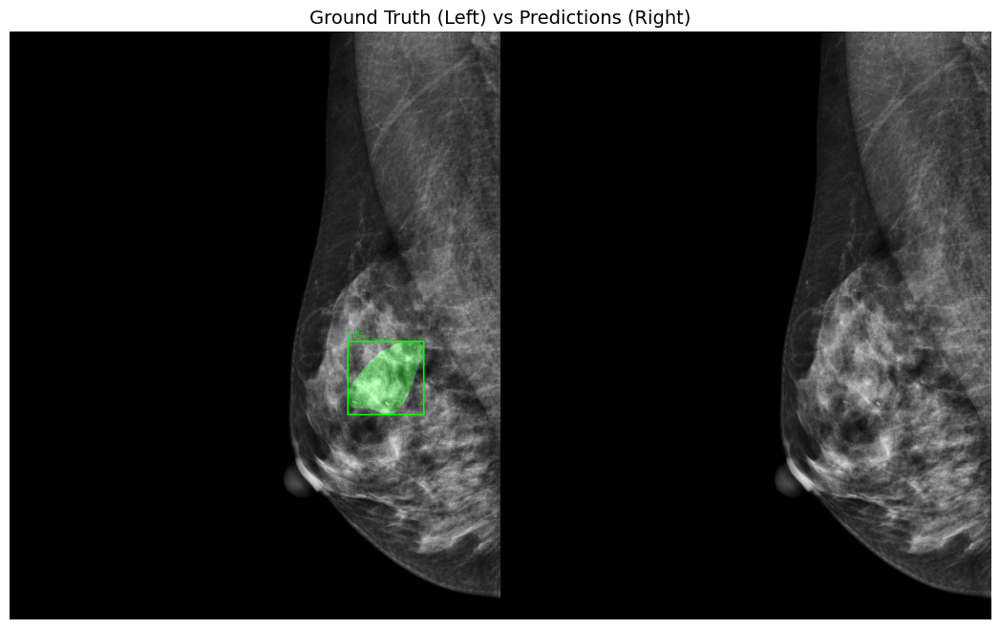


calc: No ground truth instances
mass: Avg IoU = 0.525 (1/1 matched)

Overall IoU: 0.525 (1 instances)


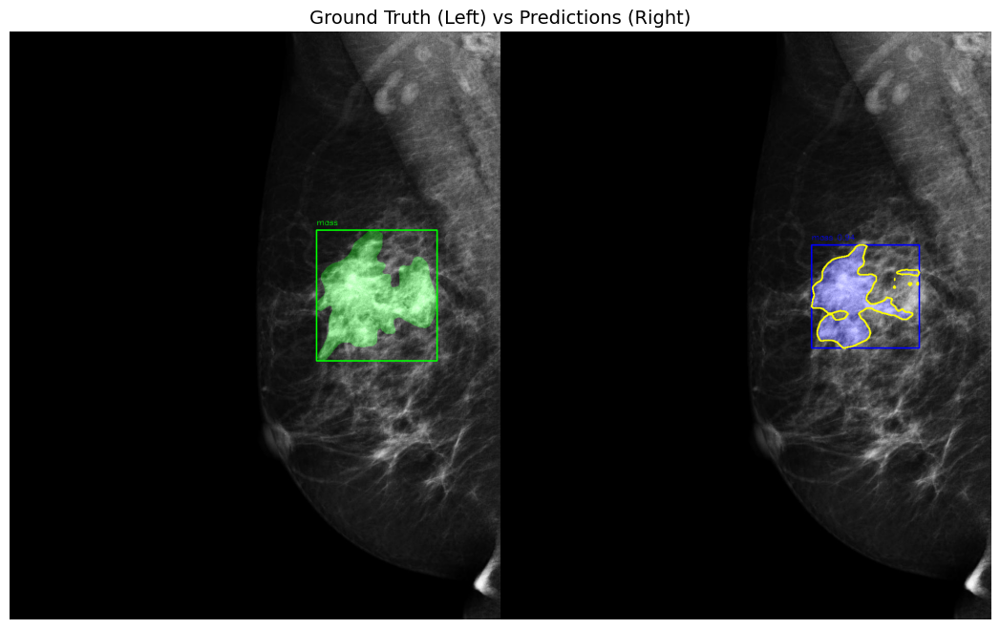


No ground truth masks available


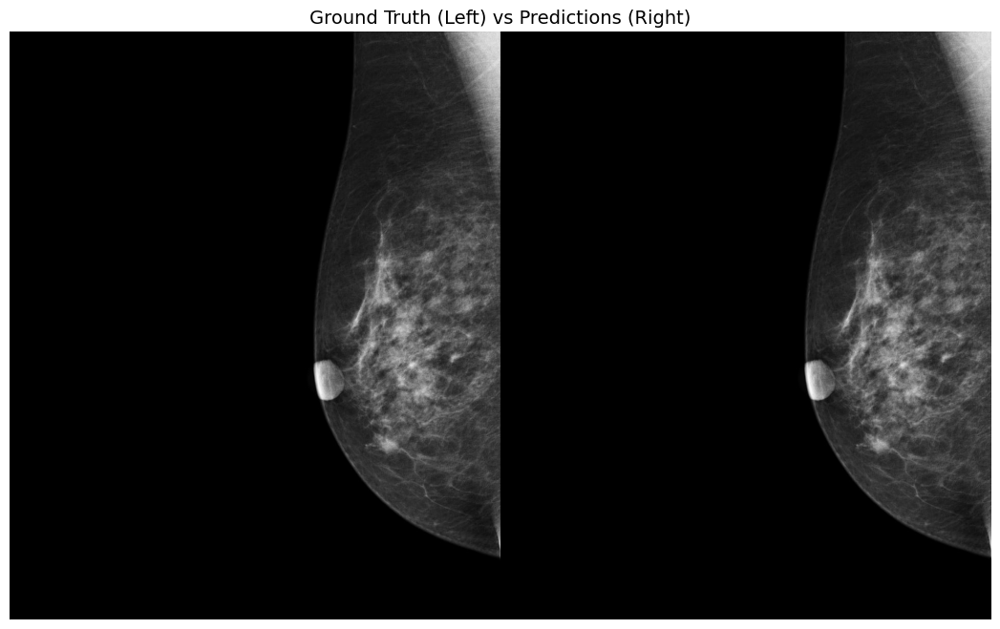


calc: Avg IoU = 0.810 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.810 (1 instances)


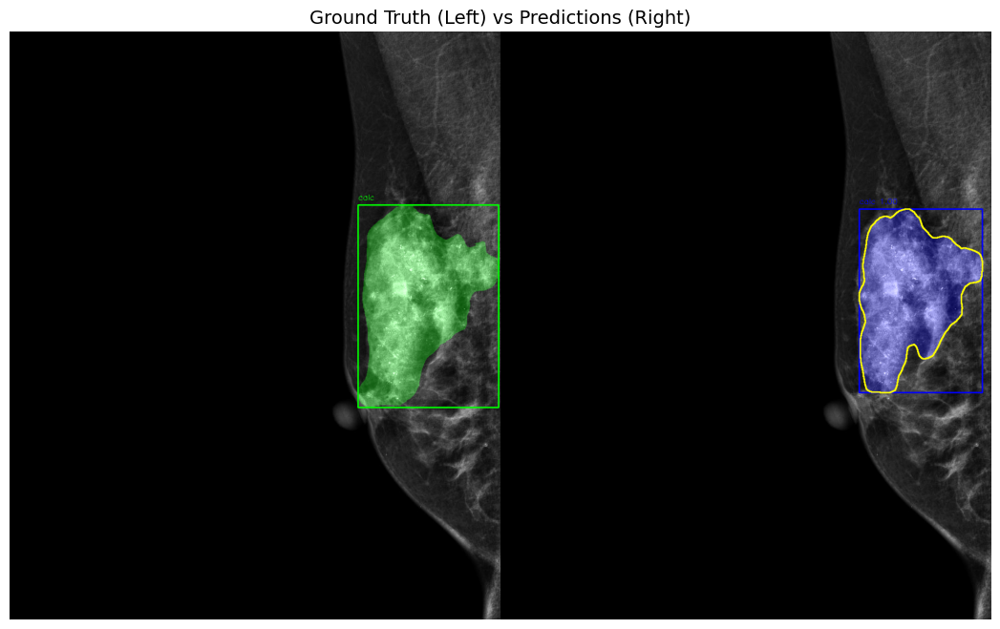


calc: Avg IoU = 0.625 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.625 (1 instances)


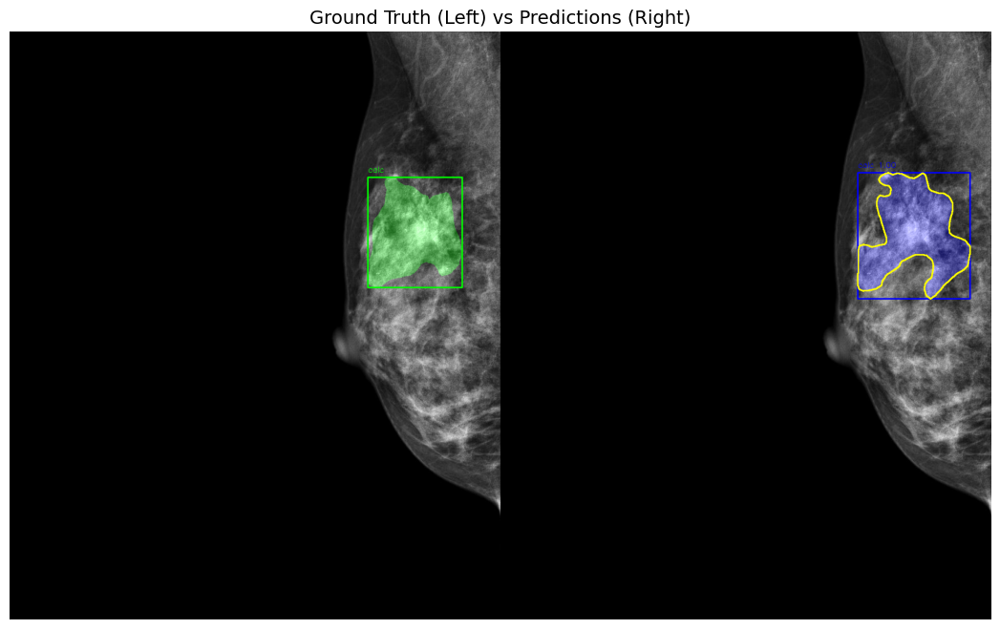


No ground truth masks available


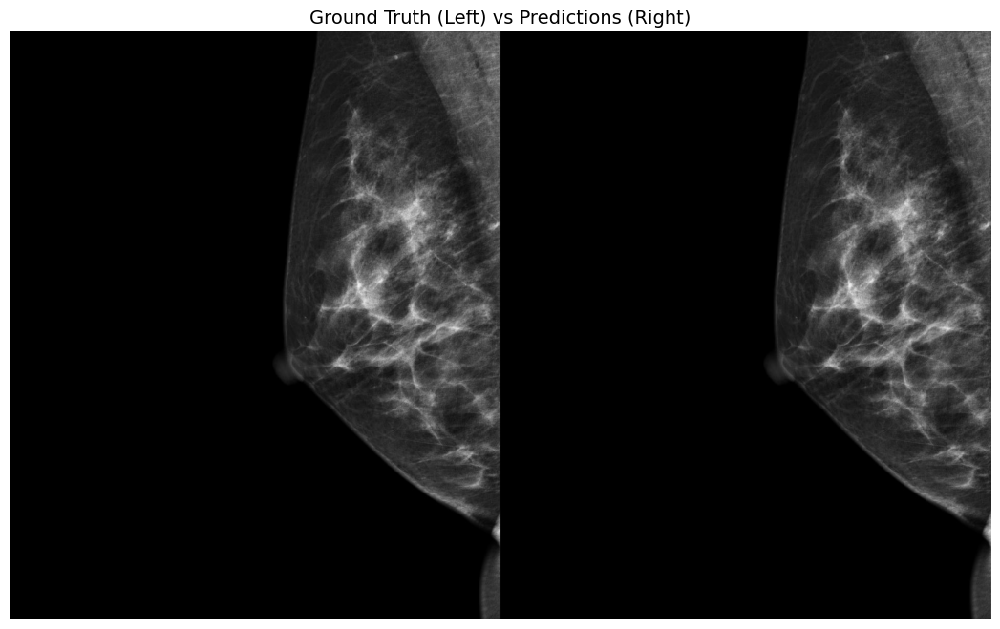


calc: No ground truth instances
mass: Avg IoU = 0.786 (1/1 matched)

Overall IoU: 0.786 (1 instances)


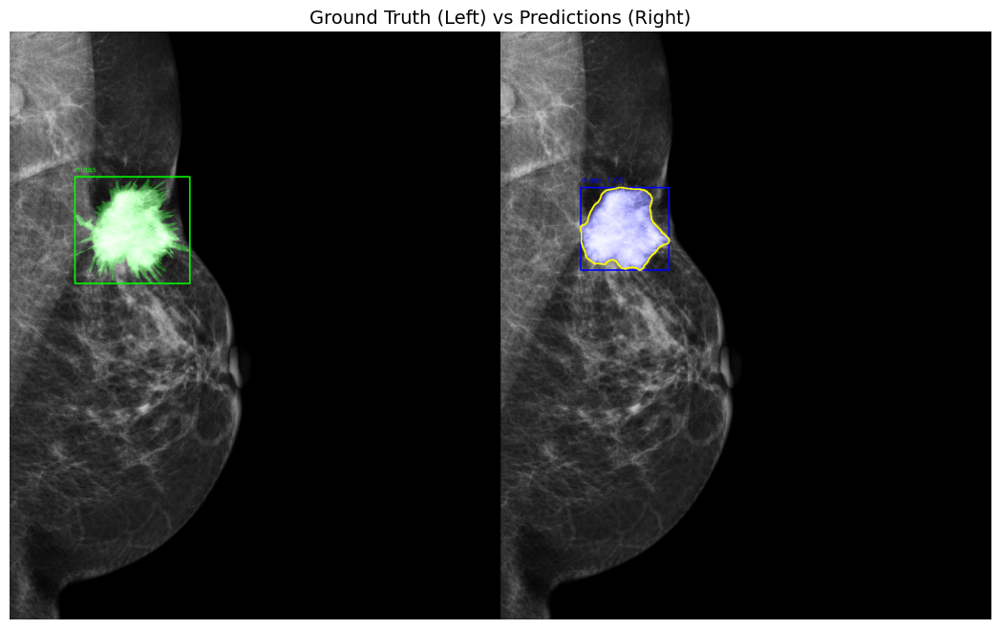


No ground truth masks available


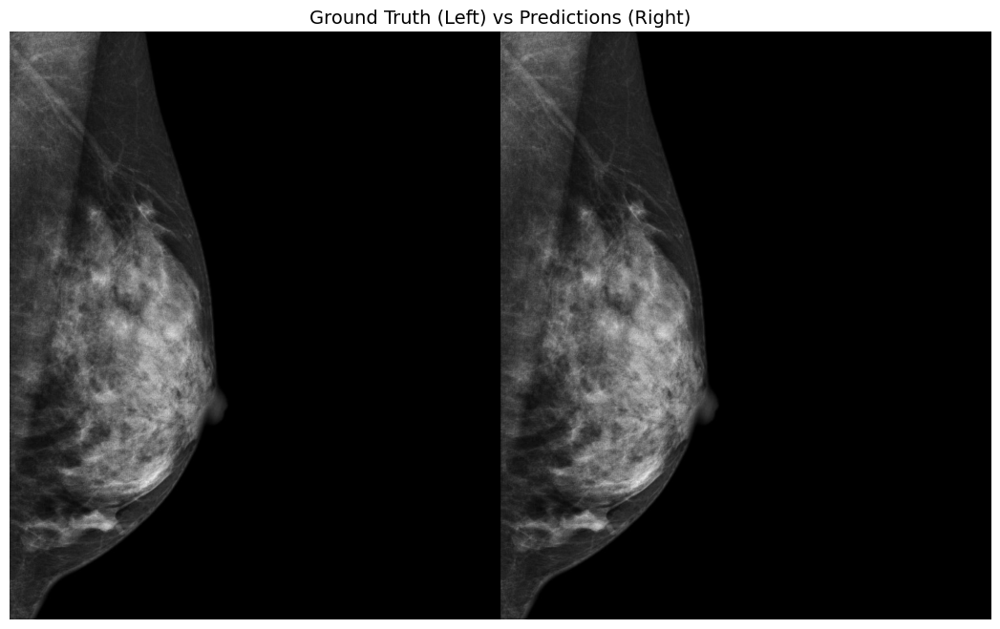


calc: Avg IoU = 0.418 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.418 (1 instances)


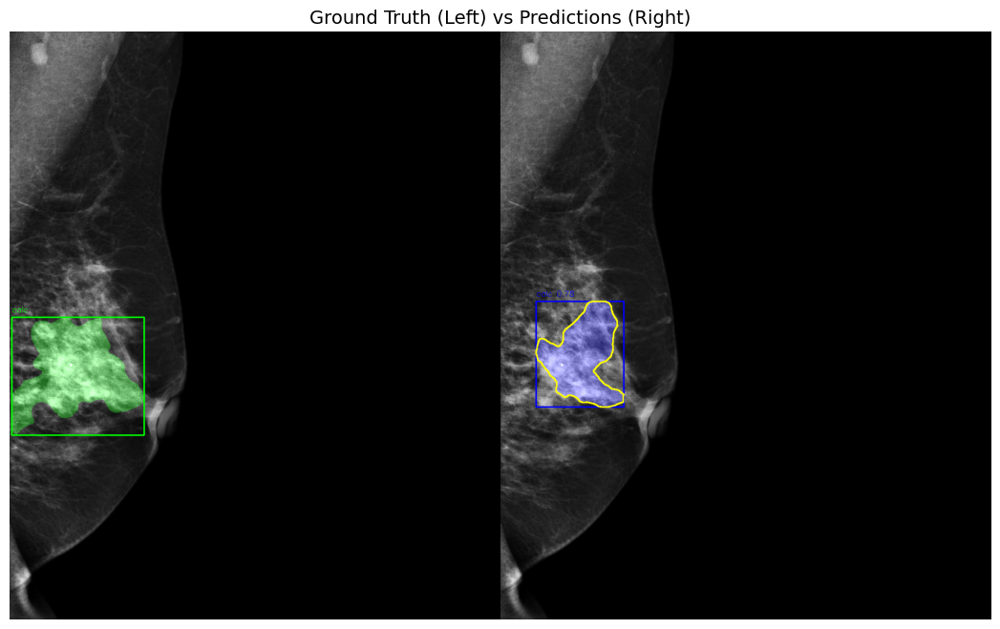


calc: Avg IoU = 0.452 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.452 (1 instances)


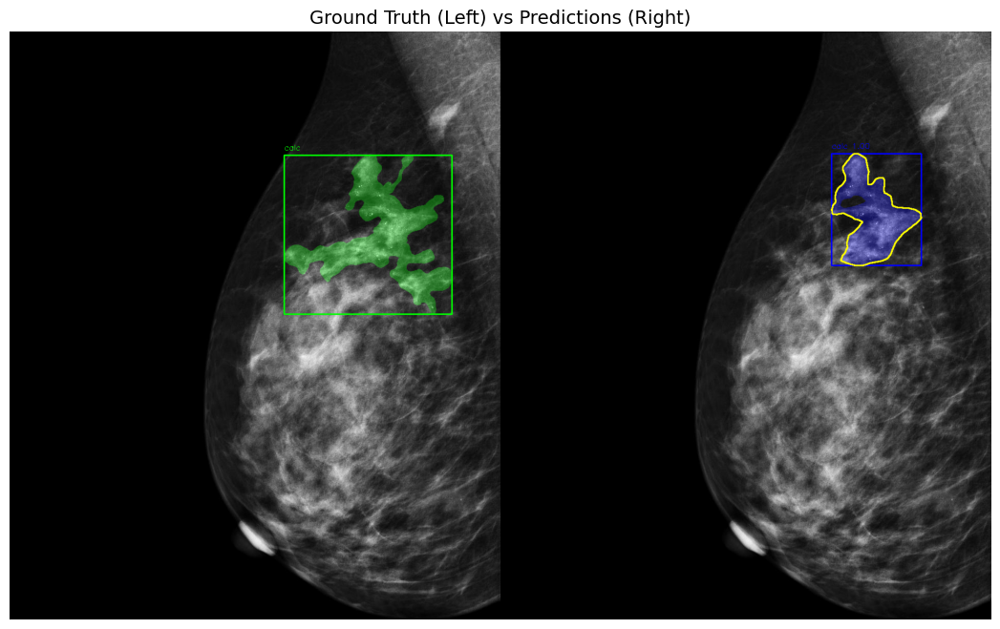


No ground truth masks available


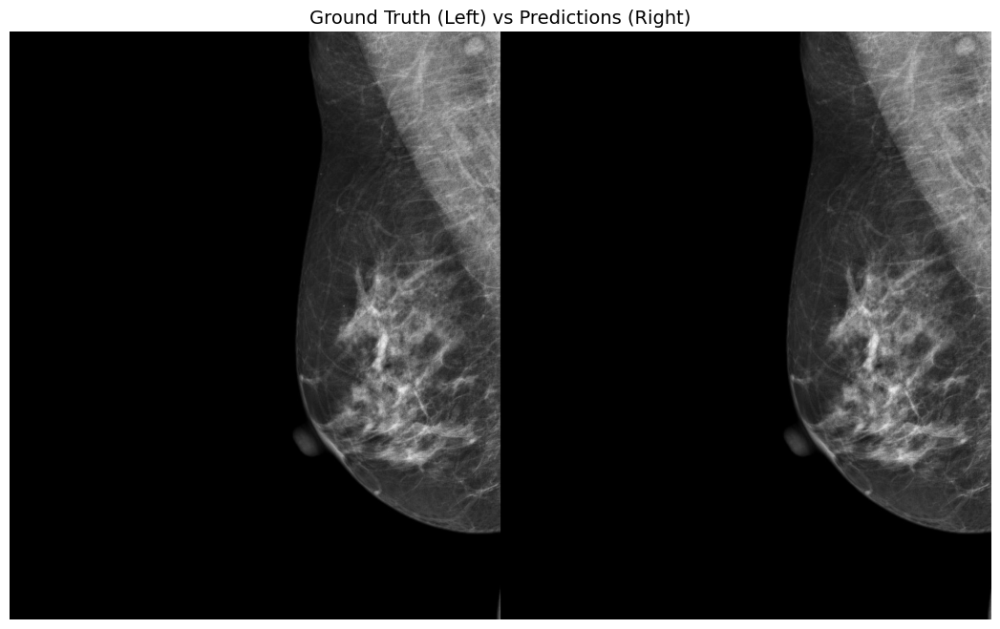


calc: Avg IoU = 0.563 (1/1 matched)
mass: No ground truth instances

Overall IoU: 0.563 (1 instances)


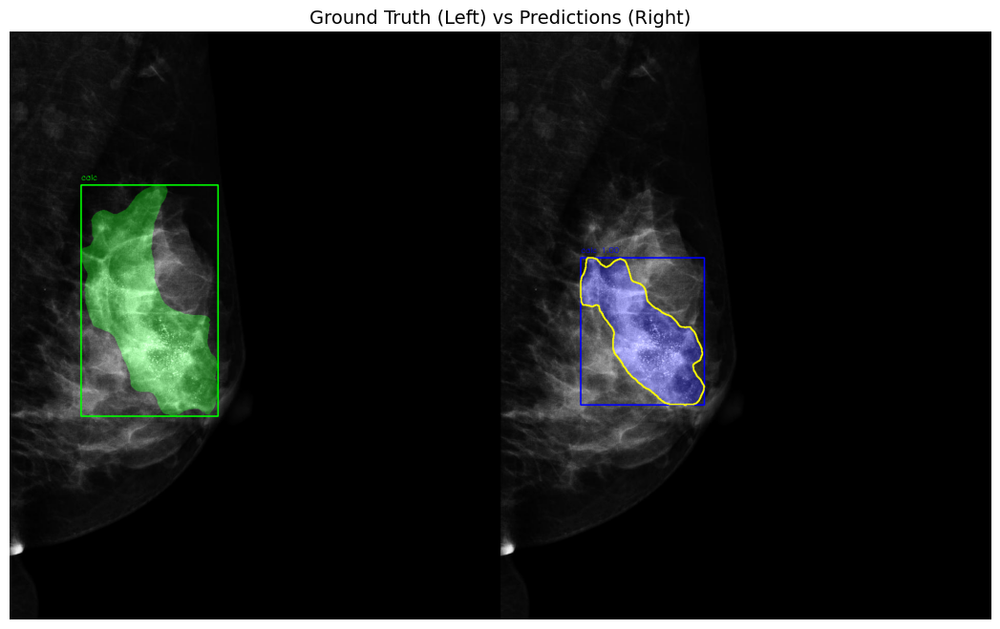


calc: No ground truth instances
mass: Avg IoU = 0.733 (1/1 matched)

Overall IoU: 0.733 (1 instances)


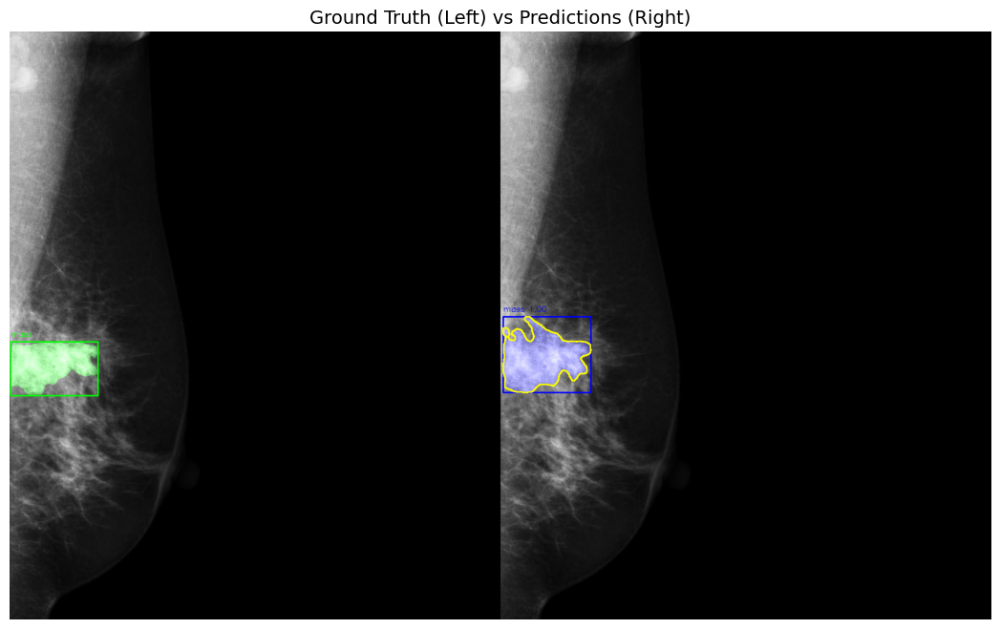


calc: Avg IoU = 0.000 (0/2 matched)
mass: No ground truth instances

Overall IoU: 0.000 (2 instances)


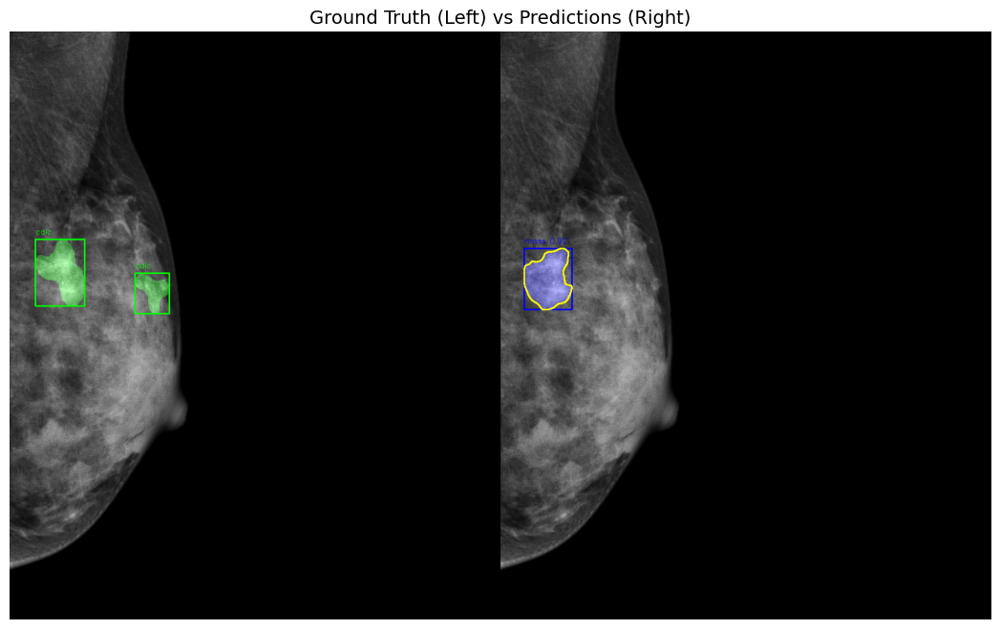


calc: No ground truth instances
mass: Avg IoU = 0.379 (1/1 matched)

Overall IoU: 0.379 (1 instances)


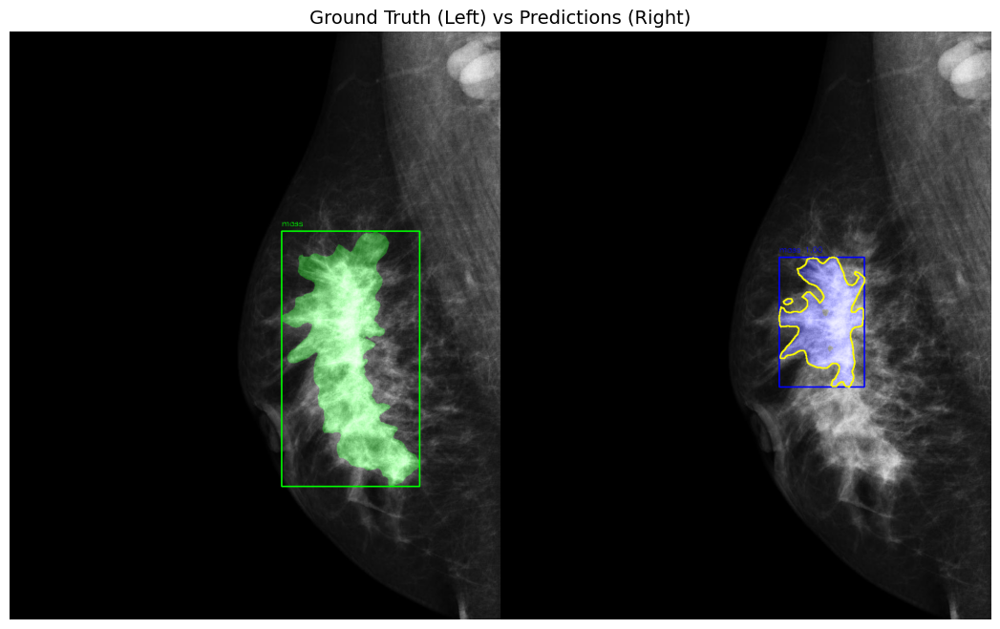


calc: No ground truth instances
mass: Avg IoU = 0.693 (1/1 matched)

Overall IoU: 0.693 (1 instances)


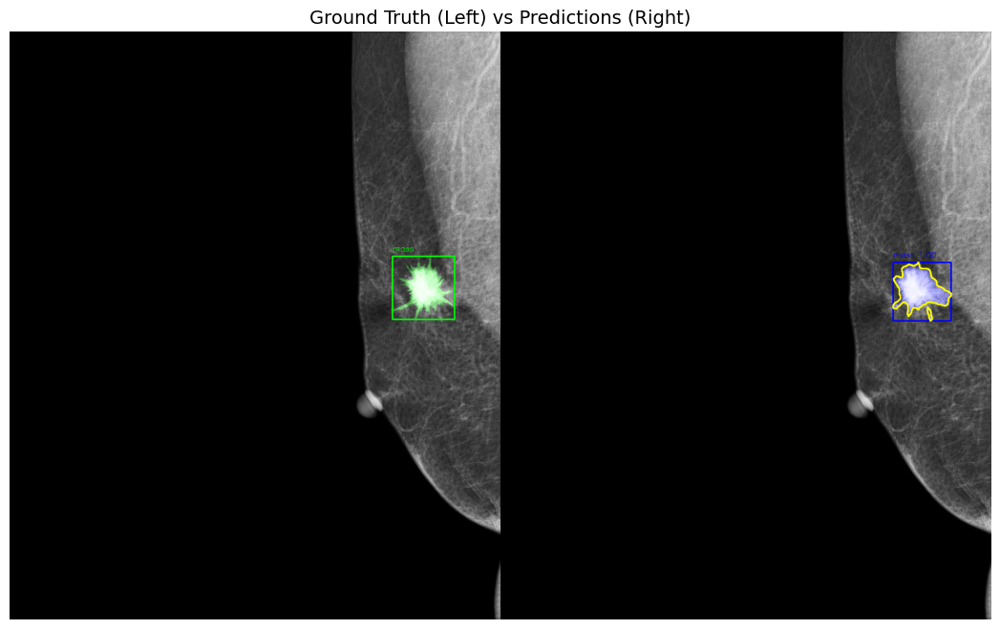


calc: No ground truth instances
mass: Avg IoU = 0.000 (0/1 matched)

Overall IoU: 0.000 (1 instances)


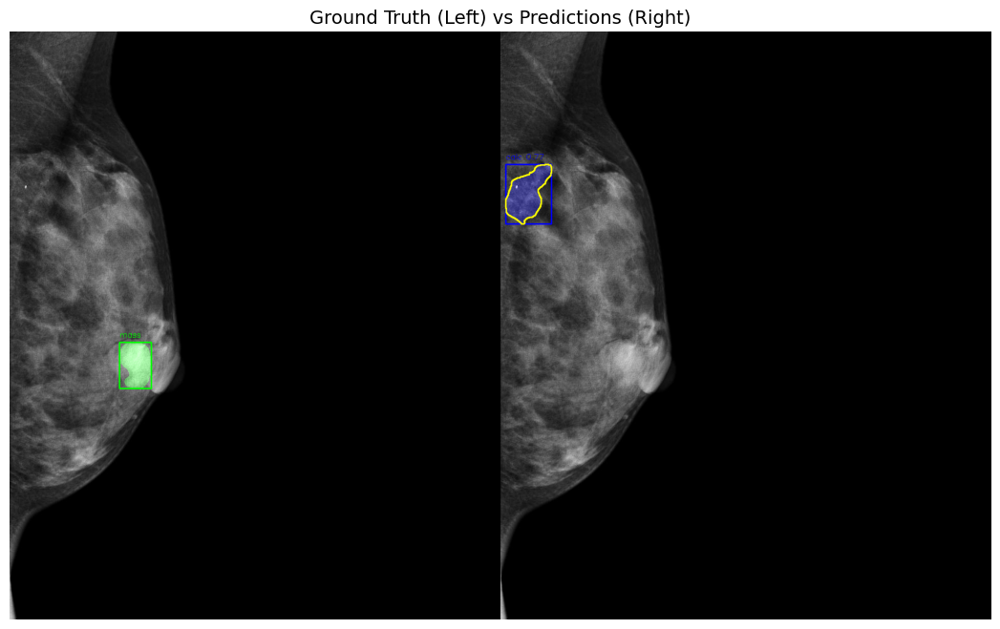


No ground truth masks available


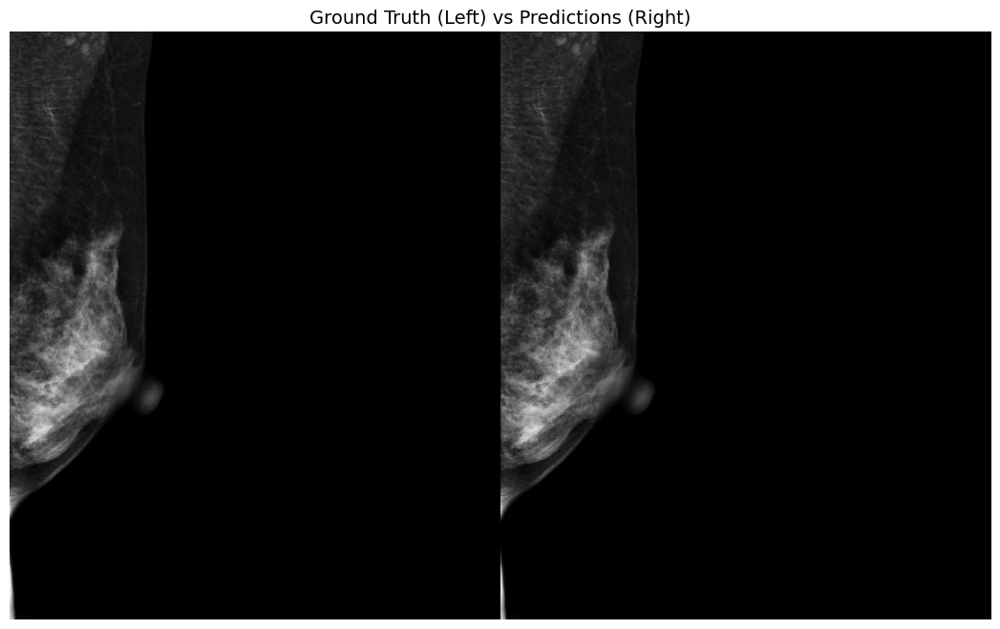


calc: No ground truth instances
mass: Avg IoU = 0.875 (1/1 matched)

Overall IoU: 0.875 (1 instances)


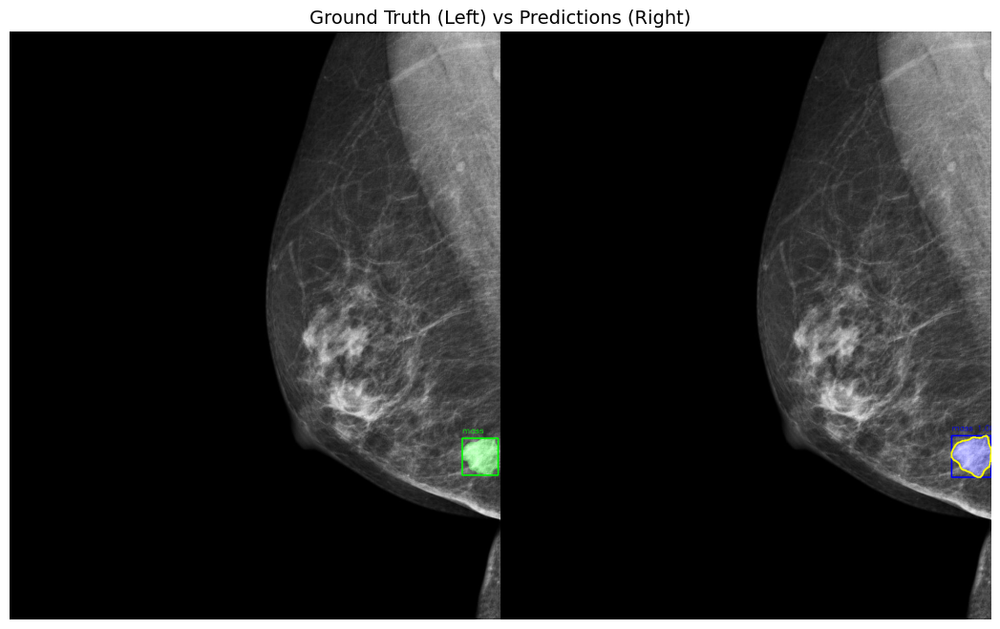


calc: No ground truth instances
mass: Avg IoU = 0.824 (1/1 matched)

Overall IoU: 0.824 (1 instances)


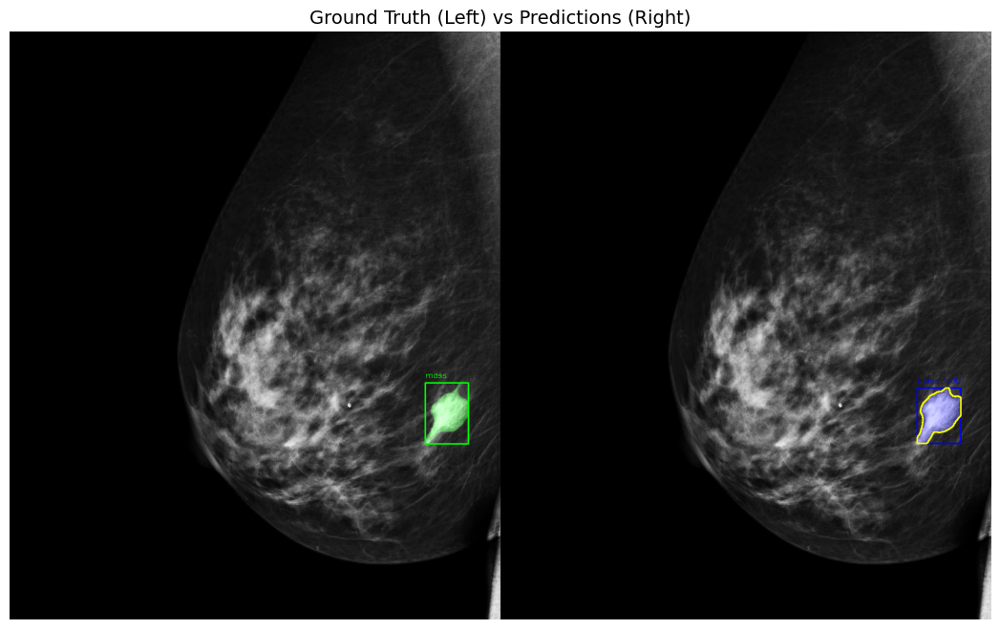


calc: No ground truth instances
mass: Avg IoU = 0.905 (1/1 matched)

Overall IoU: 0.905 (1 instances)


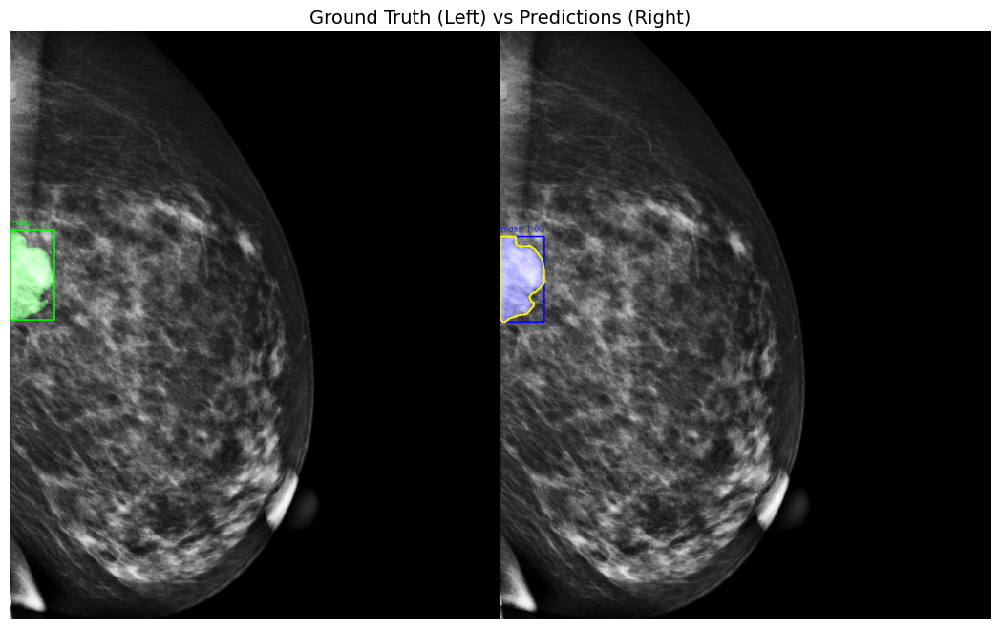


calc: Avg IoU = 0.608 (1/1 matched)
mass: Avg IoU = 0.472 (1/1 matched)

Overall IoU: 0.540 (2 instances)


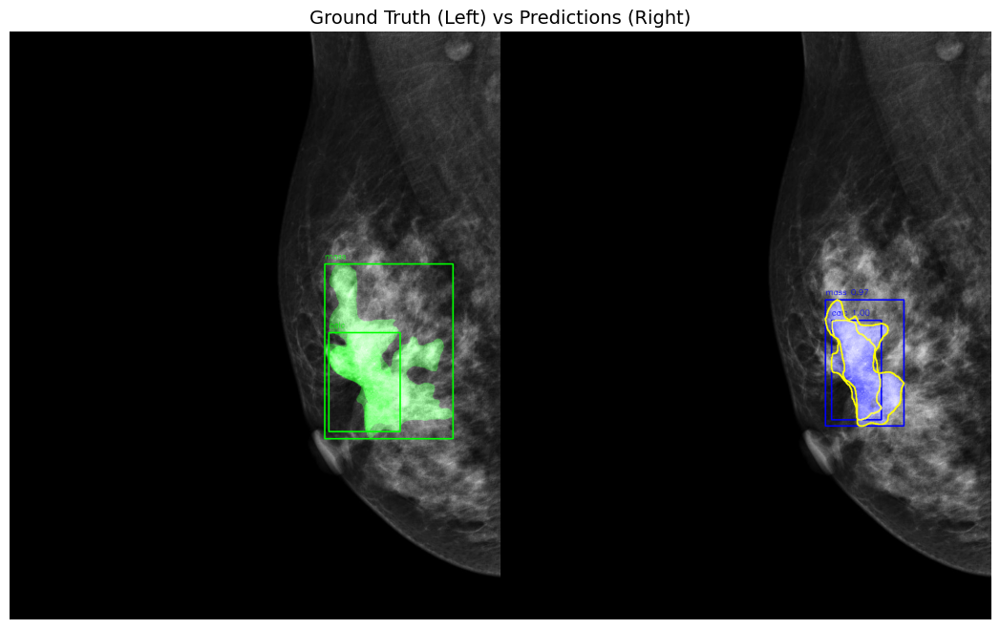


calc: No ground truth instances
mass: Avg IoU = 0.231 (1/1 matched)

Overall IoU: 0.231 (1 instances)


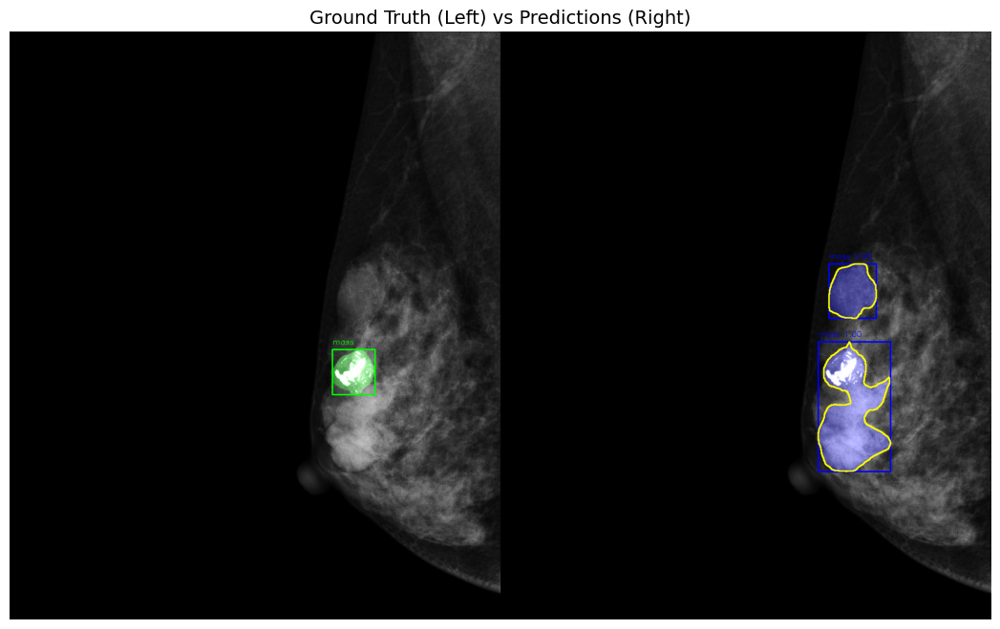


calc: No ground truth instances
mass: Avg IoU = 0.000 (0/1 matched)

Overall IoU: 0.000 (1 instances)


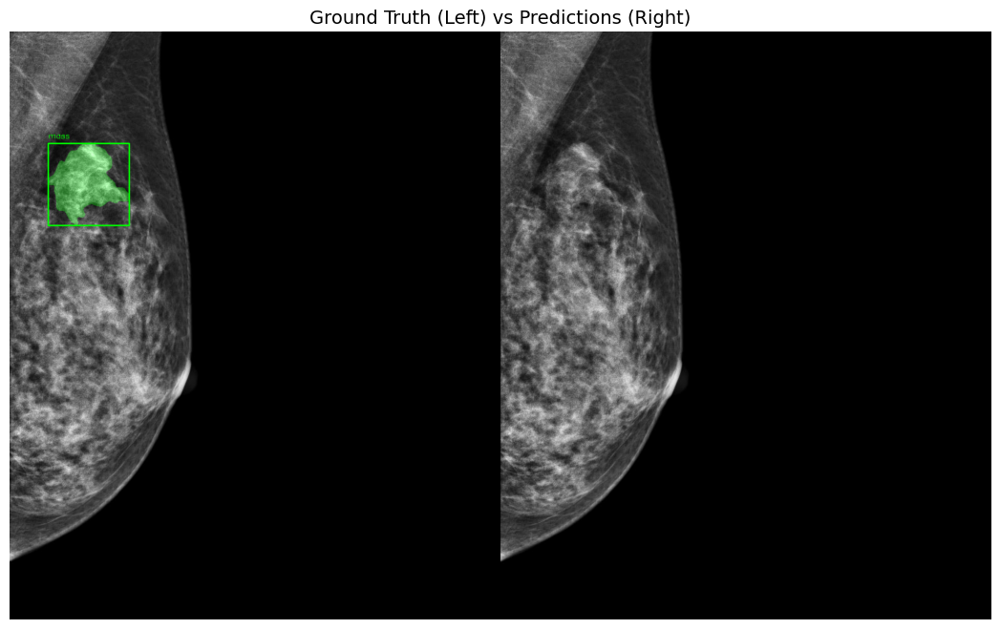


No ground truth masks available


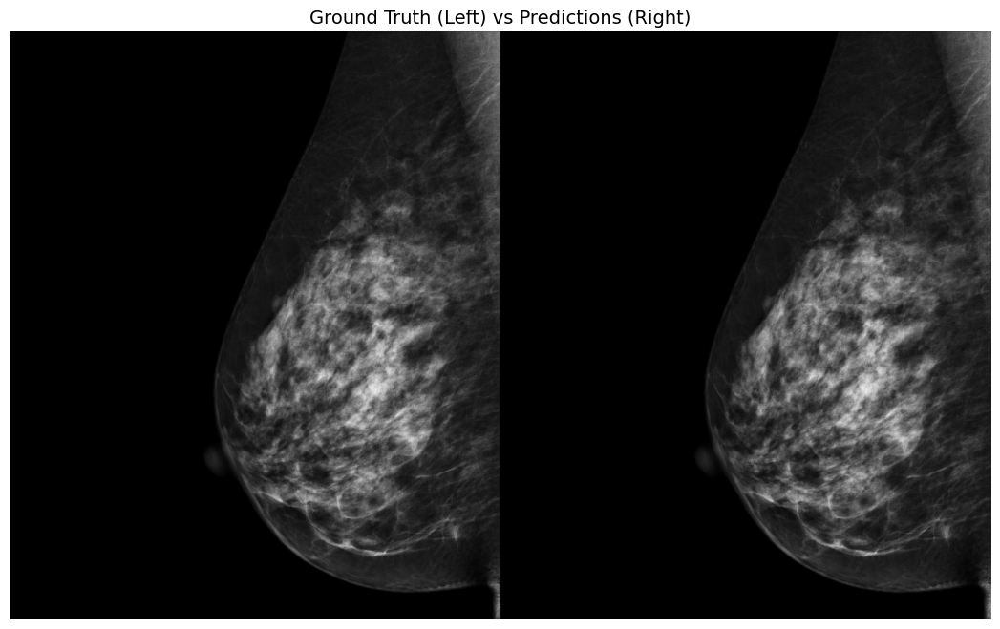


calc: No ground truth instances
mass: Avg IoU = 0.310 (1/1 matched)

Overall IoU: 0.310 (1 instances)


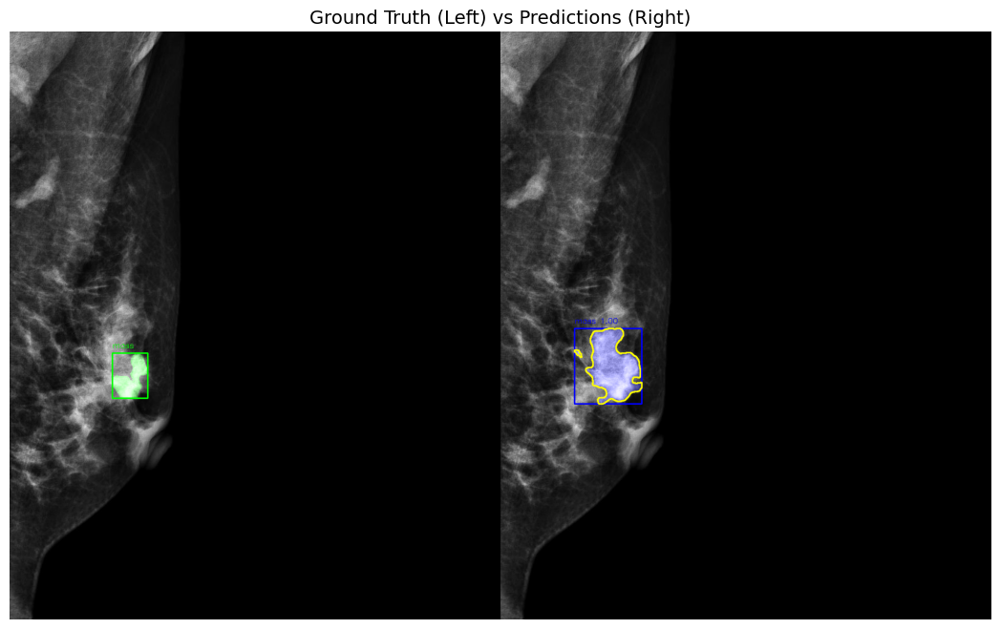


calc: Avg IoU = 0.648 (1/1 matched)
mass: Avg IoU = 0.281 (1/3 matched)

Overall IoU: 0.373 (4 instances)


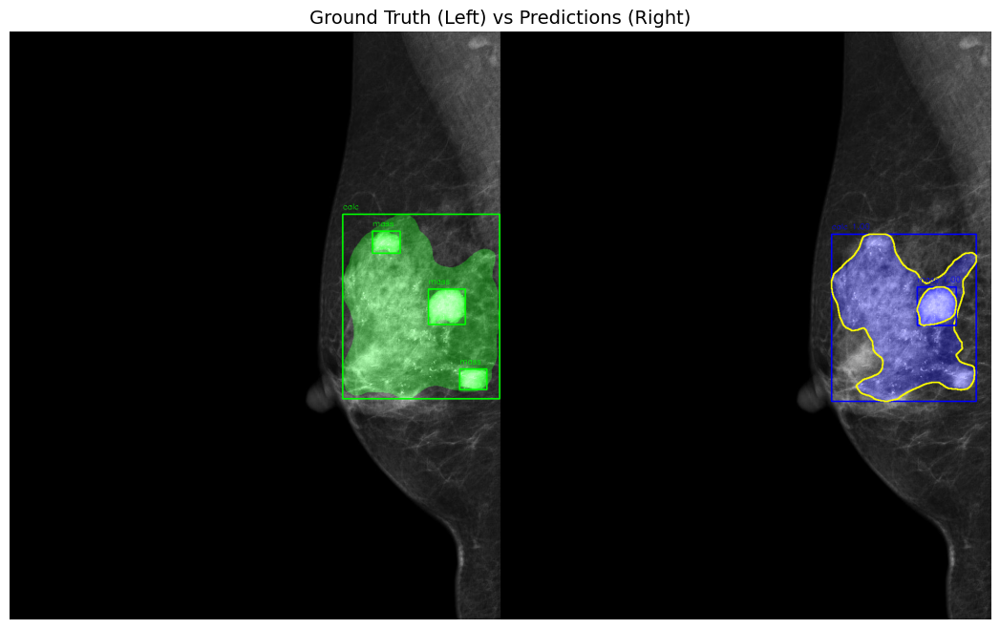


calc: Avg IoU = 0.790 (1/1 matched)
mass: Avg IoU = 0.291 (1/1 matched)

Overall IoU: 0.541 (2 instances)


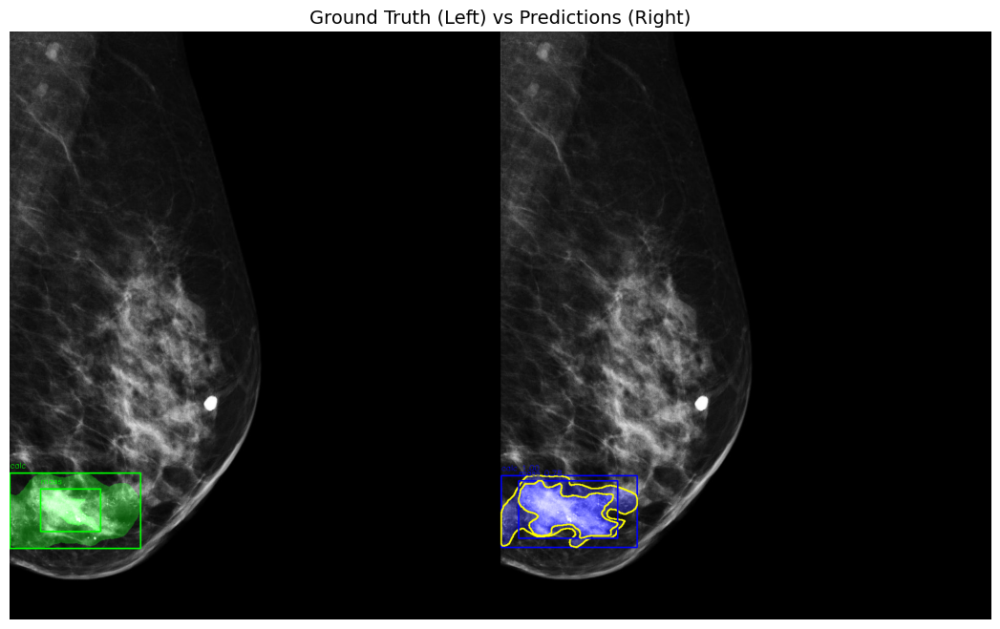


No ground truth masks available


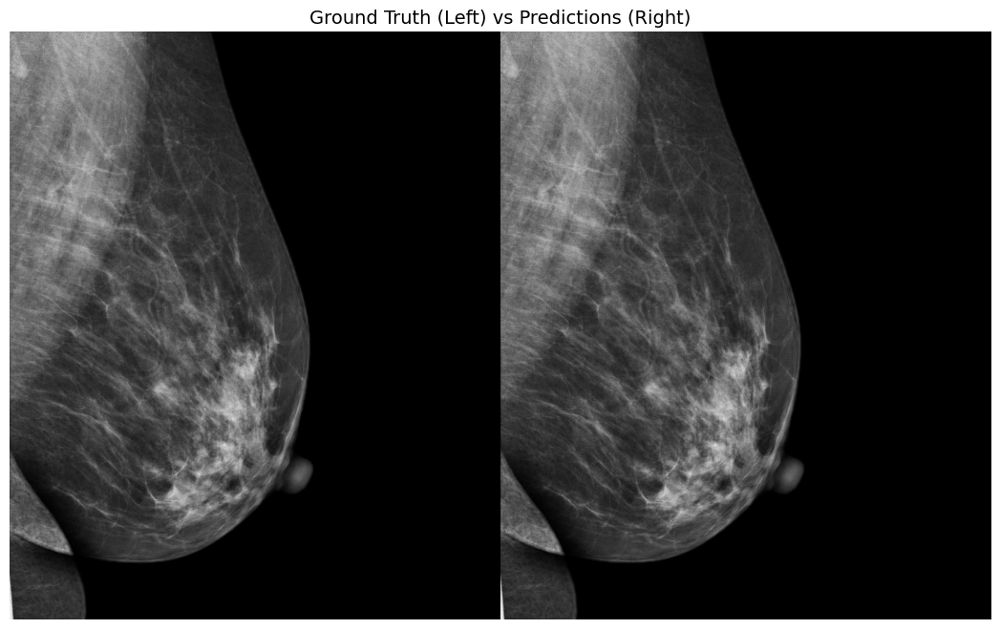


calc: Avg IoU = 0.235 (1/1 matched)
mass: Avg IoU = 0.615 (1/1 matched)

Overall IoU: 0.425 (2 instances)


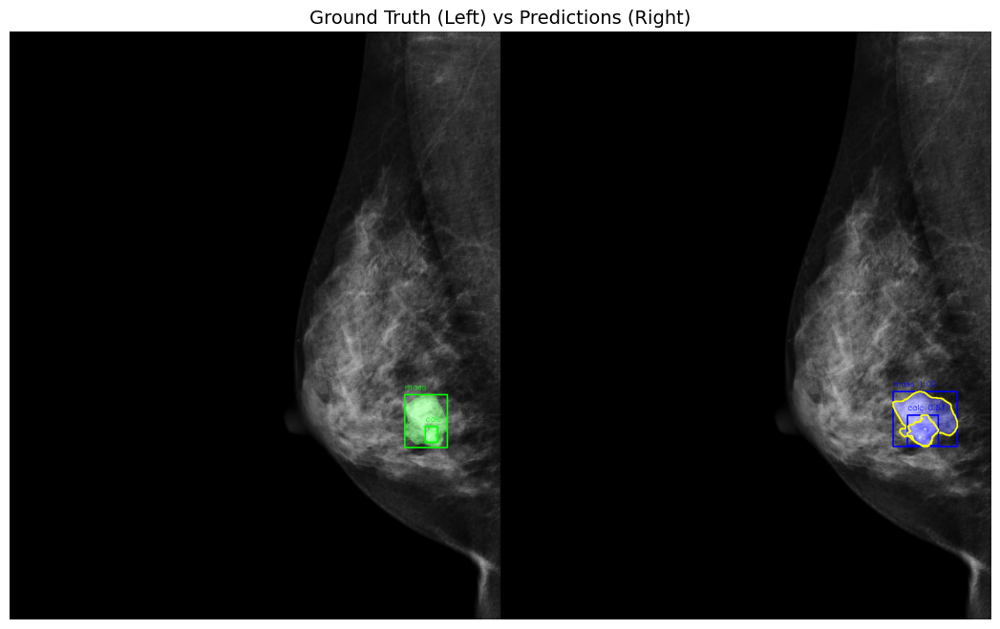


calc: Avg IoU = 0.587 (1/1 matched)
mass: Avg IoU = 0.000 (0/1 matched)

Overall IoU: 0.294 (2 instances)


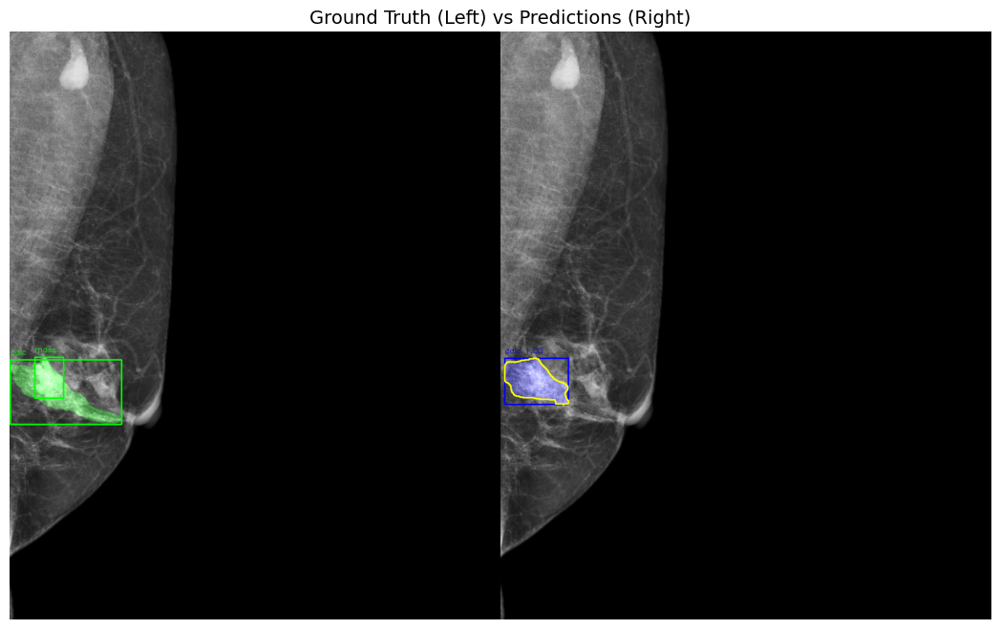


calc: No ground truth instances
mass: Avg IoU = 0.831 (2/2 matched)

Overall IoU: 0.831 (2 instances)


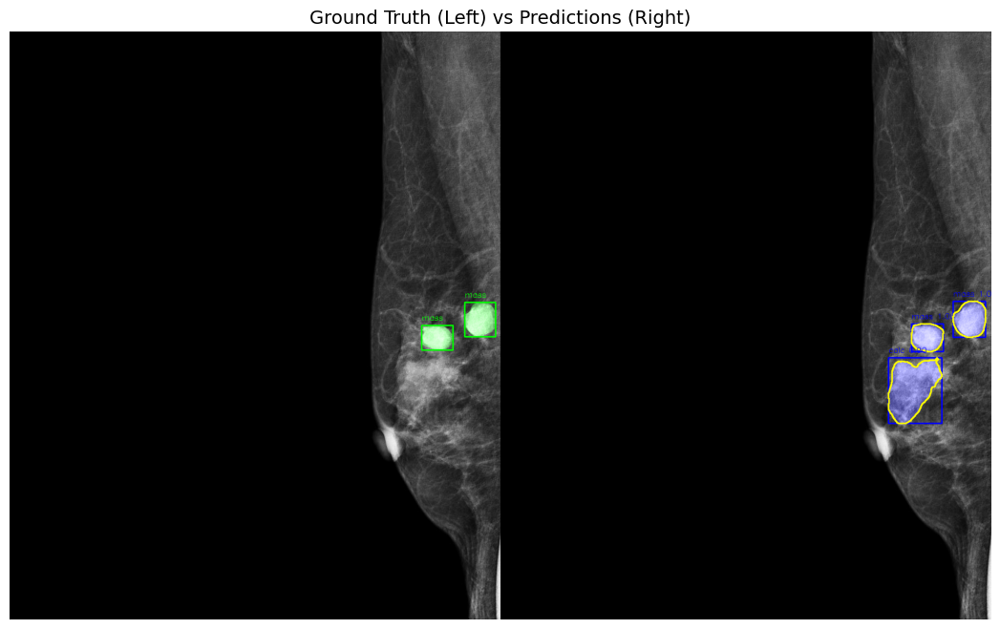


calc: No ground truth instances
mass: Avg IoU = 0.894 (1/1 matched)

Overall IoU: 0.894 (1 instances)


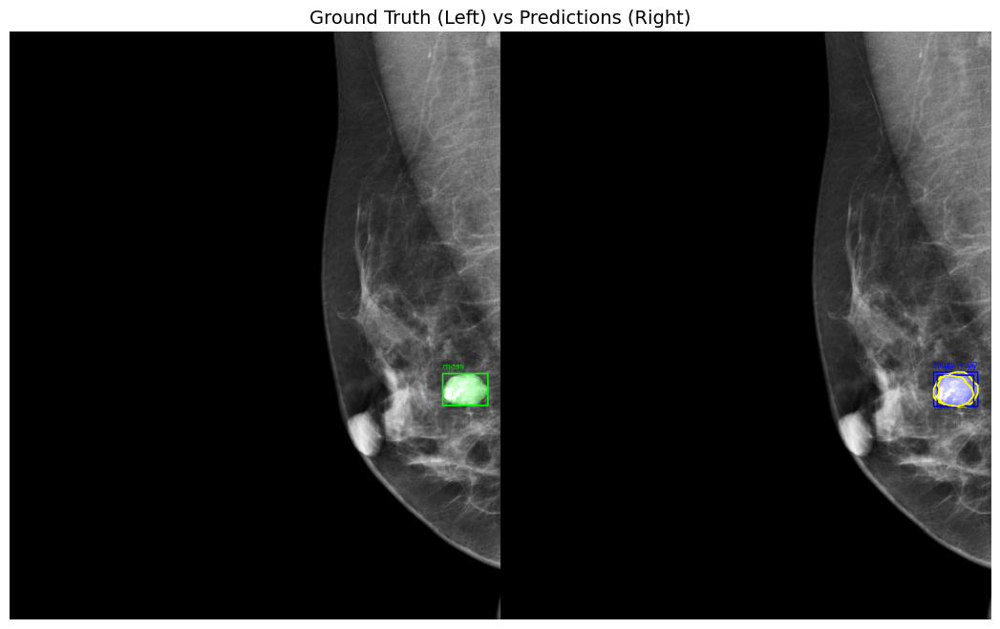


calc: Avg IoU = 0.444 (1/1 matched)
mass: Avg IoU = 0.559 (1/1 matched)

Overall IoU: 0.502 (2 instances)


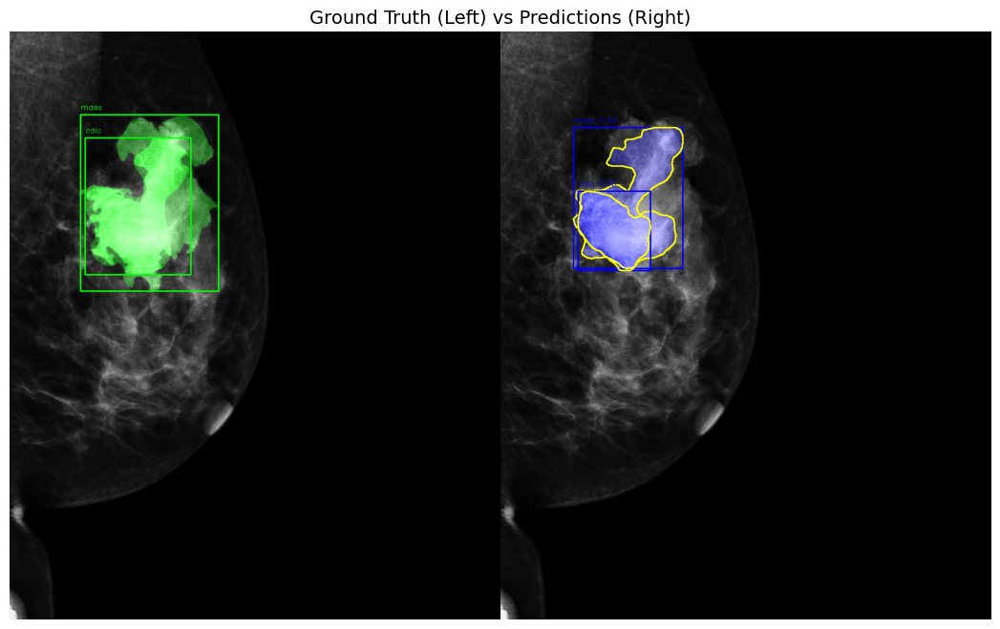


No ground truth masks available


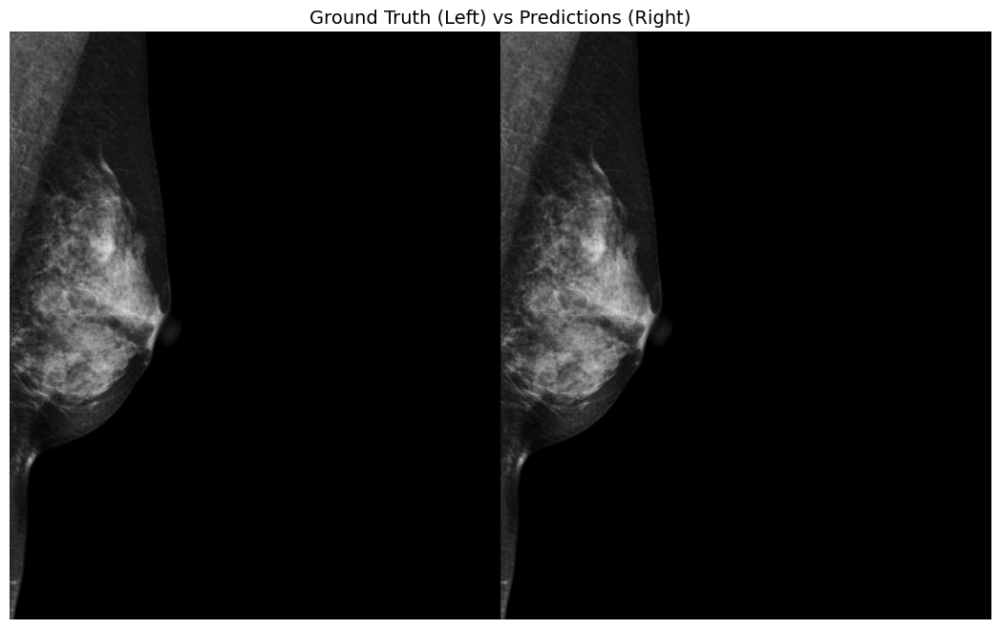

In [10]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import torch

# Define your custom classes
CUSTOM_CLASSES = ['calc', 'mass']

def calculate_iou(mask1, mask2):
    """Calculate Intersection over Union between two binary masks."""
    intersection = np.logical_and(mask1, mask2)
    union = np.logical_or(mask1, mask2)
    iou = np.sum(intersection) / (np.sum(union) + 1e-8)  # Add epsilon to avoid division by zero
    return iou

def merge_overlapping_masks(masks, labels, scores, iou_threshold=0.5):
    """Merge overlapping masks of the same class based on IoU threshold."""
    if len(masks) == 0:
        return np.array([]), np.array([]), np.array([])

    binary_masks = [(mask.squeeze() > 0.5).astype(np.float32) for mask in masks]
    binary_masks = np.stack(binary_masks)

    merged_masks = []
    merged_labels = []
    merged_scores = []
    used_indices = set()

    for i in range(len(binary_masks)):
        if i in used_indices:
            continue

        current_mask = binary_masks[i]
        current_label = labels[i]
        current_score = scores[i]
        merge_candidates = [i]

        for j in range(i+1, len(binary_masks)):
            if (j not in used_indices and
                labels[j] == current_label and
                calculate_iou(current_mask, binary_masks[j]) > iou_threshold):
                merge_candidates.append(j)

        if len(merge_candidates) > 1:
            combined_mask = np.max(binary_masks[merge_candidates], axis=0)
            max_score = max(scores[merge_candidates])
            merged_masks.append(combined_mask)
            merged_labels.append(current_label)
            merged_scores.append(max_score)
            used_indices.update(merge_candidates)
        else:
            merged_masks.append(current_mask)
            merged_labels.append(current_label)
            merged_scores.append(current_score)
            used_indices.add(i)

    return np.array(merged_masks), np.array(merged_labels), np.array(merged_scores)

# Assuming model and test_dataset are defined elsewhere
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
model.eval()

for img, target in test_dataset:
    img = img.to(device).unsqueeze(0)
    
    with torch.no_grad():
        predictions = model(img)

    # Process image for display
    image_np = img.squeeze(0).cpu().permute(1, 2, 0).numpy()
    if image_np.max() <= 1:
        image_np = (image_np * 255).astype(np.uint8)

    # Prepare ground truth
    gt_image = image_np.copy()
    gt_boxes = target['boxes'].cpu().numpy()
    gt_labels = target['labels'].cpu().numpy()
    gt_masks = target['masks'].cpu().numpy() if 'masks' in target else None

    # Draw ground truth
    if gt_masks is not None:
        for i, (box, label) in enumerate(zip(gt_boxes, gt_labels)):
            xmin, ymin, xmax, ymax = box.astype(int)
            xmin = max(0, xmin)
            ymin = max(0, ymin)
            xmax = min(gt_image.shape[1], xmax)
            ymax = min(gt_image.shape[0], ymax)

            cv2.rectangle(gt_image, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)
            class_name = CUSTOM_CLASSES[label - 1]
            cv2.putText(gt_image, class_name, (xmin, ymin - 10), 
                       cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

            mask = gt_masks[i].squeeze()
            colored_mask = np.zeros_like(gt_image)
            colored_mask[:, :] = (0, 255, 0)
            gt_image = np.where(mask[..., None] > 0,
                              cv2.addWeighted(gt_image, 1, colored_mask, 0.3, 0),
                              gt_image)

    # Process predictions
    pred_image = image_np.copy()
    confidence_threshold = 0.6
    high_conf_indices = predictions[0]['scores'] > confidence_threshold

    if high_conf_indices.any():
        pred_boxes = predictions[0]['boxes'][high_conf_indices].cpu().numpy()
        pred_labels = predictions[0]['labels'][high_conf_indices].cpu().numpy()
        pred_masks = predictions[0]['masks'][high_conf_indices].cpu().numpy()
        pred_scores = predictions[0]['scores'][high_conf_indices].cpu().numpy()

        # Merge masks
        merged_masks, merged_labels, merged_scores = merge_overlapping_masks(
            pred_masks, pred_labels, pred_scores, iou_threshold=0.0
        )

        # Draw predictions
        for i in range(len(merged_labels)):
            mask = merged_masks[i].squeeze()
            mask = (mask > 0.5).astype(np.uint8)

            y_indices, x_indices = np.where(mask > 0)
            if len(x_indices) == 0 or len(y_indices) == 0:
                continue

            xmin, xmax = np.min(x_indices), np.max(x_indices)
            ymin, ymax = np.min(y_indices), np.max(y_indices)

            cv2.rectangle(pred_image, (xmin, ymin), (xmax, ymax), (255, 0, 0), 2)
            class_name = CUSTOM_CLASSES[merged_labels[i] - 1]
            score = merged_scores[i]
            label_text = f"{class_name} {score:.2f}"
            cv2.putText(pred_image, label_text, (xmin, ymin - 10),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

            colored_mask = np.zeros_like(pred_image)
            colored_mask[:, :] = (255, 0, 0)
            pred_image = np.where(mask[..., None] > 0,
                                cv2.addWeighted(pred_image, 1, colored_mask, 0.3, 0),
                                pred_image)

            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            cv2.drawContours(pred_image, contours, -1, (0, 255, 255), 2)

    # Convert images for display
    gt_image = cv2.cvtColor(gt_image, cv2.COLOR_BGR2RGB)
    pred_image = cv2.cvtColor(pred_image, cv2.COLOR_BGR2RGB)
    combined_image = np.hstack((gt_image, pred_image))

    # Calculate IoU metrics
    print("\n" + "="*50)
    if gt_masks is not None and len(gt_masks) > 0:
        class_metrics = {cls: {'ious': [], 'total_gts': 0} for cls in CUSTOM_CLASSES}

        for cls in CUSTOM_CLASSES:
            cls_label = CUSTOM_CLASSES.index(cls) + 1
            gt_cls_masks = [gt_masks[i].squeeze().astype(bool) 
                           for i in range(len(gt_labels)) 
                           if gt_labels[i] == cls_label]
            pred_cls_masks = [merged_masks[i].squeeze().astype(bool) 
                             for i in range(len(merged_labels)) 
                             if merged_labels[i] == cls_label]

            pairs = []
            for gt_idx, gt_mask in enumerate(gt_cls_masks):
                for pred_idx, pred_mask in enumerate(pred_cls_masks):
                    iou = calculate_iou(gt_mask, pred_mask)
                    pairs.append((iou, gt_idx, pred_idx))

            pairs.sort(reverse=True, key=lambda x: x[0])
            matched_gts = set()
            matched_preds = set()
            class_ious = []

            for pair in pairs:
                iou, gt_idx, pred_idx = pair
                if gt_idx not in matched_gts and pred_idx not in matched_preds:
                    class_ious.append(iou)
                    matched_gts.add(gt_idx)
                    matched_preds.add(pred_idx)

            # Add unmatched GTs as 0 IoU
            class_ious += [0.0] * (len(gt_cls_masks) - len(matched_gts))
            class_metrics[cls]['ious'] = class_ious
            class_metrics[cls]['total_gts'] = len(gt_cls_masks)

        # Print results
        total_ious = []
        total_gts = 0
        for cls in CUSTOM_CLASSES:
            metrics = class_metrics[cls]
            if metrics['total_gts'] == 0:
                print(f"{cls}: No ground truth instances")
                continue

            avg_iou = np.mean(metrics['ious']) if metrics['ious'] else 0.0
            matched = sum(iou > 0 for iou in metrics['ious'])
            print(f"{cls}: Avg IoU = {avg_iou:.3f} ({matched}/{metrics['total_gts']} matched)")
            total_ious.extend(metrics['ious'])
            total_gts += metrics['total_gts']

        if total_gts > 0:
            overall_iou = np.mean(total_ious)
            print(f"\nOverall IoU: {overall_iou:.3f} ({len(total_ious)} instances)")
        else:
            print("No valid ground truth in this image")
    else:
        print("No ground truth masks available")

    # Display results
    plt.figure(figsize=(16, 8))
    plt.imshow(combined_image)
    plt.axis('off')
    plt.title("Ground Truth (Left) vs Predictions (Right)", fontsize=14)
    plt.show()

In [9]:
import torch
import torchvision


# Load custom weights
model.load_state_dict(torch.load("/kaggle/working/MaskRcnn_bestmap.pth", map_location=torch.device('cuda' if torch.cuda.is_available() else 'cpu')))

# Move to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

/tmp/ipykernel_31/3341793030.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("/kaggle/working/MaskRcnn_bestmap.pth", map_location=torch.

MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(957,), max_size=1147, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 96, kernel_size=(4, 4), stride=(4, 4))
        (1): LayerNorm2d((96,), eps=1e-06, elementwise_affine=True)
      )
      (1): Sequential(
        (0): CNBlock(
          (block): Sequential(
            (0): Conv2d(96, 96, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), groups=96)
            (1): Permute()
            (2): LayerNorm((96,), eps=1e-06, elementwise_affine=True)
            (3): Linear(in_features=96, out_features=384, bias=True)
            (4): GELU(approximate='none')
            (5): Linear(in_features=384, out_features=96, bias=True)
            (6): Permute()
          )
          (stochastic_depth): StochasticDepth(p=0.0, mode=row)
        )
        (1): C

In [ ]:
evaluate_map(model,test_loader, device,'segm')

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.368
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.793
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.381
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.435
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.450
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.450
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.397
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.457

In [ ]:
import numpy as np
import torch
from torchmetrics.classification import BinaryJaccardIndex
from torchmetrics.segmentation import DiceScore

# Define your custom classes
CUSTOM_CLASSES = ['calc', 'mass']

def merge_overlapping_masks(masks, labels, scores, iou_threshold=0.5):
    if len(masks) == 0:
        return np.array([]), np.array([]), np.array([])

    binary_masks = [(mask.squeeze() > 0.5).astype(np.float32) for mask in masks]
    binary_masks = np.stack(binary_masks)

    merged_masks = []
    merged_labels = []
    merged_scores = []
    used_indices = set()

    for i in range(len(binary_masks)):
        if i in used_indices:
            continue

        cur_mask  = binary_masks[i]
        cur_label = labels[i]
        cur_score = scores[i]
        candidates = [i]

        for j in range(i + 1, len(binary_masks)):
            if (
                j not in used_indices
                and labels[j] == cur_label
                and (np.sum(np.logical_and(cur_mask, binary_masks[j]))
                     / (np.sum(np.logical_or(cur_mask, binary_masks[j])) + 1e-8)
                    ) > iou_threshold
            ):
                candidates.append(j)

        if len(candidates) > 1:
            combined = np.max(binary_masks[candidates], axis=0)
            best_score = max(scores[candidates])
            merged_masks.append(combined)
            merged_labels.append(cur_label)
            merged_scores.append(best_score)
            used_indices.update(candidates)
        else:
            merged_masks.append(cur_mask)
            merged_labels.append(cur_label)
            merged_scores.append(cur_score)
            used_indices.add(i)

    return np.array(merged_masks), np.array(merged_labels), np.array(merged_scores)


# Setup
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
model.eval()

# Initialize metrics
jaccard_metric = BinaryJaccardIndex(threshold=0.5).to(device)
dice_metric    = DiceScore(
    num_classes=2,
    include_background=False,
    average='none',
    input_format='index',
    zero_division=0.0
).to(device)

# Accumulators
class_metrics = {
    cls: {'ious': [], 'dices': [], 'total_gts': 0}
    for cls in CUSTOM_CLASSES
}
all_ious = []
all_dices = []

# Evaluation loop
for img, target in test_dataset:
    img = img.to(device).unsqueeze(0)
    with torch.no_grad():
        preds = model(img)

    gt_labels = target['labels'].cpu().numpy()
    gt_masks  = target.get('masks')
    if gt_masks is not None:
        gt_masks = gt_masks.cpu().numpy()

    # filter predictions by score
    scores = preds[0]['scores']
    keep   = scores > 0.6
    if keep.any():
        pred_labels = preds[0]['labels'][keep].cpu().numpy()
        pred_masks  = preds[0]['masks'][keep].cpu().numpy()
        pred_scores = scores[keep].cpu().numpy()
        merged_masks, merged_labels, _ = merge_overlapping_masks(
            pred_masks, pred_labels, pred_scores, iou_threshold=0.0
        )
    else:
        merged_masks, merged_labels = np.array([]), np.array([])

    # per-class matching & metrics
    if gt_masks is not None and len(gt_masks) > 0:
        for cls in CUSTOM_CLASSES:
            cls_id = CUSTOM_CLASSES.index(cls) + 1

            gt_cls   = [
                gt_masks[i].squeeze().astype(bool)
                for i, lbl in enumerate(gt_labels) if lbl == cls_id
            ]
            pred_cls = [
                merged_masks[i].squeeze().astype(bool)
                for i, lbl in enumerate(merged_labels) if lbl == cls_id
            ]

            matched_gts   = set()
            matched_preds = set()
            ious, dices = [], []

            for gt_idx, gt_m in enumerate(gt_cls):
                best_iou = 0.0
                best_pred = -1
                gt_idx_t = torch.tensor(gt_m, dtype=torch.int64, device=device)

                for pred_idx, pr_m in enumerate(pred_cls):
                    if pred_idx in matched_preds:
                        continue
                    pr_idx_t = torch.tensor(pr_m, dtype=torch.int64, device=device)

                    # IoU
                    iou = jaccard_metric(
                        pr_idx_t.unsqueeze(0), gt_idx_t.unsqueeze(0)
                    ).item()
                    if iou > best_iou:
                        best_iou = iou
                        best_pred = pred_idx

                if best_iou > 0.0:
                    matched_gts.add(gt_idx)
                    matched_preds.add(best_pred)
                    ious.append(best_iou)
                    # Dice (foreground only)
                    pr_idx_t = torch.tensor(
                        pred_cls[best_pred], dtype=torch.int64, device=device
                    )
                    dice_val = dice_metric(
                        pr_idx_t.unsqueeze(0), gt_idx_t.unsqueeze(0)
                    ).item()
                    dices.append(dice_val)

            # pad zeros for unmatched GTs
            num_unmatched = len(gt_cls) - len(matched_gts)
            ious  += [0.0] * num_unmatched
            dices += [0.0] * num_unmatched

            class_metrics[cls]['ious']   .extend(ious)
            class_metrics[cls]['dices']  .extend(dices)
            class_metrics[cls]['total_gts'] += len(gt_cls)
            all_ious.extend(ious)
            all_dices.extend(dices)


# === Final report ===
print("\n" + "="*60)
print("Segmentation Metrics on Validation Set")
print("="*60)
for cls in CUSTOM_CLASSES:
    m = class_metrics[cls]
    if m['total_gts'] == 0:
        print(f"{cls}: no ground-truth instances")
        continue
    avg_iou  = np.mean(m['ious'])  if m['ious']  else 0.0
    avg_dice = np.mean(m['dices']) if m['dices'] else 0.0
    matched = sum(i > 0 for i in m['ious'])
    print(f"{cls:5s} | IoU = {avg_iou:.3f} ({matched}/{m['total_gts']})  "
          f"| Dice = {avg_dice:.3f}")

if all_ious:
    print(f"\nOverall Mean IoU:   {np.mean(all_ious):.3f}")
if all_dices:
    print(f"Overall Mean Dice:  {np.mean(all_dices):.3f}")



============================================================
Segmentation Metrics on Validation Set
============================================================
calc  | IoU = 0.576 (49/55)  | Dice = 0.691
mass  | IoU = 0.694 (77/87)  | Dice = 0.773

Overall Mean IoU:   0.648
Overall Mean Dice:  0.742
